In [76]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from skimage.measure import find_contours
import os
from scipy.ndimage import gaussian_filter
import seaborn as sns
from sklearn.ensemble import ExtraTreesClassifier
from scipy.stats.stats import pearsonr
import scipy.cluster.hierarchy as shc
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
import lightgbm as lgb
from sklearn import preprocessing

import ipywidgets as widgets
from ipywidgets import interact, interact_manual

# Standard plotly imports
import chart_studio.plotly as py
import plotly.graph_objs as go
from plotly.offline import iplot, init_notebook_mode
import plotly as pty

# Using plotly + cufflinks in offline mode
import cufflinks as cf
cf.go_offline(connected=True)
init_notebook_mode(connected=True)

import geopandas as gpd
import json
from bokeh.io import output_notebook, show, output_file
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource, LinearColorMapper, ColorBar, CategoricalColorMapper
from bokeh.palettes import brewer
from fuzzywuzzy import process

from maps import slider_map, match_names, replace_names
import plotly.express as px

# Analysing medical data to help improve society's quality of life

How can we use medical data to help improve society's quality of life?<br>
There is endless types of medical data out there for different diseases, which data should we use in order to help as many people as possible?<br>

To explore this question, we have subdivided it into some more specific areas that can gain us different types of information. They are shown in this scheme.

This data analysis explores which diseases have the biggest impact on the quality of life in different countries. For this, we primarily use data from the Global Burden of Diseases (GBD) dataset, which can be found here: http://ghdx.healthdata.org/gbd-results-tool.

![title](Images/scheme.png)

# 1. Which diseases have the most significant negative impact on society's quality of life as of today? How does this differ between countries and over time?

Many different metrics exist to quantify the presence and impact of diseases in population.

The ***prevelance*** of the disease alone is not enough to quantify this. Take herpes for example. The herpes simplex virus is one of the most common diseases on earth. It is estimated that well over 50% of the world population is infected with the virus. However, most people are completely unaware that they are and show little to no symptoms while others do have severe symptoms. There is no cure and once you are infected, the virus will most likely stay in your body for the rest of your life.<br> 
***Conclusion:*** quality of life is only significantly effected if the disease causes pain or limits the patient ablilities.

The most severe effect of a disease is when it causes death, after all, you can't have any "quality of life" anymore if your life has come to an end. <br> 
***Conclusion:*** If we want to have a big impact on society's quality of life it might be interesting to start by looking at the diseases that cause the most deaths.

## 1.1 Most common causes of death

We start by loading data from the GBD dataset, which contains the number of deaths from different causes, for different countries, from the year 1990 to 2017.

Different subsets of the dataset can be taken by the query tool that the GBD website provides. This dataset is actually a processed subset provided by Our World In Data: https://ourworldindata.org/causes-of-death.

In [154]:
# Load and display dataset
data=pd.read_csv("data/annual-number-of-deaths-by-cause.csv" )
print(data.shape)
data.head(5)

(6686, 36)


,Entity,Code,Year,Dementia,Cardiovascular diseases,Kidney disease,Respiratory disease,Liver disease,"Diabetes, blood and endocrine disease",Digestive disease,...,Heat-related deaths (hot or cold exposure),Nutritional deficiencies,Suicide,Execution,Meningitis (deaths),Lower respiratory infections (deaths),Intestinal infectious diseases (deaths),Protein-energy malnutrition (deaths),Conflict (deaths),Terrorism (deaths)
0,Afghanistan,AFG,1990,856.0,28372.0,2708.0,3394.0,1349.0,6177.0,1708.0,...,222.0,567.0,703.0,NaN,6469.977091,22836.912346,295.382207,1607.703797,1508.0,12.0
1,Afghanistan,AFG,1991,908.0,30368.0,2851.0,3641.0,1443.0,6522.0,1792.0,...,230.0,588.0,754.0,NaN,6347.158764,22325.633931,303.866598,1558.132316,3498.0,68.0
2,Afghanistan,AFG,1992,970.0,33035.0,3057.0,3967.0,1572.0,7009.0,1911.0,...,250.0,623.0,820.0,NaN,6659.741428,23205.280750,317.750121,1617.721576,4341.0,49.0
3,Afghanistan,AFG,1993,1066.0,36512.0,3329.0,4398.0,1735.0,7655.0,2071.0,...,289.0,674.0,894.0,NaN,8068.386263,28229.715397,333.978331,1931.808553,NaN,NaN
4,Afghanistan,AFG,1994,1161.0,40285.0,3641.0,4870.0,1911.0,8377.0,2243.0,...,315.0,731.0,977.0,NaN,9432.845127,32652.297630,348.419085,2351.629206,9090.0,22.0


In [155]:
# One of the entities is "world" which contains the summations over all countries. 
# Let's see which diseases are most prevalent world wide
df = data[data["Entity"]=='World'].iloc[:,2:].sort_values(6572, ascending=False, axis=1)

In [156]:
df

,Cardiovascular diseases,Cancers,Respiratory disease,"Diabetes, blood and endocrine disease",Lower respiratory infections (deaths),Dementia,Neonatal deaths,Diarrheal diseases,Road incidents,Liver disease,...,Intestinal infectious diseases (deaths),Drug disorder,Hepatitis,Fire,Conflict (deaths),Heat-related deaths (hot or cold exposure),Terrorism (deaths),Natural disasters,Year,Execution
6546,12334351.0,5700044.0,3289518.0,1599080.0,3.415941e+06,959208.0,2927283.0,2814874.0,1117119.0,846323.0,...,215726.866669,89378.0,160752.0,154659.0,88988.0,62118.0,7148.0,50497.0,1990,NaN
6547,12501972.0,5809813.0,3335799.0,1638315.0,3.387086e+06,992223.0,2886770.0,2781379.0,1132209.0,863783.0,...,215646.590310,93045.0,161535.0,155497.0,85558.0,63095.0,8429.0,157288.0,1991,NaN
6548,12795069.0,5955812.0,3422152.0,1689665.0,3.354599e+06,1026182.0,2842181.0,2721689.0,1153290.0,886304.0,...,215606.845540,97460.0,162524.0,156532.0,52374.0,65925.0,9742.0,10562.0,1992,NaN
6549,13225897.0,6132271.0,3509371.0,1746780.0,3.316737e+06,1063224.0,2795805.0,2675579.0,1181224.0,913622.0,...,214899.286344,102252.0,164412.0,159361.0,NaN,70257.0,NaN,21489.0,1993,NaN
6550,13553332.0,6287064.0,3582124.0,1804262.0,3.269526e+06,1099730.0,2753695.0,2636813.0,1209047.0,939276.0,...,214790.481155,107054.0,165766.0,161154.0,543424.0,72786.0,7690.0,13335.0,1994,NaN
6551,13717727.0,6396818.0,3621689.0,1859990.0,3.228872e+06,1137501.0,2712771.0,2577416.0,1225920.0,959512.0,...,213023.435733,109914.0,166605.0,161004.0,50538.0,72094.0,6103.0,20121.0,1995,NaN
6552,13765966.0,6476175.0,3644792.0,1907175.0,3.174943e+06,1173818.0,2671308.0,2524413.0,1238668.0,970772.0,...,210315.595196,112528.0,166391.0,158864.0,65613.0,70712.0,6966.0,15647.0,1996,NaN
6553,13843602.0,6565474.0,3665237.0,1960281.0,3.137364e+06,1210936.0,2628884.0,2474525.0,1251760.0,983123.0,...,207946.180115,114439.0,166730.0,156689.0,54770.0,68502.0,10924.0,18590.0,1997,NaN
6554,13980264.0,6677612.0,3688493.0,2016698.0,3.090783e+06,1251638.0,2588265.0,2429245.0,1259942.0,994130.0,...,205136.300074,116234.0,166306.0,153728.0,71144.0,67207.0,4688.0,48372.0,1998,NaN
6555,14300291.0,6826126.0,3685035.0,2080663.0,3.031894e+06,1294832.0,2549478.0,2387511.0,1278964.0,1009283.0,...,202578.839371,116543.0,165196.0,153342.0,101004.0,68033.0,3393.0,67196.0,1999,NaN


In [157]:
# Look at all diseases in the dataset
data.columns

Index(['Entity', 'Code', 'Year', 'Dementia', 'Cardiovascular diseases',
       'Kidney disease', 'Respiratory disease', 'Liver disease',
       'Diabetes, blood and endocrine disease', 'Digestive disease',
       'Hepatitis', 'Cancers', 'Parkinson's disease', 'Fire', 'Malaria',
       'Drowning', 'Homicide', 'HIV/AIDS', 'Drug disorder', 'Tuberculosis',
       'Road incidents', 'Maternal deaths', 'Neonatal deaths',
       'Alcohol disorder', 'Natural disasters', 'Diarrheal diseases',
       'Heat-related deaths (hot or cold exposure)',
       'Nutritional deficiencies', 'Suicide', 'Execution',
       'Meningitis (deaths)', 'Lower respiratory infections (deaths)',
       'Intestinal infectious diseases (deaths)',
       'Protein-energy malnutrition (deaths)', 'Conflict (deaths)',
       'Terrorism (deaths)'],
      dtype='object')

In [158]:
# Plot the number of deaths per disease worldwide over time
fig = px.line(df.melt(id_vars="Year", var_name = "Disease" ,value_name = "Number of death"), 
              x="Year", y = "Number of death", color="Disease",  hover_name="Disease",
              title= 'Amount of recorded deaths 1990-2017', template="plotly_white" )
fig.show()

In [159]:
# Save this plot to a HTML fiile for embedding in the data story
pty.offline.plot(fig, filename='Amount_of_recorded_deaths.html')

'Amount_of_recorded_deaths.html'

It is clear that cardiovascular disease is by far the most common cause of death, followed by cancer, respiratory disease, ... <br> Note that cardiovascular diease is also the faster growing cause of death!

### 1.1.1 Difference between countries

Lets normalize this dataframe to obtain a ratio and not a strict number of deaths, to be able to compare between different countries.

In [160]:
# Copy the df 
normalized = data.copy()

In [161]:
# Check the type of the values, to see if any problems. 
normalized.dtypes

Entity                                         object
Code                                           object
Year                                            int64
Dementia                                      float64
Cardiovascular diseases                       float64
Kidney disease                                float64
Respiratory disease                           float64
Liver disease                                 float64
Diabetes, blood and endocrine disease         float64
Digestive disease                             float64
Hepatitis                                     float64
Cancers                                       float64
Parkinson's disease                           float64
Fire                                          float64
Malaria                                       float64
Drowning                                      float64
Homicide                                      float64
HIV/AIDS                                      float64
Drug disorder               

We see that Execution are not floats but object. Lets remove this column before computing the total

In [162]:
normalized = data.copy()

# Remove executions
normalized = normalized.drop('Execution', 1)

# Take the colums to take into account (only the disease columns)
column = normalized.columns.to_list()[3:]
normalized.loc[ :, "Dementia" : "Terrorism (deaths)"] = normalized.loc[ :, "Dementia" : "Terrorism (deaths)"].fillna(0)

# Compute the total 
normalized['Total'] = normalized[column].sum(axis = 1)
normalized = normalized[normalized['Total'] != 0]
normalized.loc[ :, "Dementia" : "Terrorism (deaths)"] = normalized.loc[ :, "Dementia" : "Terrorism (deaths)"].fillna(0).div(
                                normalized['Total'], axis = 0).multiply(100, axis=0)

In [163]:
normalized

,Entity,Code,Year,Dementia,Cardiovascular diseases,Kidney disease,Respiratory disease,Liver disease,"Diabetes, blood and endocrine disease",Digestive disease,...,Heat-related deaths (hot or cold exposure),Nutritional deficiencies,Suicide,Meningitis (deaths),Lower respiratory infections (deaths),Intestinal infectious diseases (deaths),Protein-energy malnutrition (deaths),Conflict (deaths),Terrorism (deaths),Total
0,Afghanistan,AFG,1990,0.670757,22.232152,2.121975,2.659521,1.057069,4.840265,1.338380,...,0.173958,0.444298,0.550867,5.069840,17.894886,0.231460,1.259788,1.181661,0.009403,127616.975442
1,Afghanistan,AFG,1991,0.667732,22.332238,2.096589,2.677545,1.061164,4.796195,1.317814,...,0.169139,0.432408,0.554482,4.667619,16.417985,0.223460,1.145831,2.572384,0.050006,135982.791609
2,Afghanistan,AFG,1992,0.669092,22.787081,2.108676,2.736381,1.084344,4.834710,1.318181,...,0.172447,0.429737,0.565625,4.593797,16.006678,0.219180,1.115882,2.994361,0.033800,144972.493876
3,Afghanistan,AFG,1993,0.675171,23.125563,2.108485,2.785556,1.098895,4.848438,1.311707,...,0.183044,0.426891,0.566232,5.110264,17.879822,0.211531,1.223547,0.000000,0.000000,157885.888544
4,Afghanistan,AFG,1994,0.633114,21.968141,1.985503,2.655699,1.042103,4.568130,1.223149,...,0.171775,0.398628,0.532776,5.143902,17.805890,0.189999,1.282386,4.956942,0.011997,183379.191047
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6681,Zimbabwe,ZWE,2013,0.929580,9.921815,1.172681,2.136900,0.682699,4.439436,2.112338,...,0.074316,1.934105,1.280376,1.146287,8.255469,0.015755,2.208805,0.000000,0.000630,158781.429228
6682,Zimbabwe,ZWE,2014,1.001369,10.563191,1.261277,2.256049,0.720353,4.820161,2.246154,...,0.075861,2.097730,1.370781,1.167600,8.471076,0.016903,2.229873,0.000000,0.000000,151592.446930
6683,Zimbabwe,ZWE,2015,1.074389,11.002319,1.335577,2.345186,0.755311,5.137631,2.347942,...,0.088212,2.193572,1.467206,1.191332,8.709321,0.017515,2.249353,0.000000,0.000000,145105.777215
6684,Zimbabwe,ZWE,2016,1.158454,11.423604,1.401630,2.423253,0.786246,5.434241,2.446649,...,0.090748,2.326124,1.556894,1.207683,8.858661,0.018257,2.260703,0.000000,0.000000,141050.060551


We will use Plotly to plot interactive plots as our data vary in term of country and years, it will be easier like this. 


We want to visualize the evolution of the number of deaths for all the different diseases in various years in various countries.

In [164]:
# Reshape the data so it can be used in the plot
normalized.drop("Total", 1, inplace=True)

diseases = sorted(normalized.columns.to_list()[3:])
countries = sorted(normalized.Entity.unique())
years = sorted(normalized.Year.unique())[:-1]

melted = normalized.melt(id_vars=["Entity","Code", "Year"], var_name = "Disease" ,value_name = "Ratio")

melted.sort_values(["Entity","Year", "Disease" ], inplace=True)
print(melted.shape)
melted = melted.drop_duplicates()
print(melted.shape)

melted

(211520, 5)
(211520, 5)


,Entity,Code,Year,Disease,Ratio
132200,Afghanistan,AFG,1990,Alcohol disorder,0.036829
52880,Afghanistan,AFG,1990,Cancers,5.080045
6610,Afghanistan,AFG,1990,Cardiovascular diseases,22.232152
198300,Afghanistan,AFG,1990,Conflict (deaths),1.181661
0,Afghanistan,AFG,1990,Dementia,0.670757
...,...,...,...,...,...
26439,Zimbabwe,ZWE,2017,Respiratory disease,0.000000
118979,Zimbabwe,ZWE,2017,Road incidents,0.000000
171859,Zimbabwe,ZWE,2017,Suicide,0.000000
211519,Zimbabwe,ZWE,2017,Terrorism (deaths),0.000000


In [165]:
melted

,Entity,Code,Year,Disease,Ratio
132200,Afghanistan,AFG,1990,Alcohol disorder,0.036829
52880,Afghanistan,AFG,1990,Cancers,5.080045
6610,Afghanistan,AFG,1990,Cardiovascular diseases,22.232152
198300,Afghanistan,AFG,1990,Conflict (deaths),1.181661
0,Afghanistan,AFG,1990,Dementia,0.670757
...,...,...,...,...,...
26439,Zimbabwe,ZWE,2017,Respiratory disease,0.000000
118979,Zimbabwe,ZWE,2017,Road incidents,0.000000
171859,Zimbabwe,ZWE,2017,Suicide,0.000000
211519,Zimbabwe,ZWE,2017,Terrorism (deaths),0.000000


In [166]:
# For one country, one year : look a différent diseases
data_dropdown = []
#year = 2010

for count in countries: 
    for dis in diseases:

        df = melted[(melted["Disease"] == dis) & (melted["Entity"] == count) & (melted["Year"] != 2017)]
        data_dropdown.append(dict(type = "bar", name= dis , x = df["Year"], y = df["Ratio"],
              visible=count == countries[0]))
             #hover_data=['lifeExp', 'gdpPercap'], color='lifeExp',
             #labels={'pop':'population of Canada'}, height=400)

fig = go.Figure(data = data_dropdown)            

buttons_1 = []
for i, name in enumerate(countries):
    visible = [False]*len(countries)
    visible[i] = True
    buttons_1.append(
        dict(
            method='restyle',
            args=[{'visible': visible}],
            label=name
        ))


fig.update_layout(barmode='stack')
        
fig.update_layout(
    updatemenus=list([
        dict(
            x=0,
            y=1.15,
            pad={"r": 10, "t": 10},
            buttons=buttons_1,
            yanchor='top',
            xanchor="left",

        )
    ]),
    #template="THEME",
    title_text = "Difference between countries",
        )            

fig.show()

KeyboardInterrupt: 

In [ ]:
pty.offline.plot(fig, filename='1.1.1.html')

### 1.1.2 Evolution over time

Let's look at how the number of deaths of different diseases have changed over the years in different countries.

In [167]:
# Show disease values for all countries in the first and last year in the data set
disease_change = normalized.copy()
disease_change[(disease_change.Year == 2017) | (disease_change.Year == 1990)].head()

,Entity,Code,Year,Dementia,Cardiovascular diseases,Kidney disease,Respiratory disease,Liver disease,"Diabetes, blood and endocrine disease",Digestive disease,...,Diarrheal diseases,Heat-related deaths (hot or cold exposure),Nutritional deficiencies,Suicide,Meningitis (deaths),Lower respiratory infections (deaths),Intestinal infectious diseases (deaths),Protein-energy malnutrition (deaths),Conflict (deaths),Terrorism (deaths)
0,Afghanistan,AFG,1990,0.670757,22.232152,2.121975,2.659521,1.057069,4.840265,1.338380,...,3.171992,0.173958,0.444298,0.550867,5.069840,17.894886,0.231460,1.259788,1.181661,0.009403
27,Afghanistan,AFG,2017,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,18.569267,60.400825,0.000000,3.860433,0.000000,17.169475
28,Albania,ALB,1990,2.709112,43.651764,1.695585,4.940146,1.459733,3.448540,1.561723,...,0.605566,0.031872,0.248601,0.809546,0.654244,12.494159,0.001337,0.209667,0.000000,0.000000
55,Albania,ALB,2017,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,4.611162,94.581529,0.000000,0.807309,0.000000,0.000000
56,Algeria,DZA,1990,3.087659,34.089258,2.824479,3.220189,1.578137,6.377402,1.435268,...,1.310258,0.113731,0.229342,0.757581,0.686996,5.806810,0.239078,0.238821,0.000000,0.002820


We see that for 2017, only the columns with (deaths) in their name have values. To be able to compare better, we use the data from 2016.

In [168]:
disease_change = normalized.copy()
disease_change[(disease_change.Year == 2016) | (disease_change.Year == 1990)].head()

,Entity,Code,Year,Dementia,Cardiovascular diseases,Kidney disease,Respiratory disease,Liver disease,"Diabetes, blood and endocrine disease",Digestive disease,...,Diarrheal diseases,Heat-related deaths (hot or cold exposure),Nutritional deficiencies,Suicide,Meningitis (deaths),Lower respiratory infections (deaths),Intestinal infectious diseases (deaths),Protein-energy malnutrition (deaths),Conflict (deaths),Terrorism (deaths)
0,Afghanistan,AFG,1990,0.670757,22.232152,2.121975,2.659521,1.057069,4.840265,1.338380,...,3.171992,0.173958,0.444298,0.550867,5.069840,17.894886,0.231460,1.259788,1.181661,0.009403
26,Afghanistan,AFG,2016,1.028098,28.449959,2.850202,3.513880,1.447058,7.583421,1.444579,...,1.738878,0.158305,0.225240,0.796130,2.363208,7.564387,0.154351,0.483053,5.844189,2.175191
28,Albania,ALB,1990,2.709112,43.651764,1.695585,4.940146,1.459733,3.448540,1.561723,...,0.605566,0.031872,0.248601,0.809546,0.654244,12.494159,0.001337,0.209667,0.000000,0.000000
54,Albania,ALB,2016,4.339464,58.895314,1.766588,3.474289,1.395151,3.111912,0.847056,...,0.031708,0.022649,0.022649,0.819878,0.085122,1.685980,0.000760,0.014924,0.000000,0.000000
56,Algeria,DZA,1990,3.087659,34.089258,2.824479,3.220189,1.578137,6.377402,1.435268,...,1.310258,0.113731,0.229342,0.757581,0.686996,5.806810,0.239078,0.238821,0.000000,0.002820


Now we can compute the difference between 2016 and 1990.

In [169]:
diseases = normalized.columns.tolist()[3:35]

# Create a new dataframe, start with the country names and codes to be able to plot this on a map later
diseases_change = normalized[['Entity', 'Code']].drop_duplicates().set_index('Entity')

for disease in diseases:
    # Compute the difference between the mortality rates of 2016 and 1990 for every disease in every country
    diseases_change[disease] = normalized.groupby('Entity')[disease].apply(lambda x : x.tail(2).values[0] - x.head(1).values[0])
    
diseases_change

,Code,Dementia,Cardiovascular diseases,Kidney disease,Respiratory disease,Liver disease,"Diabetes, blood and endocrine disease",Digestive disease,Hepatitis,Cancers,...,Diarrheal diseases,Heat-related deaths (hot or cold exposure),Nutritional deficiencies,Suicide,Meningitis (deaths),Lower respiratory infections (deaths),Intestinal infectious diseases (deaths),Protein-energy malnutrition (deaths),Conflict (deaths),Terrorism (deaths)
Entity,,,,,,,,,,,,,,,,,,,,,
Afghanistan,AFG,0.357341,6.217807,0.728227,0.854359,0.389989,2.743156,0.106199,-0.039177,2.019961,...,-1.433114,-0.015653,-0.219059,0.245263,-2.706632,-10.330499,-0.077109,-0.776736,4.662528,2.165788
Albania,ALB,1.630352,15.243550,0.071002,-1.465857,-0.064582,-0.336628,-0.714667,-0.164894,3.646873,...,-0.573858,-0.009223,-0.225952,0.010331,-0.569123,-10.808178,-0.000577,-0.194743,0.000000,0.000000
Algeria,DZA,3.804862,7.585289,1.556813,0.339902,0.655486,4.263958,0.010257,-0.095315,2.606047,...,-0.913014,-0.048685,-0.155585,0.076398,-0.458436,-3.044027,-0.149781,-0.189929,0.027296,0.002407
American Samoa,ASM,0.057290,-2.711174,1.578426,-1.877515,0.385697,7.498765,-0.528249,0.000000,3.271431,...,-0.621176,0.128566,-0.621176,0.092928,-0.315242,-1.496933,-0.205940,-0.366403,0.000000,0.000000
Andean Latin America,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,-1.390004,10.224413,0.011793,-8.846202,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Yemen,YEM,0.695724,6.789343,0.695770,0.364777,0.350323,1.765611,-0.103678,-0.059944,3.242099,...,-12.256077,-0.060818,-0.235784,0.518373,-0.715026,-8.445218,-0.033643,-0.838959,14.438521,1.001337
Yugoslavia,OWID_YGS,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Zaire,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


Let us zoom in on cardiovascular diseases and visualise this. First, we saw that this difference could not be computed for every country, so let's drop those who generated a NaN.

In [170]:
diseases_change = diseases_change.dropna(subset=['Cardiovascular diseases'])
diseases_change

,Code,Dementia,Cardiovascular diseases,Kidney disease,Respiratory disease,Liver disease,"Diabetes, blood and endocrine disease",Digestive disease,Hepatitis,Cancers,...,Diarrheal diseases,Heat-related deaths (hot or cold exposure),Nutritional deficiencies,Suicide,Meningitis (deaths),Lower respiratory infections (deaths),Intestinal infectious diseases (deaths),Protein-energy malnutrition (deaths),Conflict (deaths),Terrorism (deaths)
Entity,,,,,,,,,,,,,,,,,,,,,
Afghanistan,AFG,0.357341,6.217807,0.728227,0.854359,0.389989,2.743156,0.106199,-0.039177,2.019961,...,-1.433114,-0.015653,-0.219059,0.245263,-2.706632,-10.330499,-0.077109,-0.776736,4.662528,2.165788
Albania,ALB,1.630352,15.243550,0.071002,-1.465857,-0.064582,-0.336628,-0.714667,-0.164894,3.646873,...,-0.573858,-0.009223,-0.225952,0.010331,-0.569123,-10.808178,-0.000577,-0.194743,0.000000,0.000000
Algeria,DZA,3.804862,7.585289,1.556813,0.339902,0.655486,4.263958,0.010257,-0.095315,2.606047,...,-0.913014,-0.048685,-0.155585,0.076398,-0.458436,-3.044027,-0.149781,-0.189929,0.027296,0.002407
American Samoa,ASM,0.057290,-2.711174,1.578426,-1.877515,0.385697,7.498765,-0.528249,0.000000,3.271431,...,-0.621176,0.128566,-0.621176,0.092928,-0.315242,-1.496933,-0.205940,-0.366403,0.000000,0.000000
Andean Latin America,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,-1.390004,10.224413,0.011793,-8.846202,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Yemen,YEM,0.695724,6.789343,0.695770,0.364777,0.350323,1.765611,-0.103678,-0.059944,3.242099,...,-12.256077,-0.060818,-0.235784,0.518373,-0.715026,-8.445218,-0.033643,-0.838959,14.438521,1.001337
Yugoslavia,OWID_YGS,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Zaire,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


Let's visualise this data on a map.

In [171]:
# Specify the disease options we want to look at
columns = ["Dementia",
       'Cardiovascular diseases', 'Kidney disease', 'Respiratory disease',
       'Liver disease', 'Diabetes, blood and endocrine disease',
       'Digestive disease', 'Hepatitis', 'Cancers', "Parkinson's disease",
       'Fire', 'Malaria', 'Drowning', 'Homicide', 'HIV/AIDS', 'Drug disorder',
       'Tuberculosis', 'Road incidents', 'Maternal deaths', 'Neonatal deaths',
       'Alcohol disorder', 'Natural disasters', 'Diarrheal diseases',
       'Heat-related deaths (hot or cold exposure)',
       'Nutritional deficiencies', 'Suicide', 'Meningitis (deaths)',
       'Lower respiratory infections (deaths)',
       'Intestinal infectious diseases (deaths)',
       'Protein-energy malnutrition (deaths)', 'Conflict (deaths)',
       'Terrorism (deaths)']
columns = sorted(columns)

In [172]:
#Some constants for colors and theme
COLOR_SCALE = colorscale=[[0.0, "rgb(49,54,149)"],
                [0.1111111111111111, "rgb(69,117,180)"],
                [0.2222222222222222, "rgb(116,173,209)"],
                [0.3333333333333333, "rgb(171,217,233)"],
                [0.4444444444444444, "rgb(224,243,248)"],
                [0.5555555555555556, "rgb(254,224,144)"],
                [0.6666666666666666, "rgb(253,174,97)"],
                [0.7777777777777778, "rgb(244,109,67)"],
                [0.8888888888888888, "rgb(215,48,39)"],
                [1.0, "rgb(165,0,38)"]]

MARKER_LINE_COLOR = "white"
THEME = "plotly_white"
MARKER_LINE_WIDTH = 0.5

data_dropdown = []
for col in columns:
    ### create the dictionary with the data for the current year
    data_one_dis = dict(
                        type='choropleth',
                        locations = diseases_change['Code'],
                        z=diseases_change[col],
                        name = col,
                        colorscale = COLOR_SCALE,
                        autocolorscale=False,
                        reversescale=False,
                        marker_line_color= MARKER_LINE_COLOR,
                        marker_line_width=MARKER_LINE_WIDTH,
                        zmid = 0,
                        text = diseases_change.index,
                        visible=col == sorted(columns)[0], 
                        )

    data_dropdown.append(data_one_dis)  # I add the dictionary to the list of dictionaries for the slider
    
## I create the steps for the slider
buttons = []
for i, name in enumerate(columns):
    visible = [False]*len(columns)
    visible[i] = True
    buttons.append(
        dict(
            method='restyle',
            args=[{'visible': visible}],
            label=name
        ))


# I set up the layout (including slider option)
# I create the figure object:
fig = go.Figure(data=data_dropdown)

# I plot in the notebook
#plotly.offline.iplot(fig)
fig.update_layout(geo=dict(showframe=False,
        showcoastlines=False,
        projection_type='equirectangular'),
    template=THEME, 
    updatemenus=list([
        dict(
            x=0.1,
            y=1.1,
            pad={"r": 10, "t": 10},
            buttons=buttons,
            yanchor='top',
            xanchor="left",

        )
    ]),
    title_text = "Change between 1990 and 2016 in proportion of total deaths"
        )
fig.show()

This plot is shown in the data story.

In [173]:
pty.offline.plot(fig, filename='1.1.2.html')

'1.1.2.html'

* When looking at **cardiovascular disease**, we see that it has become increasingly important in developing and newly-industrialised countries, especially in the Middle East and Asia, while its importance is decreasing in highly developed countries. Note that Syria and Iraq are a clear outliers in the Middle East, as cardiovascular diseases became less prevalent there.

* Speaking of Syria and Iraq: they are the two countries that pop up when looking at **deaths due to conflict**.

* **Cancers** are on the rise all over the world, interestingly except in the former Soviet states of Russia, Belarus, Ukraine and Kazachstan.

* The fall of **Lower respiratory infections**, that we saw in the global view, is mostly concentrated in developing and newly-industrialised states: in Latin America, Africa and Asia.

* **Dementia** is becoming more important all ove the world, but less in Sub-Sahara Africa and Central Asia. Japan is clearly the country where dementia is growing the most: that is logical, knowing Japan has the oldest population in the world.

* **Diabetes, blood and endocrine disease** are mostly rising in Latin America, North Africa, the Middle East and South Asia.

What is most interesting about these observations, is that we cannot just divide the diseases into "developed world diseases" and "developing world diseases". While the evolutions are often rather coherent within subregions, they are not the same in all of the developed world and all of the developing world.

## 1.3 Years of Life Lost

The Global Burden of Diseases dataset also contains a number of other interesting measures to see the impact of diseases on people. Let's start by looking at one of them: Years of Life Lost (YYLs). According to the description of the dataset, this is the definition of this measure:

>Years of life lost due to premature mortality. YLLs are the multiplication of deaths and a standard life expectancy at the age of death. The standard life expectancy is derived from a life table that contains the lowest observed mortality rate at each age that has been observed in any population greater than 5 million.

To get these values, we run a new query to the GBD database to get the values for this measure, and for a few others as well, and load this data.

In [174]:
## Load data for all years
data2=pd.read_csv("data/gbd-all-measures-all-years-1.csv" )
for i in range(2,6):
    extra_dataframe = pd.read_csv("data/gbd-all-measures-all-years-" + str(i) + ".csv")
    data2 = data2.append(extra_dataframe)
    print(extra_dataframe.shape)
print(data2.shape)
data2

(500000, 10)
(500000, 10)
(500000, 10)
(129400, 10)
(2129400, 10)


,measure,location,sex,age,cause,metric,year,val,upper,lower
0,YLLs (Years of Life Lost),Samoa,Both,All Ages,Neglected tropical diseases and malaria,Number,1993,14.171667,26.041295,9.123137
1,YLLs (Years of Life Lost),Samoa,Both,All Ages,Neglected tropical diseases and malaria,Percent,1993,0.000497,0.000895,0.000331
2,YLLs (Years of Life Lost),Samoa,Both,All Ages,Neglected tropical diseases and malaria,Rate,1993,8.516462,15.649513,5.482548
3,YLLs (Years of Life Lost),Samoa,Both,All Ages,Mental disorders,Number,1992,0.209891,0.539310,0.096168
4,YLLs (Years of Life Lost),Samoa,Both,All Ages,Mental disorders,Percent,1992,0.000007,0.000019,0.000003
...,...,...,...,...,...,...,...,...,...,...
129395,DALYs (Disability-Adjusted Life Years),Guam,Both,All Ages,Sense organ diseases,Percent,2017,0.027513,0.037053,0.020102
129396,DALYs (Disability-Adjusted Life Years),Guam,Both,All Ages,Sense organ diseases,Rate,2017,863.886411,1252.302081,576.163719
129397,DALYs (Disability-Adjusted Life Years),Guam,Both,All Ages,Substance use disorders,Number,2017,625.126969,775.343312,486.084116
129398,DALYs (Disability-Adjusted Life Years),Guam,Both,All Ages,Substance use disorders,Percent,2017,0.011901,0.013844,0.009949


Let's look at all the different diseases included in this dataset.

In [175]:
data2['cause'].unique().tolist()

['Neglected tropical diseases and malaria',
 'Mental disorders',
 'Musculoskeletal disorders',
 'Other infectious diseases',
 'Maternal and neonatal disorders',
 'Substance use disorders',
 'Diabetes and kidney diseases',
 'Neurological disorders',
 'Self-harm and interpersonal violence',
 'Nutritional deficiencies',
 'Digestive diseases',
 'Neoplasms',
 'Transport injuries',
 'Unintentional injuries',
 'Chronic respiratory diseases',
 'Other non-communicable diseases',
 'Skin and subcutaneous diseases',
 'Cardiovascular diseases',
 'HIV/AIDS and sexually transmitted infections',
 'Respiratory infections and tuberculosis',
 'Enteric infections',
 'Sense organ diseases']

We see that the disease categories in this dataset are not the same as in the previous one. The GBD query tool allows to extract values at for very specific diseases, or more aggregated categories of diseases. When performing future analyses, we will use this set of diseases, which corresponds to all the "Level 2 causes" from the GBD dataset.

Let us now look at the different measures included in the dataset.

In [176]:
data2['measure'].unique().tolist()

['YLLs (Years of Life Lost)',
 'Incidence',
 'Deaths',
 'Prevalence',
 'YLDs (Years Lived with Disability)',
 'DALYs (Disability-Adjusted Life Years)']

Let's look at the Years of Life Lost. To decide which metric (absolute number, percentage or rate) to take, we compare the values of these metrics for the same disease in two countries which are close to each other, but have a different population.

In [177]:
data2[(data2.measure == 'YLLs (Years of Life Lost)') & (data2.cause == 'Neoplasms') & ((data2.location == 'Luxembourg')|(data2.location == 'Netherlands')) & (data2.year == 2017)]

,measure,location,sex,age,cause,metric,year,val,upper,lower
362049,YLLs (Years of Life Lost),Luxembourg,Both,All Ages,Neoplasms,Number,2017,24719.846391,26942.056844,22658.815482
362050,YLLs (Years of Life Lost),Luxembourg,Both,All Ages,Neoplasms,Percent,2017,0.362265,0.371621,0.350915
362051,YLLs (Years of Life Lost),Luxembourg,Both,All Ages,Neoplasms,Rate,2017,4185.926360,4562.223573,3836.922427
269237,YLLs (Years of Life Lost),Netherlands,Both,All Ages,Neoplasms,Number,2017,938823.389505,993245.867184,886666.298582
269238,YLLs (Years of Life Lost),Netherlands,Both,All Ages,Neoplasms,Percent,2017,0.415261,0.421762,0.405521
269239,YLLs (Years of Life Lost),Netherlands,Both,All Ages,Neoplasms,Rate,2017,5513.054268,5832.639480,5206.772089


We will work with the rate of YLLs per 100k people (instead of the total number, or the percentage of all years of life lost for diseases), so we can compare the impact of different diseases in different countries.

Now, we can visualise this data on a map.

To be able to plot this data using Plotly, we need to match the country names in the dataframe with country codes.

In [178]:
# Load country data
countryInfo=pd.read_csv("data/all.csv")
countryInfo.head(5)

,name,alpha-2,alpha-3,country-code,iso_3166-2,region,sub-region,intermediate-region,region-code,sub-region-code,intermediate-region-code
0,Afghanistan,AF,AFG,4,ISO 3166-2:AF,Asia,Southern Asia,NaN,142.0,34.0,NaN
1,Åland Islands,AX,ALA,248,ISO 3166-2:AX,Europe,Northern Europe,NaN,150.0,154.0,NaN
2,Albania,AL,ALB,8,ISO 3166-2:AL,Europe,Southern Europe,NaN,150.0,39.0,NaN
3,Algeria,DZ,DZA,12,ISO 3166-2:DZ,Africa,Northern Africa,NaN,2.0,15.0,NaN
4,American Samoa,AS,ASM,16,ISO 3166-2:AS,Oceania,Polynesia,NaN,9.0,61.0,NaN


In [179]:
# Function to match the country names to the one in the country data
def match_names(countryNames, countryNames2, similarity_limit=65):
    countryNames = np.unique(countryNames)
    countryNames2 = np.unique(countryNames2)
    missingPair = np.setdiff1d(countryNames, countryNames2)
    missingPairs2 = np.setdiff1d(countryNames2, countryNames)
    pairs = []
    similarities = []
    for name in missingPair:
        name_clean = name.replace("Republic", "")
        pair, similairity = process.extractOne(name_clean, missingPairs2)
        pairs.append(pair)
        similarities.append(similairity)
    for i in range(len(pairs)):
        pairDf = pd.DataFrame({'Country': missingPair, 'Replacement': pairs, 'Similarity': similarities})
        noFound = pairDf[pairDf['Similarity'] <= similarity_limit]
        #print("No matches found for:")
        #for name in noFound["Country"]:
            #print(name)
        pairDf = pairDf[pairDf['Similarity'] > similarity_limit]
        pairDf = pairDf.reset_index(drop=True)
    return pairDf

# Function to replace the names to the found match
def replace_names(df, old, new):
    dfNew=df.replace(list(old.values), list(new.values))
    for i in range(len(new)):
        print("Replaced", old[i], "with", new[i])
    return dfNew

In [180]:
# Find matches
pairDf=match_names(data2["location"], countryInfo["name"])
pairDf

,Country,Replacement,Similarity
0,Bolivia,Bolivia (Plurinational State of),90
1,Brunei,Brunei Darussalam,90
2,Cape Verde,Cabo Verde,80
3,Cote d'Ivoire,Côte d'Ivoire,96
4,Czech Republic,Czechia,83
5,Democratic Republic of the Congo,"Congo, Democratic Republic of the",95
6,Federated States of Micronesia,Micronesia (Federated States of),95
7,Iran,Iran (Islamic Republic of),90
8,Laos,Lao People's Democratic Republic,68
9,Macedonia,North Macedonia,90


In [183]:
# Fix a few bad matches that were found
pairDf=pairDf.replace("United States Minor Outlying Islands", 'United States of America')
index=pairDf.index[pairDf['Country']=="South Korea"]
pairDf.loc[index, "Replacement"]='Korea, Republic of'
pairDf=pairDf.append({"Country": "Swaziland", "Replacement": "Eswatini", "Similarity": 100}, ignore_index=True)
pairDf

,Country,Replacement,Similarity
0,Bolivia,Bolivia (Plurinational State of),90
1,Brunei,Brunei Darussalam,90
2,Cape Verde,Cabo Verde,80
3,Cote d'Ivoire,Côte d'Ivoire,96
4,Czech Republic,Czechia,83
5,Democratic Republic of the Congo,"Congo, Democratic Republic of the",95
6,Federated States of Micronesia,Micronesia (Federated States of),95
7,Iran,Iran (Islamic Republic of),90
8,Laos,Lao People's Democratic Republic,68
9,Macedonia,North Macedonia,90


In [184]:
# Actually replace the names in our dataframe
data2=replace_names(data2, pairDf["Country"], pairDf["Replacement"])

Replaced Bolivia with Bolivia (Plurinational State of)
Replaced Brunei with Brunei Darussalam
Replaced Cape Verde with Cabo Verde
Replaced Cote d'Ivoire with Côte d'Ivoire
Replaced Czech Republic with Czechia
Replaced Democratic Republic of the Congo with Congo, Democratic Republic of the
Replaced Federated States of Micronesia with Micronesia (Federated States of)
Replaced Iran with Iran (Islamic Republic of)
Replaced Laos with Lao People's Democratic Republic
Replaced Macedonia with North Macedonia
Replaced Moldova with Moldova, Republic of
Replaced North Korea with Korea (Democratic People's Republic of)
Replaced Palestine with Palestine, State of
Replaced South Korea with Korea, Republic of
Replaced Syria with Syrian Arab Republic
Replaced Taiwan (Province of China) with Taiwan, Province of China
Replaced Tanzania with Tanzania, United Republic of
Replaced The Bahamas with Bahamas
Replaced The Gambia with Gambia
Replaced United Kingdom with United Kingdom of Great Britain and North

In [107]:
data2['location'].sort_values().unique()

array(['Afghanistan', 'Albania', 'Algeria', 'American Samoa', 'Andorra',
       'Angola', 'Antigua and Barbuda', 'Argentina', 'Armenia',
       'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain',
       'Bangladesh', 'Barbados', 'Belarus', 'Belgium', 'Belize', 'Benin',
       'Bermuda', 'Bhutan', 'Bolivia (Plurinational State of)',
       'Bosnia and Herzegovina', 'Botswana', 'Brazil',
       'Brunei Darussalam', 'Bulgaria', 'Burkina Faso', 'Burundi',
       'Cabo Verde', 'Cambodia', 'Cameroon', 'Canada',
       'Central African Republic', 'Chad', 'Chile', 'China', 'Colombia',
       'Comoros', 'Congo', 'Congo, Democratic Republic of the',
       'Costa Rica', 'Croatia', 'Cuba', 'Cyprus', 'Czechia',
       "Côte d'Ivoire", 'Denmark', 'Djibouti', 'Dominica',
       'Dominican Republic', 'Ecuador', 'Egypt', 'El Salvador',
       'Equatorial Guinea', 'Eritrea', 'Estonia', 'Ethiopia', 'Fiji',
       'Finland', 'France', 'Gabon', 'Gambia', 'Georgia', 'Germany',
       'Ghana', 'Gree

In [185]:
#Check for countries that are still without a match
countryNames, countryNames2=data2["location"], countryInfo["name"]
countryNames=np.unique(countryNames)
countryNames2=np.unique(countryNames2)
missingPair=np.setdiff1d(countryNames, countryNames2)
missingPair

array([], dtype=object)

In [186]:
# Take the cardiovascular diseases data
yll_subset = data2[(data2['cause'] == "Cardiovascular diseases") & (data2['metric'] == 'Rate') & (data2['measure'] == 'YLLs (Years of Life Lost)')][['location','val','year']]
# Merge it with the country codes
map_test2 = countryInfo.merge(yll_subset, left_on = 'name', right_on = 'location', how = 'left')
# Remove possible empty values
map_test2.dropna(subset=['year'], axis = 0, inplace= True)
# Plot the map
fig = slider_map(map_test2, z_col_name = "val", title = "YLLs per 100k people due to cardiovascular diseases", year_col = 'year', country_col_name='name', location_col_name ='alpha-3',zmin = 0, zmax = 20000)

We can see very interesting clusters of countries pop up for different diseases, i.e. for neoplasms (cancers), neglected tropical diseases and malaria, substance abuse disorders, and more. This is clearly an interesting measure to look at.

## 1.4 Comparison of measures

There are still four other measures in the dataset. To be able to decide which one we want to use for future analyses, let's look for the top 5 diseases with the biggest impact worldwide in 2017 according to all different measures.

In [187]:
# Create a dataframe to store the aggregated values for every measure for every disease
df_measures = pd.DataFrame()

for measure in data2.measure.unique():
    # Compute the total sum of this measure for all countries, per diseases
    subset = data2[(data2.measure == measure) & (data2.metric == 'Number') & (data2.year == 2017)]
    # Rank this descendingly
    top = subset.groupby('cause').sum().sort_values('val', ascending=False)[['val']]
    # Show the top 5
    df_measures[measure] = top['val']
    print("======")
    print(measure)
    print(top.head())

YLLs (Years of Life Lost)
                                                  val
cause                                                
Cardiovascular diseases                  3.286893e+08
Neoplasms                                2.245686e+08
Maternal and neonatal disorders          1.674996e+08
Respiratory infections and tuberculosis  1.480551e+08
Enteric infections                       8.457405e+07
Incidence
                                                  val
cause                                                
Respiratory infections and tuberculosis  1.787982e+10
Enteric infections                       6.296568e+09
Other non-communicable diseases          4.194298e+09
Skin and subcutaneous diseases           4.169790e+09
Nutritional deficiencies                 1.184060e+09
Deaths
                                                  val
cause                                                
Cardiovascular diseases                  1.770676e+07
Neoplasms                              

In [188]:
df_measures.reset_index(level=0, inplace=True)

In [189]:
columns = ['YLLs (Years of Life Lost)', 'Incidence', 'Deaths', 'Prevalence',
       'YLDs (Years Lived with Disability)',
       'DALYs (Disability-Adjusted Life Years)']

In [190]:
sorted(df_measures[columns])

['DALYs (Disability-Adjusted Life Years)',
 'Deaths',
 'Incidence',
 'Prevalence',
 'YLDs (Years Lived with Disability)',
 'YLLs (Years of Life Lost)']

Let's plot the top diseases with the biggest impact according to all these measures.

In [191]:
data_dropdown = []
for col in columns:
    sort = df_measures.sort_values(by = col )
    data_dropdown.append(dict(type = "bar", x= sort[col], y= sort["cause"], orientation='h', 
                 name = col,visible=col == sorted(columns)[0]))
             #hover_data=['lifeExp', 'gdpPercap'], color='lifeExp',
             #labels={'pop':'population of Canada'}, height=400)

fig = go.Figure(data = data_dropdown)            
            
buttons = []
for i, name in enumerate(columns):
    visible = [False]*len(columns)
    visible[i] = True
    buttons.append(
        dict(
            method='restyle',
            args=[{'visible': visible}],
            label=name
        ))

fig.update_traces(marker_color='rgb(158,202,225)',
                  marker_line_width=1.5, opacity=0.6)     

fig.update_layout(
    updatemenus=list([
        dict(
            x=0.1,
            y=1.15,
            pad={"r": 10, "t": 10},
            buttons=buttons,
            yanchor='top',
            xanchor="left",

        )
    ]),
    template=THEME,
    title_text = "Comparison of measures",
    
        )
fig.show()

In [192]:
pty.offline.plot(fig, filename='comp_of_measures.html')

'comp_of_measures.html'

This plot is shown in the data story.

The different measures clearly give rise to very different and interesting rankings. From these rankings and the definition of the measures, we can infer the following:

* **Deaths** represent, of course, how many people actually die from these diseases. Since this is the most intuitive measure, let us compare the other measures with this.
* **YLLs (Years of Life Lost)** generates a rather similar ranking to the deaths one. However, this takes into account the age at which the person dies from this diseases: that explains why maternal and neonatal disorders is number three in this ranking, while it is not in the top 5 of deaths, because people die at a much earlier age from these disorders, leading to a higher number of years of life lost.
* **YLDs (Years Lived with Disability)** shows mostly diseases from which people don't (quickly) die, but which have a high impact on quality of life (disabilities which have a high impact are weighted higher in this measure), such as musculoskeletal disorders (such as paralysis).
* **DALYs (Disability-Adjusted Life Years)** is defined as the sum of the Years of Life Lost and Years Lived with Disability, leading to the 'number of healthy life years lost'. This can be seen in the ranking: it is a mix of diseases from which many people die, such as cardiovascular diseases and neoplasms (cancers), and diseases which have a long-lasting high impact on life (such as musculoskeletal diseases).
* **Incidence** is the number of people who contracted a certain disease in 2017. Here we see some diseases, like respiratory infections, skin and subcutaneous diseases and others, which are very common, but are quickly cured: so the people don't die from them and don't have to live with them for long, when comparing to the deaths ranking.
* **Prevalence** is the number of people who lived with that disease in 2017. This metric can be compared to the Years Lived with Disabilities, since they both emphasise diseases people live with for a long time, but this metric is not weighted by the impact of the disease on the quality of life, so diseases like Sense organ diseases (like hearing or vision impairment), which have a relatively lower impact than musculoskeletal diseases, are ranked higher.

Let's look at the (Pearson) correlations between the measures to see if we can infer further information from this.

In [193]:
corr = df_measures.corr(method='pearson')

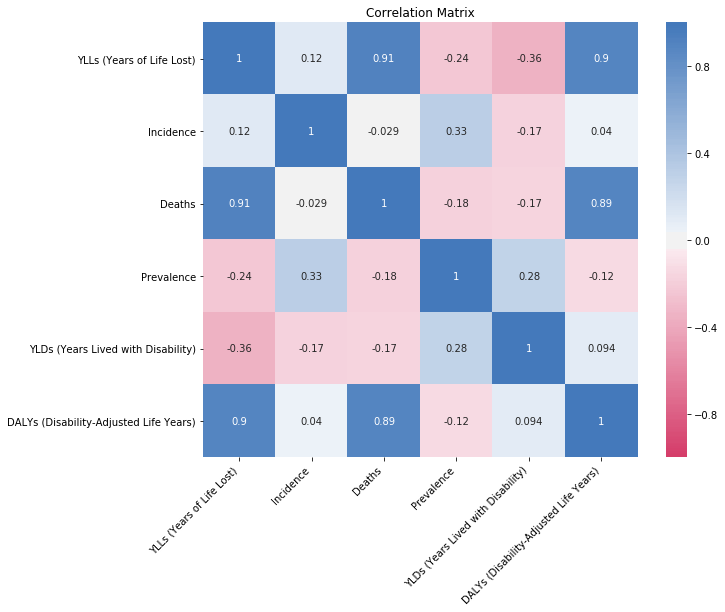

In [194]:
# Plot the correlation matrix
fig, ax = plt.subplots(figsize=(10,8))
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(0, 250, n=200),
    square=True,
    annot=True
)
bottom, top = ax.get_ylim()
ax.set_ylim(bottom + 0.5, top - 0.5)
ax.set_title('Correlation Matrix')
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);

* **Deaths** and **YLLs** are strongly positively correlated. This shows that even though YLLs take into account how old a person is at time of death, this only slightly changes the ranking.
* **DALYS** are strongly positively correlated with YLLs (and as such also with Deaths), and only weakly positively correlated with YLDs. This means that apparently, the YLLs have a much higher impact on this value than the YLDs.
* Both **Prevalence** and **YLDs** are negatively correlated with Deaths. This affirms our conclusion from earlier that these measures emphasize diseases from which people don't always die, but just live with for a long time.
* Similarly, **Incidence** and **YLDs** are negatively correlated: showing that YLDs emphasise diseases that not many people get each year, but with which they do live for a long time.
* Also **Prevalence** and **Deaths** are negatively correlated, showing that diseases with high prevalence are diseases with which people live for a long time, but which don't always cause death.

All of these measures clearly have their own merit and provide different insights. However, since we want to explore the impact diseases have on society, the DALYs measure is probably the most interesting. We will primarily use this measure for all future analyses.

According to the DALYs, the four diseases with the biggest impact are cardiovascular diseases, maternal and neonatal disorders, neoplasms (cancers) and respiratory infections and tuberculosis. To finish this part, let's look at which countries are most affected by these diseases.

In [203]:
data2

,measure,location,sex,age,cause,metric,year,val,upper,lower
0,YLLs (Years of Life Lost),Samoa,Both,All Ages,Neglected tropical diseases and malaria,Number,1993,14.171667,26.041295,9.123137
1,YLLs (Years of Life Lost),Samoa,Both,All Ages,Neglected tropical diseases and malaria,Percent,1993,0.000497,0.000895,0.000331
2,YLLs (Years of Life Lost),Samoa,Both,All Ages,Neglected tropical diseases and malaria,Rate,1993,8.516462,15.649513,5.482548
3,YLLs (Years of Life Lost),Samoa,Both,All Ages,Mental disorders,Number,1992,0.209891,0.539310,0.096168
4,YLLs (Years of Life Lost),Samoa,Both,All Ages,Mental disorders,Percent,1992,0.000007,0.000019,0.000003
...,...,...,...,...,...,...,...,...,...,...
129395,DALYs (Disability-Adjusted Life Years),Guam,Both,All Ages,Sense organ diseases,Percent,2017,0.027513,0.037053,0.020102
129396,DALYs (Disability-Adjusted Life Years),Guam,Both,All Ages,Sense organ diseases,Rate,2017,863.886411,1252.302081,576.163719
129397,DALYs (Disability-Adjusted Life Years),Guam,Both,All Ages,Substance use disorders,Number,2017,625.126969,775.343312,486.084116
129398,DALYs (Disability-Adjusted Life Years),Guam,Both,All Ages,Substance use disorders,Percent,2017,0.011901,0.013844,0.009949


In [204]:
# Create a map with dropdown to show the DALYs for different diseases

#Some constants for colors and theme
columns = sorted(data2.cause.unique())
COLOR_SCALE = colorscale=[[0.0, "rgb(49,54,149)"],
                [0.1111111111111111, "rgb(69,117,180)"],
                [0.2222222222222222, "rgb(116,173,209)"],
                [0.3333333333333333, "rgb(171,217,233)"],
                [0.4444444444444444, "rgb(224,243,248)"],
                [0.5555555555555556, "rgb(254,224,144)"],
                [0.6666666666666666, "rgb(253,174,97)"],
                [0.7777777777777778, "rgb(244,109,67)"],
                [0.8888888888888888, "rgb(215,48,39)"],
                [1.0, "rgb(165,0,38)"]]

MARKER_LINE_COLOR = "white"
THEME = "plotly_white"
MARKER_LINE_WIDTH = 0.5

data_dropdown = []

dalys_subset = data2[(data2['metric'] == 'Rate') & (data2['year'] == 2017)
                     & (data2['measure'] == 'DALYs (Disability-Adjusted Life Years)')][['location','val','year', 'cause']]

for col in columns:
    ### Get the subset of data
    data_for_cause = dalys_subset[(dalys_subset['cause'] == col)]
    map_data = countryInfo.merge(data_for_cause, left_on = 'name', right_on = 'location', how = 'left')
    map_data.dropna(subset=['year'], axis = 0, inplace= True)
    ### create the dictionary with the data for the current year
    data_one_dis = dict(
                        type='choropleth',
                        locations = map_data['alpha-3'],
                        z=map_data['val'],
                        name = col,
                        colorscale = COLOR_SCALE,
                        autocolorscale=True,
                        reversescale=False,
                        marker_line_color= MARKER_LINE_COLOR,
                        marker_line_width=MARKER_LINE_WIDTH,
                        text = map_data['location'],
                        visible=col == sorted(columns)[0], 
                        )

    data_dropdown.append(data_one_dis)  # I add the dictionary to the list of dictionaries for the slider
    
## I create the steps for the slider
buttons = []
for i, name in enumerate(columns):
    visible = [False]*len(columns)
    visible[i] = True
    buttons.append(
        dict(
            method='restyle',
            args=[{'visible': visible}],
            label=name
        ))


# I set up the layout (including slider option)
# I create the figure object:
fig = go.Figure(data=data_dropdown)

# I plot in the notebook
#plotly.offline.iplot(fig)
fig.update_layout(geo=dict(showframe=False,
        showcoastlines=False,
        projection_type='equirectangular'),
    template=THEME, 
    updatemenus=list([
        dict(
            x=0.1,
            y=1.1,
            pad={"r": 10, "t": 10},
            buttons=buttons,
            yanchor='top',
            xanchor="left",

        )
    ]),
    title_text = "DALYs lost per 100k people in 2017"
        )
fig.show()

In [205]:
pty.offline.plot(fig, filename='dalys_dropdown.html')

'dalys_dropdown.html'

In [201]:
test=dalys_subset[dalys_subset["cause"]=="HIV/AIDS and sexually transmitted infections"]
test=test[test["val"]>50000]
test

,location,val,year,cause
372944,Eswatini,50507.188865,2006,HIV/AIDS and sexually transmitted infections
490650,Eswatini,51041.656996,2005,HIV/AIDS and sexually transmitted infections


This plot is shown in the data story.

We can also plot the DALYS for the four top diseases with a slider to go through time.

In [54]:
# Plot cardiovascular diseases
dalys_subset1 = data2[(data2['cause'] == "Cardiovascular diseases") & (data2['metric'] == 'Rate') & (data2['measure'] == 'DALYs (Disability-Adjusted Life Years)')][['location','val','year']]
map_test3 = countryInfo.merge(dalys_subset1, left_on = 'name', right_on = 'location', how = 'left')
map_test3.dropna(subset=['year'], axis = 0, inplace= True)
slider_map(map_test3, z_col_name = "val", title = "DALYs lost per 100k people due to cardiovascular diseases", year_col = 'year', country_col_name='name', location_col_name ='alpha-3',zmin = 0, zmax = 20000)

In [139]:
# Plot neoplasms (cancers)
dalys_subset2 = data2[(data2['cause'] == "Neoplasms") & (data2['metric'] == 'Rate') & (data2['measure'] == 'DALYs (Disability-Adjusted Life Years)')][['location','val','year']]
map_test4 = countryInfo.merge(dalys_subset2, left_on = 'name', right_on = 'location', how = 'left')
map_test4.dropna(subset=['year'], axis = 0, inplace= True)
slider_map(map_test4, z_col_name = "val", title = "DALYs lost per 100k people due to neoplasms", year_col = 'year', country_col_name='name', location_col_name ='alpha-3',zmin = 0, zmax = 9000)

In [140]:
# Plot Maternal and neonatal disorders
dalys_subset3 = data2[(data2['cause'] == "Maternal and neonatal disorders") & (data2['metric'] == 'Rate') & (data2['measure'] == 'DALYs (Disability-Adjusted Life Years)')][['location','val','year']]
map_test5 = countryInfo.merge(dalys_subset3, left_on = 'name', right_on = 'location', how = 'left')
map_test5.dropna(subset=['year'], axis = 0, inplace= True)
slider_map(map_test5, z_col_name = "val", title = "DALYs lost per 100k people due to maternal and neonatal disorders", year_col = 'year', country_col_name='name', location_col_name ='alpha-3',zmin = 0, zmax = dalys_subset3.val.max())

In [141]:
# Plot respiratory infections and tuberculosis
dalys_subset4 = data2[(data2['cause'] == "Respiratory infections and tuberculosis") & (data2['metric'] == 'Rate') & (data2['measure'] == 'DALYs (Disability-Adjusted Life Years)')][['location','val','year']]
map_test6 = countryInfo.merge(dalys_subset4, left_on = 'name', right_on = 'location', how = 'left')
map_test6.dropna(subset=['year'], axis = 0, inplace= True)
slider_map(map_test6, z_col_name = "val", title = "DALYs lost per 100k people due to respiratory infections and tuberculosis", year_col = 'year', country_col_name='name', location_col_name ='alpha-3',zmin = 0, zmax = dalys_subset4.val.max())

Based on this very quick analysis, we can see that cardiovascular diseases and neoplasms cause the biggest impact in the developed world (with the former having an especially large impact on Eastern Europe), and maternal and neonatal diseases, together with respiratory infections and tuberculosis, have a bigger impact on the developing world. This geographical diversity makes analysing these four diseases more interesting.

In the next chapters, let us look at in which countries have a similar impact due to these diseases in the last 30 years, and at the different risk factors and economic factors that might lead to these diseases having a higher impact.

# 2. Is the prevalence of diseases in a country correlated with that of other countries? What can this tell us about the spread of diseases?

In [31]:
data2.head(30)

,measure,location,sex,age,cause,metric,year,val,upper,lower
0,YLLs (Years of Life Lost),Samoa,Both,All Ages,Neglected tropical diseases and malaria,Number,1993,1.417167e+01,26.041295,9.123137e+00
1,YLLs (Years of Life Lost),Samoa,Both,All Ages,Neglected tropical diseases and malaria,Percent,1993,4.974041e-04,0.000895,3.309780e-04
2,YLLs (Years of Life Lost),Samoa,Both,All Ages,Neglected tropical diseases and malaria,Rate,1993,8.516462e+00,15.649513,5.482548e+00
3,YLLs (Years of Life Lost),Samoa,Both,All Ages,Mental disorders,Number,1992,2.098912e-01,0.539310,9.616776e-02
4,YLLs (Years of Life Lost),Samoa,Both,All Ages,Mental disorders,Percent,1992,7.399359e-06,0.000019,3.401891e-06
5,YLLs (Years of Life Lost),Samoa,Both,All Ages,Mental disorders,Rate,1992,1.269623e-01,0.326226,5.817146e-02
6,YLLs (Years of Life Lost),Samoa,Both,All Ages,Musculoskeletal disorders,Number,1991,7.119414e+01,94.926946,5.300575e+01
7,YLLs (Years of Life Lost),Samoa,Both,All Ages,Musculoskeletal disorders,Percent,1991,2.448456e-03,0.003154,1.912545e-03
8,YLLs (Years of Life Lost),Samoa,Both,All Ages,Musculoskeletal disorders,Rate,1991,4.327142e+01,57.696095,3.221662e+01
9,YLLs (Years of Life Lost),Djibouti,Both,All Ages,Other infectious diseases,Number,1990,2.200374e+04,33674.267602,1.384016e+04


In [32]:
mergedData=countryInfo.merge(data2, left_on = 'name', right_on = 'location', how = 'left').drop("location", axis=1)
mergedData=mergedData.drop(["sex", "age"], axis=1) #only has values both and nan, and all ages and nan, dropped
mergedData

,name,alpha-2,alpha-3,country-code,iso_3166-2,region,sub-region,intermediate-region,region-code,sub-region-code,intermediate-region-code,measure,cause,metric,year,val,upper,lower
0,Afghanistan,AF,AFG,4,ISO 3166-2:AF,Asia,Southern Asia,NaN,142.0,34.0,NaN,YLLs (Years of Life Lost),Cardiovascular diseases,Number,1990.0,1.136721e+06,1.372865e+06,686326.354218
1,Afghanistan,AF,AFG,4,ISO 3166-2:AF,Asia,Southern Asia,NaN,142.0,34.0,NaN,YLLs (Years of Life Lost),Cardiovascular diseases,Percent,1990.0,1.025570e-01,1.228987e-01,0.063497
2,Afghanistan,AF,AFG,4,ISO 3166-2:AF,Asia,Southern Asia,NaN,142.0,34.0,NaN,YLLs (Years of Life Lost),Cardiovascular diseases,Rate,1990.0,1.135996e+04,1.371990e+04,6858.887251
3,Afghanistan,AF,AFG,4,ISO 3166-2:AF,Asia,Southern Asia,NaN,142.0,34.0,NaN,YLLs (Years of Life Lost),Chronic respiratory diseases,Number,1990.0,1.501491e+05,1.885786e+05,86531.287887
4,Afghanistan,AF,AFG,4,ISO 3166-2:AF,Asia,Southern Asia,NaN,142.0,34.0,NaN,YLLs (Years of Life Lost),Chronic respiratory diseases,Percent,1990.0,1.354638e-02,1.675152e-02,0.007868
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2118530,Zimbabwe,ZW,ZWE,716,ISO 3166-2:ZW,Africa,Sub-Saharan Africa,Eastern Africa,2.0,202.0,14.0,DALYs (Disability-Adjusted Life Years),Other non-communicable diseases,Percent,2017.0,3.413523e-02,3.833918e-02,0.029974
2118531,Zimbabwe,ZW,ZWE,716,ISO 3166-2:ZW,Africa,Sub-Saharan Africa,Eastern Africa,2.0,202.0,14.0,DALYs (Disability-Adjusted Life Years),Other non-communicable diseases,Rate,2017.0,1.620592e+03,1.913299e+03,1347.482459
2118532,Zimbabwe,ZW,ZWE,716,ISO 3166-2:ZW,Africa,Sub-Saharan Africa,Eastern Africa,2.0,202.0,14.0,DALYs (Disability-Adjusted Life Years),Skin and subcutaneous diseases,Number,2017.0,9.744526e+04,1.458894e+05,63104.791503
2118533,Zimbabwe,ZW,ZWE,716,ISO 3166-2:ZW,Africa,Sub-Saharan Africa,Eastern Africa,2.0,202.0,14.0,DALYs (Disability-Adjusted Life Years),Skin and subcutaneous diseases,Percent,2017.0,1.393542e-02,2.001048e-02,0.009462


Creates three dataframes, one for each measure: rateData, numberData, percentData.

In [33]:
#Rate
rateDf=mergedData[mergedData["metric"]=="Rate"]
columnsToKeep=['name','measure', 'year', 'alpha-2','alpha-3','country-code','iso_3166-2', 'region', 'sub-region',]
#Pivot with cause, to get columns of diseases. Index has columns to be kept as is.
pivoted=pd.pivot_table(rateDf, index=columnsToKeep, columns="cause", values="val")
#Reset index to restore columns as they were
rateData=pivoted.reset_index()
print(rateData.shape)

(32424, 31)


In [34]:
#Percent
perDf=mergedData[mergedData["metric"]=="Percent"]
columnsToKeep=['name','measure', 'year', 'alpha-2','alpha-3','country-code','iso_3166-2', 'region', 'sub-region',]
#Pivot with cause, to get columns of diseases. Index has columns to be kept as is
pivoted=pd.pivot_table(perDf, index=columnsToKeep, columns="cause", values="val")
#Reset index to restore columns as they were
percentData=pivoted.reset_index()
print(percentData.shape)

(32424, 31)


In [35]:
#Number
numDf=mergedData[mergedData["metric"]=="Number"]
columnsToKeep=['name','measure', 'year', 'alpha-2','alpha-3','country-code','iso_3166-2', 'region', 'sub-region',]
pivoted=pd.pivot_table(numDf, index=columnsToKeep, columns="cause", values="val")
numberData=pivoted.reset_index()
print(numberData.shape)

(32424, 31)


Create a function for grouping and plotting.

In [36]:
def plot_world_groups(data, disease, measure, distance, cut_off_Range, linkage_type, save=False):
    #Data=the df, either rate, num or percent
    #Disease=string, disease name
    #measure=string, measure name
    #distance=metric to use for grouping, either correaltion or euclidean have been tested, but any scikit learn one should work
    #cut_off_Range= range of slider, has to be adjusted manually. Look at the dendrogram graphs y-axis, go with that
    #linkage type, what linkage to use. Average or complete linkage type recommended, see documentation for hierarchial clustering
    #Save=save plot to HTML or not
    
    diseaseData=data[data["measure"]==measure] #take only the measure
    diseaseData=pd.pivot_table(diseaseData, index="year", columns="name", values=disease) #pivot on country names, get columns for each country
    #Correlation matrix
    #corr=diseaseData.corr(method ='pearson') 
    #fig, ax = plt.subplots(figsize=(10,10))
    #ax = sns.heatmap(
    #    corr, 
    #    vmin=-1, vmax=1, center=0,
    #    cmap=sns.diverging_palette(0, 250, n=200),
    #    square=True
    #)
    #ax.set_xticklabels(
    #    ax.get_xticklabels(),
    #    rotation=45,
    #    horizontalalignment='right'
    #);
    diseaseData2=diseaseData.transpose() #transpose, countries are now rows
    plt.figure(figsize=(10, 7))
    plt.title("Country Dendograms")
    link=shc.linkage(diseaseData2, metric=distance, method=linkage_type) #do linkage
    dend = shc.dendrogram(link)  #create dendrogram
    dataToPlot=diseaseData2.copy()
    countries=diseaseData2.index
    dataToPlot["location"]=countries
    dataToPlot=dataToPlot.reset_index()[["location"]].rename(columns={"location": "name"}) #rename for use with plotting function
    dataToPlot.index=dataToPlot.index.rename("Index")
    dataToPlot=pd.merge(dataToPlot, countryInfo[["name", "alpha-3", "region", "sub-region"]], on="name", how="inner") #merge with country info
    step_size=0.05
    heights=cut_off_Range
    for i in range(len(heights)): #for all heights in the list of heights
        height=heights[i]
        cutTree = shc.cut_tree(link, height=height)  #cut tree at height
        heightVector=[height]*len(cutTree)  #vector for saving cutoffs for groups
        if i==0:       
            groups=pd.DataFrame({"name": countries}) #create df, with countries
            groups["val"]=cutTree #save group of country
            groups["cut_off"]=heightVector #cut_offs that correspod to groupings
        else:
            groupsNew=pd.DataFrame({"name": countries})#create new df, with countries
            groupsNew["val"]=cutTree #save group of country
            groupsNew["cut_off"]=heightVector #cut_offs that correspod to groupings
            groups=pd.concat([groups, groupsNew]) #add to larger df
    toPlot=pd.merge(dataToPlot, groups, on="name", how="inner") #merge with data needed for plotting
    title="Grouping of countries by {} for {} of {}".format(distance, measure, disease) #title of plot
    
    fig=slider_map_cat(toPlot, z_col_name="val", title=title) #call plotting function defined below
    if save:
        filename="Grouping_of_countries_by_{}_for_{}_of_{}.html".format(distance, measure, disease)
        pty.offline.plot(fig, filename=filename)

In [37]:
COLOR_SCALE = "Reds"
MARKER_LINE_COLOR = "white"
THEME = "plotly_white"
MARKER_LINE_WIDTH = 0.5

def slider_map_cat(df, z_col_name, title, country_col_name = 'name', slider_col = 'cut_off' , 
                   location_col_name ="alpha-3"):
    """Plot dynamic maps with slider for years

    Parameters
    ----------
    df : The dataframe. The year must contain only numeric values.
    z_col_name : Name of the column containg the data.
    title : Title of the map
    country_col_name : Name of rhe colum with the contry names
    slider_col : Name of the colum containing the values to use for slider (here, group "fineness", cut off for hierarchial clustering)
    location_col_name : Name of the column containg the country codes

    """
    num_groups=len(list(np.unique(df[z_col_name]))) #total number of groups

    rgb_indices=np.arange(0,250,25) #create range of rgb values
    #create a meshgrid with all combinations of rgb vslues
    all_colors=list(np.array(np.meshgrid(rgb_indices, rgb_indices, rgb_indices)).T.reshape(-1,3)) #500 distinct combinations
    #take index
    indexes=range(len(all_colors))
    #take random indexes for colours from the meshgrid numpy array
    colorIndexes=list(np.random.choice(indexes, size=num_groups, replace=False))

    COLORSCALE=[] #create empty list of colors

    for i in range(num_groups):
        color=all_colors[colorIndexes[i]] #get the color at the random index earlier
        colorStr="rgb"+repr(list(color)).replace("[", "(") #save as rgb string that plotly likes
        colorStr=colorStr.replace("]", ")")
        entry=colorStr
        COLORSCALE.append(entry)
    
    zmax=np.max(df[z_col_name]) #take mac value
    
    data_slider = []
    cut_offs = sorted(df[slider_col].unique())
    for grouping in sorted(df[slider_col].unique()): #loop through all slider settings (cutting height)

        # I select the cut height 
        cut_off_df = df[(df[slider_col]== grouping )]
        
        ### create the dictionary with the data for the current cut
        data_one_grouping = dict(
                            type='choropleth',
                            locations = cut_off_df [location_col_name],
                            z=cut_off_df[z_col_name],
                            zmin=0,
                            zmax = zmax,
                            colorscale = COLORSCALE, #Custom colorscale
                            autocolorscale=False,
                            reversescale=False,
                            marker_line_color= MARKER_LINE_COLOR,
                            marker_line_width=MARKER_LINE_WIDTH,
                            text = cut_off_df [country_col_name],
                            )

        data_slider.append(data_one_grouping)  # I add the dictionary to the list of dictionaries for the slider
    ##  I create the steps for the slider

    steps = []

    for i in range(len(data_slider)):
        step = dict(method='restyle',
                    args=['visible', [False] * len(data_slider)],
                    label=np.round(cut_offs[i],2).astype('str')) # label to be displayed for each step (year)
        step['args'][1][i] = True
        steps.append(step)


    ##  I create the 'sliders' object from the 'steps'

    sliders = [dict(active=0, pad={"t": 1}, steps=steps)]

    # I set up the layout (including slider option)


    # I create the figure object:

    fig = go.Figure(data=data_slider)

    # to plot in the notebook

    #plotly.offline.iplot(fig)
    fig.update_layout(geo=dict(showframe=False,
            showcoastlines=False,
            projection_type='equirectangular'),
            title=title,
        sliders=sliders,
        template=THEME
    )
    fig.show()
    return fig

In [54]:
def plot_world_group_single(data, cutoff, disease, measure, distance, linkage_type, save=False):
    #Data=the df, either rate, num or percent
    #Disease=string, disease name
    #measure=string, measure name
    #distance=metric to use for grouping, either correaltion or euclidean have been tested, but any scikit learn one should work
    #cut_off_Range= range of slider, has to be adjusted manually. Look at the dendrogram graphs y-axis, go with that
    #linkage type, what linkage to use. Average or complete linkage type recommended, see documentation for hierarchial clustering
    #Save=save plot to HTML or not
    
    diseaseData=data[data["measure"]==measure] #take only the measure
    diseaseData=pd.pivot_table(diseaseData, index="year", columns="name", values=disease) #pivot on country names, get columns for each country
    #Correlation matrix
    #corr=diseaseData.corr(method ='pearson') 
    #fig, ax = plt.subplots(figsize=(10,10))
    #ax = sns.heatmap(
    #    corr, 
    #    vmin=-1, vmax=1, center=0,
    #    cmap=sns.diverging_palette(0, 250, n=200),
    #    square=True
    #)
    #ax.set_xticklabels(
    #    ax.get_xticklabels(),
    #    rotation=45,
    #    horizontalalignment='right'
    #);
    diseaseData2=diseaseData.transpose() #transpose, countries are now rows
    plt.figure(figsize=(10, 7))
    plt.title("Country Dendograms")
    link=shc.linkage(diseaseData2, metric=distance, method=linkage_type) #do linkage
    dend = shc.dendrogram(link)  #create dendrogram
    dataToPlot=diseaseData2.copy()
    countries=diseaseData2.index
    dataToPlot["location"]=countries
    dataToPlot=dataToPlot.reset_index()[["location"]].rename(columns={"location": "name"}) #rename for use with plotting function
    dataToPlot.index=dataToPlot.index.rename("Index")
    dataToPlot=pd.merge(dataToPlot, countryInfo[["name", "alpha-3", "region", "sub-region"]], on="name", how="inner") #merge with country info
    step_size=0.05
    heights=[cutoff]
    for i in range(len(heights)): #for all heights in the list of heights
        height=heights[i]
        cutTree = shc.cut_tree(link, height=height)  #cut tree at height
        heightVector=[height]*len(cutTree)  #vector for saving cutoffs for groups
        if i==0:       
            groups=pd.DataFrame({"name": countries}) #create df, with countries
            groups["val"]=cutTree #save group of country
            groups["cut_off"]=heightVector #cut_offs that correspod to groupings
        else:
            groupsNew=pd.DataFrame({"name": countries})#create new df, with countries
            groupsNew["val"]=cutTree #save group of country
            groupsNew["cut_off"]=heightVector #cut_offs that correspod to groupings
            groups=pd.concat([groups, groupsNew]) #add to larger df
    toPlot=pd.merge(dataToPlot, groups, on="name", how="inner") #merge with data needed for plotting
    title="Grouping of countries by {} for {} of {}".format(distance, measure, disease) #title of plot
    
    fig=single_map_cat(toPlot, cutoff, z_col_name="val", title=title) #call plotting function defined below
    if save:
        filename="Grouping_of_countries_by_{}_for_{}_of_{}.html".format(distance, measure, disease)
        pty.offline.plot(fig, filename=filename)
    return fig

In [71]:
COLOR_SCALE = "Reds"
MARKER_LINE_COLOR = "white"
THEME = "plotly_white"
MARKER_LINE_WIDTH = 0.5

def single_map_cat(df, single_cutoff, z_col_name, title, country_col_name = 'name', slider_col = 'cut_off' , 
                   location_col_name ="alpha-3"):
    """Plot dynamic maps with slider for years

    Parameters
    ----------
    df : The dataframe. The year must contain only numeric values.
    z_col_name : Name of the column containg the data.
    title : Title of the map
    country_col_name : Name of rhe colum with the contry names
    slider_col : Name of the colum containing the values to use for slider (here, group "fineness", cut off for hierarchial clustering)
    location_col_name : Name of the column containg the country codes

    """
    num_groups=len(list(np.unique(df[z_col_name]))) #total number of groups
    print(num_groups)
    rgb_indices=np.arange(0,250,25) #create range of rgb values
    #create a meshgrid with all combinations of rgb vslues
    all_colors=list(np.array(np.meshgrid(rgb_indices, rgb_indices, rgb_indices)).T.reshape(-1,3)) #500 distinct combinations
    #take index
    indexes=range(len(all_colors))
    #take random indexes for colours from the meshgrid numpy array
    colorIndexes=list(np.random.choice(indexes, size=num_groups, replace=False))
    
    COLORSCALE=[] #CUstom hand-picked colors for poster
    all_colors=[[116,173,209],[128, 94, 115],[66,133,140],[98,124,133],[78,77,92],[45,70,84], [79,0,11],[215,48,39]]
    
    print(num_groups)
    print(len(all_colors))
    
    for i in range(num_groups):
        color=all_colors[i] #get the color at the random index earlier
        colorStr="rgb"+repr(list(color)).replace("[", "(") #save as rgb string that plotly likes
        colorStr=colorStr.replace("]", ")")
        entry=colorStr
        print(entry)
        COLORSCALE.append(entry)
    
    zmax=np.max(df[z_col_name]) #take mac value
    
    cut_off = single_cutofCOLOR_SCALE = "Reds"
MARKER_LINE_COLOR = "white"
THEME = "plotly_white"
MARKER_LINE_WIDTH = 0.5

def single_map_cat(df, single_cutoff, z_col_name, title, country_col_name = 'name', slider_col = 'cut_off' , 
                   location_col_name ="alpha-3"):
    """Plot dynamic maps with slider for years

    Parameters
    ----------
    df : The dataframe. The year must contain only numeric values.
    z_col_name : Name of the column containg the data.
    title : Title of the map
    country_col_name : Name of rhe colum with the contry names
    slider_col : Name of the colum containing the values to use for slider (here, group "fineness", cut off for hierarchial clustering)
    location_col_name : Name of the column containg the country codes

    """
    num_groups=len(list(np.unique(df[z_col_name]))) #total number of groups
    print(num_groups)
    rgb_indices=np.arange(0,250,25) #create range of rgb values
    #create a meshgrid with all combinations of rgb vslues
    all_colors=list(np.array(np.meshgrid(rgb_indices, rgb_indices, rgb_indices)).T.reshape(-1,3)) #500 distinct combinations
    #take index
    indexes=range(len(all_colors))
    #take random indexes for colours from the meshgrid numpy array
    colorIndexes=list(np.random.choice(indexes, size=num_groups, replace=False))
    
    COLORSCALE=[] #CUstom hand-picked colors for poster
    all_colors=[[116,173,209],[128, 94, 115],[66,133,140],[98,124,133],[78,77,92],[45,70,84], [79,0,11],[215,48,39]]
    
    print(num_groups)
    print(len(all_colors))
    
    for i in range(num_groups):
        color=all_colors[i] #get the color at the random index earlier
        colorStr="rgb"+repr(list(color)).replace("[", "(") #save as rgb string that plotly likes
        colorStr=colorStr.replace("]", ")")
        entry=colorStr
        print(entry)
        COLORSCALE.append(entry)
    
    zmax=np.max(df[z_col_name]) #take mac value
    
    cut_off = single_cutoff
    # I select the cut height 
    cut_off_df = df[(df[slider_col]== cut_off)]
        
    ### create the dictionary with the data for the current cut
    data_one_grouping = dict(
                        type='choropleth',
                        locations = cut_off_df [location_col_name],
                        z=cut_off_df[z_col_name],
                        zmin=0,
                        zmax = zmax,
                        colorscale = COLORSCALE, #Custom colorscale
                        autocolorscale=False,
                        reversescale=False,
                        marker_line_color= MARKER_LINE_COLOR,
                        marker_line_width=MARKER_LINE_WIDTH,
                        text = cut_off_df [country_col_name],
                        )


    # I create the figure object:

    fig = go.Figure(data=data_one_grouping)

    # to plot in the notebook

    #plotly.offline.iplot(fig)
    fig.update_layout(geo=dict(showframe=False,
            showcoastlines=False,
            projection_type='equirectangular'),
            title=title,
        template=THEME
    )
    fig.show()
    return figf
    # I select the cut height 
    cut_off_df = df[(df[slider_col]== cut_off)]
        
    ### create the dictionary with the data for the current cut
    data_one_grouping = dict(
                        type='choropleth',
                        locations = cut_off_df [location_col_name],
                        z=cut_off_df[z_col_name],
                        zmin=0,
                        zmax = zmax,
                        colorscale = COLORSCALE, #Custom colorscale
                        autocolorscale=False,
                        reversescale=False,
                        marker_line_color= MARKER_LINE_COLOR,
                        marker_line_width=MARKER_LINE_WIDTH,
                        text = cut_off_df [country_col_name],
                        )


    # I create the figure object:

    fig = go.Figure(data=data_one_grouping)

    # to plot in the notebook

    #plotly.offline.iplot(fig)
    fig.update_layout(geo=dict(showframe=False,
            showcoastlines=False,
            projection_type='equirectangular'),
            title=title,
        template=THEME
    )
    fig.show()
    return fig

In [65]:
rateData.columns

Index(['name', 'measure', 'year', 'alpha-2', 'alpha-3', 'country-code',
       'iso_3166-2', 'region', 'sub-region', 'Cardiovascular diseases',
       'Chronic respiratory diseases', 'Diabetes and kidney diseases',
       'Digestive diseases', 'Enteric infections',
       'HIV/AIDS and sexually transmitted infections',
       'Maternal and neonatal disorders', 'Mental disorders',
       'Musculoskeletal disorders', 'Neglected tropical diseases and malaria',
       'Neoplasms', 'Neurological disorders', 'Nutritional deficiencies',
       'Other infectious diseases', 'Other non-communicable diseases',
       'Respiratory infections and tuberculosis',
       'Self-harm and interpersonal violence', 'Sense organ diseases',
       'Skin and subcutaneous diseases', 'Substance use disorders',
       'Transport injuries', 'Unintentional injuries'],
      dtype='object', name='cause')

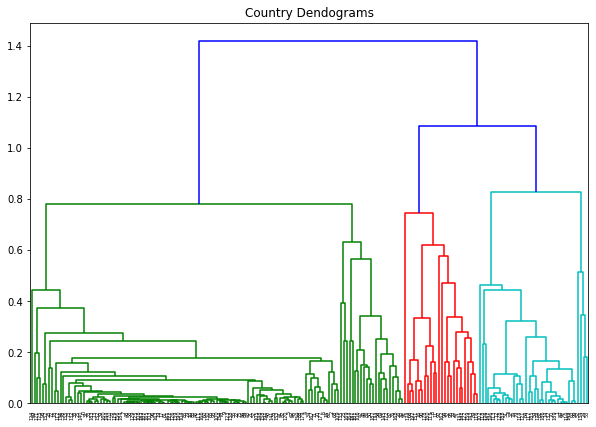

In [52]:
disease="Cardiovascular diseases"
measure="DALYs (Disability-Adjusted Life Years)"
plot_world_groups(rateData, disease, measure, cut_off_Range=np.arange(0, 2, 0.05), 
                  distance="correlation", linkage_type="average", save=True)

8
8
8
rgb(116, 173, 209)
rgb(128, 94, 115)
rgb(66, 133, 140)
rgb(98, 124, 133)
rgb(78, 77, 92)
rgb(45, 70, 84)
rgb(79, 0, 11)
rgb(215, 48, 39)


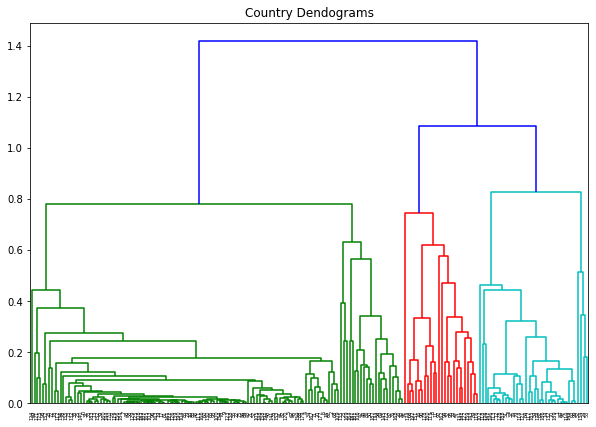

In [72]:
disease="Cardiovascular diseases"
measure="DALYs (Disability-Adjusted Life Years)"
fig=plot_world_group_single(rateData, 0.6, disease, measure,
                  distance="correlation", linkage_type="average")

7
7
8
rgb(116, 173, 209)
rgb(128, 94, 115)
rgb(66, 133, 140)
rgb(98, 124, 133)
rgb(78, 77, 92)
rgb(45, 70, 84)
rgb(79, 0, 11)


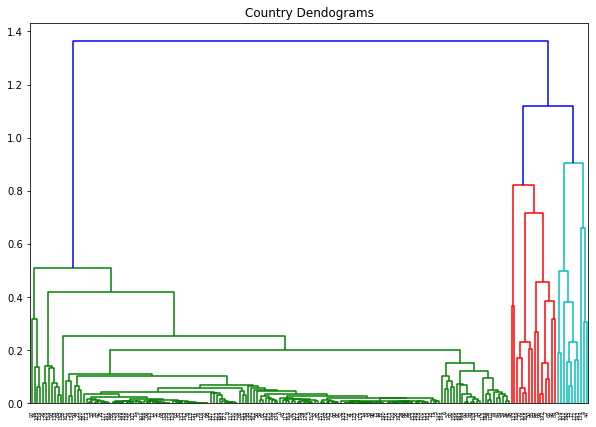

In [73]:
disease="Respiratory infections and tuberculosis"
measure="DALYs (Disability-Adjusted Life Years)"
fig=plot_world_group_single(rateData, 0.6, disease, measure,
                  distance="correlation", linkage_type="average")

COMMENT: This plot shows strong difference between the Western and Eastern world, especially in Europe the grouping goes almost by the old iron curtain. This supports the hypothesis that cardiovascular diseases may depend mainly on societal and economic factors.

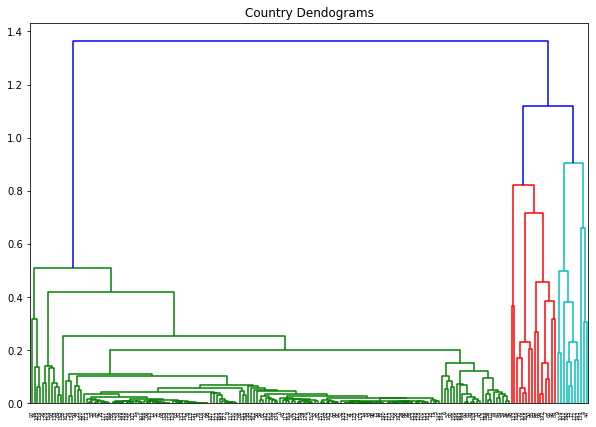

In [40]:
disease="Respiratory infections and tuberculosis"
measure="DALYs (Disability-Adjusted Life Years)"
plot_world_groups(rateData, disease, measure, cut_off_Range=np.arange(0, 2, 0.05), distance="correlation", 
                  linkage_type="average", save=True)

COMMENT: For respiraytory and tuberculosis, the correlation appears stronger, as larger groups form at lower grouping tresholds. The grouping also appears less dependant on societal and economic factors than for cardiovascular diseases, and perhaps more dependant on geography. This makes sense, as this is now an infectious disease we are looking at. 

An interesting correlation that shows up is the strong correlation between Germany and Argentina. This could just be a coincidence, but there are strong historical ties between the countries and a lot of German expats/people with German roots living in Argentina. https://en.wikipedia.org/wiki/German_Argentine People may transfer the diseases from country to country when visiting relatives. We are also looking at a long term measure such as DALY's. One hypthesis that could be made is that German Argentines with dual citizenship might seek treatment in Germany, a country ranked higher in healthcare comparisons. However, more research on if this kind of phenomenon exists would be needed, as this is pure speculation at this point. 

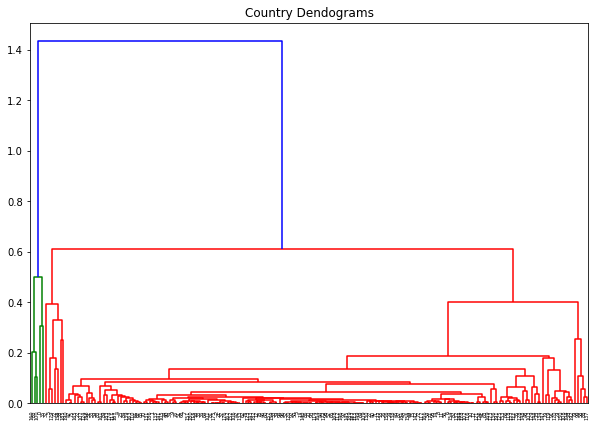

In [41]:
disease="Respiratory infections and tuberculosis"
measure="Incidence"
plot_world_groups(rateData, disease, measure, cut_off_Range=np.arange(0, 2, 0.05), 
                  distance="correlation", linkage_type="average", save=True)

For infectious diseases, incidence might be a better measure. Indeed, looking at Incidence as opposecd to DALYs shows some interesting things: the correlations are strong, indicating an infectious disease. At high groupimg,the entire world except for a select few countries are positively correlated, while these countries actually appear negatively correlated to teh bigger group. 
The interesting observation that can be made is that all these countries in their own separate groups are countries that have been subject to considerable instability, strife and even civil war in the time period lookid at. (Liberia, Chad, Afghanistan...)
This might indicate that the disease incidence in conflict prone countries is simialr between these countries and very different and not positively correlated with the rest of the world. In essence, these countries may be "isolated", and not part of the global network of disease transmission. 
However, due to strife and instability, the medical data from these countries might just be incomolete or faulty. 

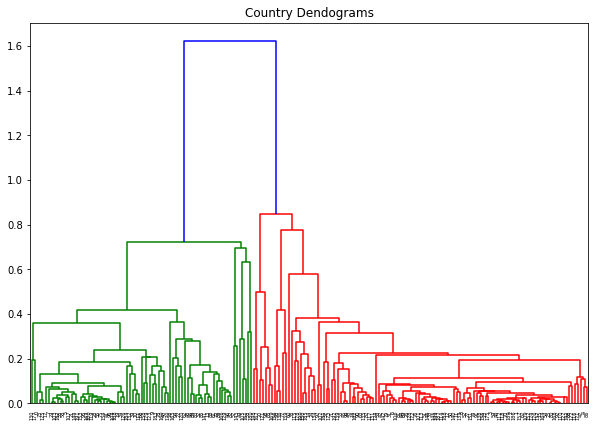

In [42]:
disease="Neoplasms"
measure="DALYs (Disability-Adjusted Life Years)"
plot_world_groups(rateData, disease, measure, cut_off_Range=np.arange(0, 2, 0.05), 
                  distance="correlation", linkage_type="average", save=True)

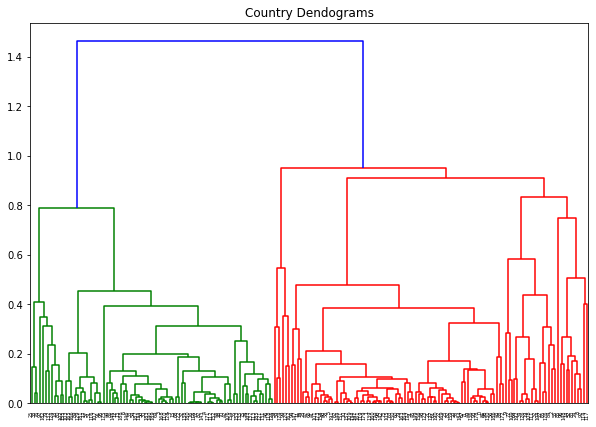

In [43]:
disease="Neglected tropical diseases and malaria"
measure="Incidence"
plot_world_groups(rateData, disease, measure, cut_off_Range=np.arange(0, 1, 0.02), 
                  distance="correlation", linkage_type="average", save=True)

In [44]:
disease="Cardiovascular diseases"
measure="DALYs (Disability-Adjusted Life Years)"
plot_world_groups(rateData, disease, measure, cut_off_Range=np.arange(1000, 50000, 5000), 
                  distance="euclidean", save=True)

TypeError: plot_world_groups() missing 1 required positional argument: 'linkage_type'

# 3. How is the prevalence of different diseases linked to different risk factors?

## 3.1 Cardiovascular diseases

To better understand the risks factors for cardiovascular diseases, we analyse this dataset: https://www.kaggle.com/sulianova/cardiovascular-disease-dataset, which contains data about the health condition of a list of people, including whether or not they have cardiovascular diseases.

### 3.1.1 Data cleaning/exploration

In [67]:
df=pd.read_csv( "./data/cardio_train.csv", delimiter=';')
print(df.shape)
df.head(5)

(70000, 13)


,id,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
0,0,18393,2,168,62.0,110,80,1,1,0,0,1,0
1,1,20228,1,156,85.0,140,90,3,1,0,0,1,1
2,2,18857,1,165,64.0,130,70,3,1,0,0,0,1
3,3,17623,2,169,82.0,150,100,1,1,0,0,1,1
4,4,17474,1,156,56.0,100,60,1,1,0,0,0,0


In [68]:
# No missing data (yey!)
df.isnull().values.any()

False

The feature "age" is given as a integer amount of days, let's convert this to a float in years.

In [69]:
# approximation: 1 year = 365 days
df['age'] = df['age'] / 365

**Let's check if each column has realistic values:**

In [70]:
# The range of ages seems reasonable
print(np.sort(df['age'].unique()))

[29.58356164 29.75068493 29.80273973 ... 64.90958904 64.93424658
 64.96712329]


In [71]:
# there seem to be some very short and tall people in this dataset !! (shortest person ever recorded was 54.6 cm)
print(np.sort(df['height'].unique()))

[ 55  57  59  60  64  65  66  67  68  70  71  72  74  75  76  80  81  91
  96  97  98  99 100 104 105 108 109 110 111 112 113 117 119 120 122 125
 128 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146
 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164
 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182
 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 200 207
 250]


[[<matplotlib.axes._subplots.AxesSubplot object at 0x1c25e03a50>]] 165    5853
160    5022
170    4679
168    4399
164    3396
       ... 
81        1
80        1
207       1
76        1
64        1
Name: height, Length: 109, dtype: int64


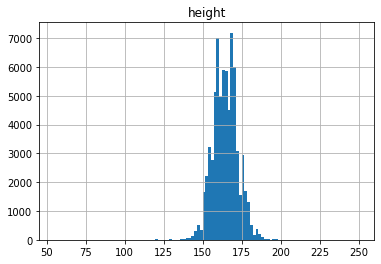

In [72]:
# There seem to be many different very short people in this dataset, let's visualize the distribution.
hist = df.hist(bins=len(df['height'].unique()), column="height")
print(hist, df['height'].value_counts())

In [73]:
# The distribution does seem to be sharply peaked around the realistic value. Let's remove the unrealistic outliers
realistic = df[df['height']>120]
realistic = realistic[realistic['height']<210]

In [74]:
# Let's split the dataset into male and female and determine the average height
print('genders: '+str(realistic['gender'].unique()))

females = realistic[realistic['gender'] == 1]
males = realistic[realistic['gender'] == 2]

print('Average height of a female: '+ str(np.round(females['height'].mean(),2))+' cm')
print('Average height of a male: '+ str(np.round(males['height'].mean(),2))+' cm')

genders: [2 1]
Average height of a female: 161.43 cm
Average height of a male: 170.04 cm


These values seem quiet low, however, we don't know when/where this data was recorded. <br>
We will get back to this and try to figure out where this data was recorded.

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1c27c78650>]],
      dtype=object)

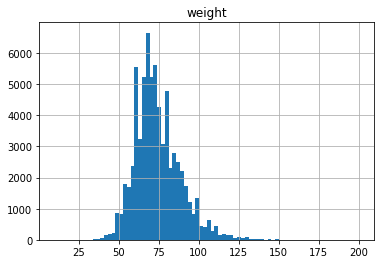

In [75]:
# There are also some unrealistic low weight values (expressed in kg)
hist = realistic.hist(bins=80, column="weight")
hist

In [76]:
print('low weights: '+str(np.sort(realistic['weight'].unique())[:10]))

low weights: [10. 11. 21. 22. 23. 28. 29. 30. 31. 32.]


In [77]:
#Remove extremely low weights
realistic = realistic[realistic['weight']>35]

In [78]:
# ap_hi: Systolic (arterial) blood pressure (pressure just outside the heart while it is ejecting)
# ap_hi: Diastolic (arterial) blood pressure (pressure just outside the heart while it is filling)
print(np.sort(realistic['ap_hi'].unique()))
print(np.sort(realistic['ap_lo'].unique()))

[ -150  -140  -120  -115  -100     1     7    10    11    12    13    14
    15    16    17    20    24    60    70    80    85    90    93    95
    96    97    99   100   101   102   103   104   105   106   107   108
   109   110   111   112   113   114   115   116   117   118   119   120
   121   122   123   124   125   126   127   128   129   130   131   132
   133   134   135   136   137   138   139   140   141   142   143   144
   145   146   147   148   149   150   151   152   153   154   155   156
   157   158   159   160   161   162   163   164   165   166   167   168
   169   170   171   172   173   174   175   176   177   178   179   180
   181   184   185   187   188   190   191   193   195   196   197   199
   200   202   207   210   215   220   230   240   309   401   701   806
   902   906   907   909   960  1110  1130  1202  1205  1300  1400  1409
  1420  1500  1620  2000 11020 11500 13010 14020 16020]
[  -70     0     1     6     7     8     9    10    15    20    30  

We can assume these negative pressures to be typos since their magnitude is realistic

In [79]:
#Fix the negative values
realistic = realistic.abs()

In [80]:
# In reality systolic blood pressure is rarely much lower lower than 90 or higher than 200
realistic = realistic[realistic['ap_hi']>59]
realistic = realistic[realistic['ap_hi']<241]
realistic = realistic[realistic['ap_lo']>39]
realistic = realistic[realistic['ap_lo']<200]
print(np.sort(realistic['ap_hi'].unique()))
print(np.sort(realistic['ap_lo'].unique()))

[ 60.  70.  80.  85.  90.  93.  95.  96.  97.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 116. 117.
 118. 119. 120. 121. 122. 123. 124. 125. 126. 127. 128. 129. 130. 131.
 132. 133. 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145.
 146. 147. 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159.
 160. 161. 162. 163. 164. 165. 166. 167. 168. 169. 170. 171. 172. 173.
 174. 175. 176. 177. 178. 179. 180. 184. 185. 187. 188. 190. 191. 193.
 195. 196. 197. 200. 202. 210. 215. 220. 230. 240.]
[ 40.  45.  49.  50.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.
  62.  63.  64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.
  76.  77.  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.
  90.  91.  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103.
 104. 105. 106. 107. 108. 109. 110. 111. 112. 113. 114. 115. 118. 119.
 120. 121. 122. 125. 126. 130. 135. 140. 150. 160. 170. 180. 182. 190.]


What is also an interesting and important parameter when trying to quantify the performance of the heart is "Pulse Pressure" (ap_pulse) which can simply be calculated as follows: ap_pulse = ap_hi - ap_lo.

In [81]:
# Let's add thise parameter into our dataframe
realistic['ap_pulse'] = realistic['ap_hi'] - realistic['ap_lo']
df1 = realistic.pop('cardio')
realistic['cardio'] = df1
realistic.head()

,id,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,ap_pulse,cardio
0,0.0,50.391781,2.0,168.0,62.0,110.0,80.0,1.0,1.0,0.0,0.0,1.0,30.0,0.0
1,1.0,55.419178,1.0,156.0,85.0,140.0,90.0,3.0,1.0,0.0,0.0,1.0,50.0,1.0
2,2.0,51.663014,1.0,165.0,64.0,130.0,70.0,3.0,1.0,0.0,0.0,0.0,60.0,1.0
3,3.0,48.282192,2.0,169.0,82.0,150.0,100.0,1.0,1.0,0.0,0.0,1.0,50.0,1.0
4,4.0,47.873973,1.0,156.0,56.0,100.0,60.0,1.0,1.0,0.0,0.0,0.0,40.0,0.0


In [82]:
# We find that in some cases the the diastolic pressure is higher than the systolic pressure, this is physiologically impossible.
print(np.sort(realistic['ap_pulse'].unique()))

[-90. -85. -75. -70. -65. -60. -50. -45. -40. -35. -30. -25. -20. -10.
  -5.   0.   5.   9.  10.  11.  12.  14.  15.  17.  18.  19.  20.  21.
  22.  23.  24.  25.  27.  28.  29.  30.  31.  32.  33.  34.  35.  36.
  37.  38.  39.  40.  41.  42.  43.  44.  45.  46.  47.  48.  49.  50.
  51.  52.  53.  54.  55.  56.  57.  58.  59.  60.  61.  62.  63.  64.
  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.  78.
  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.  92.
  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 105. 106. 107.
 108. 109. 110. 113. 114. 115. 120. 121. 130. 135. 140.]


In [83]:
# Remove negative values and unrealisticly high values.
realistic = realistic[realistic['ap_pulse']>0]
realistic = realistic[realistic['ap_pulse']<100]
print(np.sort(realistic['ap_pulse'].unique()))

[ 5.  9. 10. 11. 12. 14. 15. 17. 18. 19. 20. 21. 22. 23. 24. 25. 27. 28.
 29. 30. 31. 32. 33. 34. 35. 36. 37. 38. 39. 40. 41. 42. 43. 44. 45. 46.
 47. 48. 49. 50. 51. 52. 53. 54. 55. 56. 57. 58. 59. 60. 61. 62. 63. 64.
 65. 66. 67. 68. 69. 70. 71. 72. 73. 74. 75. 76. 77. 78. 79. 80. 81. 82.
 83. 84. 85. 86. 87. 88. 89. 90. 91. 92. 93. 94. 95. 96. 97. 98. 99.]


In [84]:
# The other features seem to be clean
print(np.sort(realistic['cholesterol'].unique()))
print(np.sort(realistic['gluc'].unique()))
print(np.sort(realistic['smoke'].unique()))
print(np.sort(realistic['alco'].unique()))
print(np.sort(realistic['active'].unique()))
print('Data lost in the cleaning process: '+str(100*(70000-realistic.shape[0])/70000)+' %')

[1. 2. 3.]
[1. 2. 3.]
[0. 1.]
[0. 1.]
[0. 1.]
Data lost in the cleaning process: 2.33 %


In [85]:
corr = realistic.corr()
corr

,id,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,ap_pulse,cardio
id,1.000000,0.003419,0.002929,-0.001941,-0.001349,0.000232,-0.000580,0.005951,0.002342,-0.003752,0.000476,0.003455,0.000825,0.003407
age,0.003419,1.000000,-0.022878,-0.086422,0.055281,0.211695,0.157467,0.154875,0.098469,-0.047867,-0.028890,-0.010564,0.176343,0.239499
gender,0.002929,-0.022878,1.000000,0.520609,0.157100,0.062023,0.066891,-0.036988,-0.021374,0.338540,0.170687,0.005902,0.034247,0.007130
height,-0.001941,-0.086422,0.520609,1.000000,0.309788,0.017280,0.035931,-0.055239,-0.020652,0.195528,0.097550,-0.009365,-0.004972,-0.012279
weight,-0.001349,0.055281,0.157100,0.309788,1.000000,0.271684,0.253412,0.140928,0.106853,0.066652,0.067242,-0.016948,0.183243,0.180175
ap_hi,0.000232,0.211695,0.062023,0.017280,0.271684,1.000000,0.747308,0.194852,0.093490,0.026950,0.034170,0.000955,0.830091,0.431694
ap_lo,-0.000580,0.157467,0.066891,0.035931,0.253412,0.747308,1.000000,0.161279,0.074729,0.024106,0.036091,0.000062,0.249801,0.342693
cholesterol,0.005951,0.154875,-0.036988,-0.055239,0.140928,0.194852,0.161279,1.000000,0.450145,0.010078,0.035092,0.008823,0.148598,0.221260
gluc,0.002342,0.098469,-0.021374,-0.020652,0.106853,0.093490,0.074729,0.450145,1.000000,-0.005824,0.010192,-0.007581,0.073525,0.089202
smoke,-0.003752,-0.047867,0.338540,0.195528,0.066652,0.026950,0.024106,0.010078,-0.005824,1.000000,0.338972,0.025158,0.019043,-0.016530


**Now let's see how the different features are correlated.**

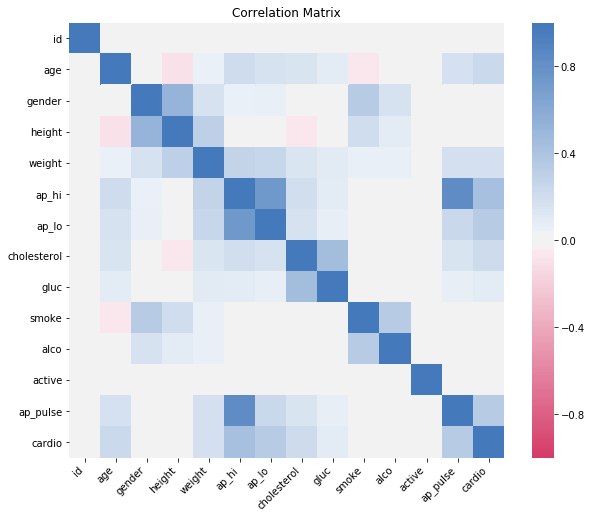

In [86]:
corr = realistic.corr()

fig, ax = plt.subplots(figsize=(10,8))
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(0, 250, n=200),
    square=True
)
bottom, top = ax.get_ylim()
ax.set_ylim(bottom + 0.5, top - 0.5)
ax.set_title('Correlation Matrix')
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);

In [87]:
corr

,id,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,ap_pulse,cardio
id,1.000000,0.003419,0.002929,-0.001941,-0.001349,0.000232,-0.000580,0.005951,0.002342,-0.003752,0.000476,0.003455,0.000825,0.003407
age,0.003419,1.000000,-0.022878,-0.086422,0.055281,0.211695,0.157467,0.154875,0.098469,-0.047867,-0.028890,-0.010564,0.176343,0.239499
gender,0.002929,-0.022878,1.000000,0.520609,0.157100,0.062023,0.066891,-0.036988,-0.021374,0.338540,0.170687,0.005902,0.034247,0.007130
height,-0.001941,-0.086422,0.520609,1.000000,0.309788,0.017280,0.035931,-0.055239,-0.020652,0.195528,0.097550,-0.009365,-0.004972,-0.012279
weight,-0.001349,0.055281,0.157100,0.309788,1.000000,0.271684,0.253412,0.140928,0.106853,0.066652,0.067242,-0.016948,0.183243,0.180175
ap_hi,0.000232,0.211695,0.062023,0.017280,0.271684,1.000000,0.747308,0.194852,0.093490,0.026950,0.034170,0.000955,0.830091,0.431694
ap_lo,-0.000580,0.157467,0.066891,0.035931,0.253412,0.747308,1.000000,0.161279,0.074729,0.024106,0.036091,0.000062,0.249801,0.342693
cholesterol,0.005951,0.154875,-0.036988,-0.055239,0.140928,0.194852,0.161279,1.000000,0.450145,0.010078,0.035092,0.008823,0.148598,0.221260
gluc,0.002342,0.098469,-0.021374,-0.020652,0.106853,0.093490,0.074729,0.450145,1.000000,-0.005824,0.010192,-0.007581,0.073525,0.089202
smoke,-0.003752,-0.047867,0.338540,0.195528,0.066652,0.026950,0.024106,0.010078,-0.005824,1.000000,0.338972,0.025158,0.019043,-0.016530


In [88]:
fig = go.Figure(data=go.Heatmap(
                   z=corr,
                   x=corr.index,
                   y=corr.columns,
                   hoverongaps = True, colorscale='Blues'))
fig.show()


**Implementing a measure of obesity: BMI**

Height & weight are also clearly strongly correlated, which makes a lot of sense. We would be more interested in the "obesity" of the patient, which is better quantified by the Body Mass Index: BMI = weight / height². Let us remove "height" and "weight" from out dataframe and instead combine them into BMI.

In [89]:
df = realistic

df['weight'] = df['weight'] / (df['height']/100)**2
df = df.rename(columns = {"weight": "BMI"})
df = df.drop(columns=['height'])
df.head()

,id,age,gender,BMI,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,ap_pulse,cardio
0,0.0,50.391781,2.0,21.967120,110.0,80.0,1.0,1.0,0.0,0.0,1.0,30.0,0.0
1,1.0,55.419178,1.0,34.927679,140.0,90.0,3.0,1.0,0.0,0.0,1.0,50.0,1.0
2,2.0,51.663014,1.0,23.507805,130.0,70.0,3.0,1.0,0.0,0.0,0.0,60.0,1.0
3,3.0,48.282192,2.0,28.710479,150.0,100.0,1.0,1.0,0.0,0.0,1.0,50.0,1.0
4,4.0,47.873973,1.0,23.011177,100.0,60.0,1.0,1.0,0.0,0.0,0.0,40.0,0.0


The very last column of the data "cardio" is a binary value which determines wether the concidered person was diagnosed with cardio vascular disease. <br> Note that in reality this is not at all "binary", as it doesn't quanity the severity/type of cardio vascular disease.<br>

Let's try to get a **deeper understanding of the different features in this dataset before attemption to draw conclusions.**

### 3.1.2 Age

Why is cardiovascular disease the most common cause of death? <br>
From a medical point of view, cardiovascular disease is fairly well understood, so why is it that as of today it can't simply be prevented?

It turns out that cardiovascular disease comes with a certain level of "inevetability", this is in part due to a phenonmenon known as "arterial stiffening" which is directly related to ageing.

Large arteries are roughly devided into 3 main sections:
<img src="section-artery.jpg" width="400" height="180">

It is the middle section that causes the main problem, it contains elastic fibres (a protein known as elastin) which gives the artery its elastic properties and helps the blood to be pumped around in your body. As it turns out, since this layer is sandwhiched between two other layers, our body has trouble repairing/replacing the elastin as it degrades over time. Additionally it has been shown that elastin proteins have an approximate half-life of 74 years (Shapiro et al., 1991). This value is relatively close to the current life expectancy in developed countries (~80y). <br> (Another direct reason for ageing is telomere shorting which causes DNA damage and cell death).

Observe that, the feature "age" is strongly correlation to the prevalence of cardio vascular disease which is very much expected concidering what was discussed above.

### 3.1.3 Cholesterol

Cholesterol plays a crucial role in the cell membrane of every cell in your body, it also helps your body synthesize steroid hormones, bile acid and vitamin D. So how is it possible that its prevalence is so strongly correlated to the most common cause of death?

Cholesterol is a lipid, it is a type of "fat". It can build up excessively in the blood circulation and can be hard for the body to remove. The cholesterol (plaque) attaches to the blood vessel walls caussing them to narrow. This negatively effects the heamodynamics and can ultimately result in total occlusion of a blood vessle. The blockage results in poor perfusion and thus insufficient oxygen being delivered to the tissue.<br>

<img src="plaque.png" width="300" height="130">

This process is accelerated by a unhealthy diet and is thus correlated to obesity.

### 3.1.4 Blood Pressure

elevated blood pressure is in general a result of many influencing factors.

* Short term: When you drink a large amount of fluid or eat something (salty), your blood pressure will rise. In young, healthy individuals the body is easily counteracts this by its many negative feedback loops.

* Long term: Blood pressure increases with age as a result of arterial stiffening, build up of cholesterol, ... <br>

Note that cardiovascular disease, especially coronary heart disease is a **positive feedbackloop**! This is exactly what makes it so deadly. <br>
explanation: If the heart lowers in function, it is unable to pump blood around the body properly and provide the different tissues of sufficient oxygen. This means all tissues in the body will lower in function, including the heart muscles themselves. This causes the heart function to decrease even further. This escalates in a condition known as heart failure.

### 3.1.5 Other interesting correlations

Interestingly, the strongest correlations in this dataset are not related to cardiovascular disease:

- height ~ gender
- height ~ weight
- cholesterol ~ glocuse levels (unhealthy diet)
- smoking ~ alcohol (unhealthy lifestyles)
- smoking ~ gender

**side quest:** Especially the last correlation is interesting. Which gender smokes most? How big is this difference?

In [90]:
GS = df[['gender','smoke']]

females = GS[GS['gender']==1]
males = GS[GS['gender']==2]

print('male smokers: '+str(np.round(100*sum(males['smoke'])/males.size, 3))+'%')
print('female smokers: '+str(np.round(100*sum(females['smoke'])/females.size, 3))+'%')

male smokers: 10.95%
female smokers: 0.89%


According to this dataset, men smoke 10x more than woman!<br>
This approximately agrees with findings in literature.

### 3.1.6 Feature importance

Correlations alone aren't always an accurate way of describing which features are truly important. Forest algorithm to determine which features are important:

In [91]:
X = df.iloc[:,1:-1]
y = df.iloc[:,-1]

In [92]:
forest = ExtraTreesClassifier(n_estimators=250,
                              random_state=0)

forest.fit(X, y)
importances = forest.feature_importances_ 
std = np.std([tree.feature_importances_ for tree in forest.estimators_],
             axis=0)
indices = np.argsort(importances)[::-1]

# Print the feature ranking
print("Feature ranking:")

for f in range(X.shape[1]):
    print("%d. feature %d (%f)" % (f + 1, indices[f], importances[indices[f]])+X.columns[indices[f]])



Feature ranking:
1. feature 0 (0.356879)age
2. feature 2 (0.313090)BMI
3. feature 3 (0.114377)ap_hi
4. feature 10 (0.071101)ap_pulse
5. feature 4 (0.061604)ap_lo
6. feature 5 (0.041434)cholesterol
7. feature 6 (0.013479)gluc
8. feature 1 (0.009778)gender
9. feature 9 (0.007135)active
10. feature 7 (0.005720)smoke
11. feature 8 (0.005403)alco


In [93]:
X.columns.to_list()

['age',
 'gender',
 'BMI',
 'ap_hi',
 'ap_lo',
 'cholesterol',
 'gluc',
 'smoke',
 'alco',
 'active',
 'ap_pulse']

In [94]:
to_plot = pd.DataFrame({ "Description" : X.columns.to_list() , "importances" : importances, "std" : std, })
to_plot

,Description,importances,std
0,age,0.356879,0.005682
1,gender,0.009778,0.003020
2,BMI,0.313090,0.005302
3,ap_hi,0.114377,0.046429
4,ap_lo,0.061604,0.025882
5,cholesterol,0.041434,0.007026
6,gluc,0.013479,0.003058
7,smoke,0.005720,0.002066
8,alco,0.005403,0.001591
9,active,0.007135,0.003274


In [95]:
to_plot.sort_values(by = "importances", ascending= False,  inplace = True)

In [96]:
fig = go.Figure()
fig.add_trace(go.Bar(
    name='Control',
    x=to_plot["Description"],
    y=to_plot["importances"],
    error_y=dict(type='data', array=to_plot["std"]),
))

fig.update_layout(barmode='group', xaxis=dict(type='category'), title_text = "Feature importance")
fig.show()

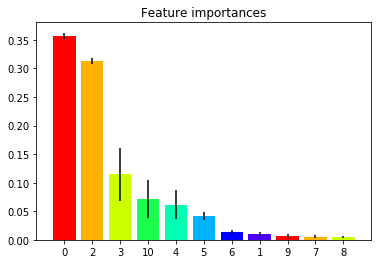

In [97]:
# Plot the feature importances of the forest
plt.figure()
plt.title("Feature importances")
plt.bar(range(X.shape[1]), importances[indices], color=[(1, 0, 0, 1),(1, 0.7, 0, 1),(0.8, 1, 0, 1),(0.1, 1, 0.3, 1),(0, 1, 0.7, 1),(0, 0.7, 1, 1),(0, 0, 1, 1),(0.3, 0, 1, 1)], yerr=std[indices], align="center")
plt.xticks(range(X.shape[1]), indices)
plt.xlim([-1, X.shape[1]])
plt.show()

PLOT ABOVE: to embed!

We find similar results as to the correlations, however, here the blood pressure seems to play much more important role. 
BMI also turns out to be a very important factor!

### 3.1.7 Conclusion

Many of the above factors can not directly be influenced/solved: 
* We can't prevent ourselves from ageing 
* High blood pressure is a result of other factors: ageing (arterial stiffening), cholesterol levels, salt/fluid intake, ...

So in order to **minimize our risk of cardiovascular disease** we should try to keep our BMI and cholesterol levels as low as possible. <br>
This can both be done be following a **healthy diet and working out (burning fat).**

## 3.2 Risk factors in GBD dataset

Let's start by loading the risk factors that the GBD contains (and immediately renaming the countries to what can be plotted by Plotly).

In [83]:
df_risk_exposure = pd.read_csv("data/risk-exposure.csv")
df_risk_exposure = replace_names(df_risk_exposure, pairDf["Country"], pairDf["Replacement"])
df_risk_exposure

Replaced Bolivia with Bolivia (Plurinational State of)
Replaced Brunei with Brunei Darussalam
Replaced Cape Verde with Cabo Verde
Replaced Cote d'Ivoire with Côte d'Ivoire
Replaced Czech Republic with Czechia
Replaced Democratic Republic of the Congo with Congo, Democratic Republic of the
Replaced Federated States of Micronesia with Micronesia (Federated States of)
Replaced Iran with Iran (Islamic Republic of)
Replaced Laos with Lao People's Democratic Republic
Replaced Macedonia with North Macedonia
Replaced Moldova with Moldova, Republic of
Replaced North Korea with Korea (Democratic People's Republic of)
Replaced Palestine with Palestine, State of
Replaced South Korea with Korea, Republic of
Replaced Syria with Syrian Arab Republic
Replaced Taiwan (Province of China) with Taiwan, Province of China
Replaced Tanzania with Tanzania, United Republic of
Replaced The Bahamas with Bahamas
Replaced The Gambia with Gambia
Replaced United Kingdom with United Kingdom of Great Britain and North

,measure,location,sex,age,rei,metric,year,val,upper,lower
0,Summary exposure value,Chile,Both,All Ages,Impaired kidney function,Rate,1998,2.206156,6.254720,0.991032
1,Summary exposure value,Chile,Both,All Ages,High LDL cholesterol,Rate,1998,11.781258,13.439133,10.229339
2,Summary exposure value,Uruguay,Both,All Ages,Alcohol use,Rate,1998,17.024161,23.759901,11.266339
3,Summary exposure value,Uruguay,Both,All Ages,Drug use,Rate,1998,0.522109,0.767074,0.386055
4,Summary exposure value,Uruguay,Both,All Ages,High fasting plasma glucose,Rate,1998,4.868456,7.082223,3.521469
...,...,...,...,...,...,...,...,...,...,...
54595,Summary exposure value,Iceland,Both,All Ages,Drug use,Rate,2010,0.357157,0.453165,0.292774
54596,Summary exposure value,Iceland,Both,All Ages,High fasting plasma glucose,Rate,2010,4.233970,6.021667,3.041318
54597,Summary exposure value,Iceland,Both,All Ages,High systolic blood pressure,Rate,2010,8.919840,9.762758,8.028875
54598,Summary exposure value,Iceland,Both,All Ages,High body-mass index,Rate,2010,16.592588,21.117256,12.963985


Which risk factors are in the GBD dataset?

In [84]:
print(df_risk_exposure['rei'].unique())

['Impaired kidney function' 'High LDL cholesterol' 'Alcohol use'
 'Drug use' 'High fasting plasma glucose' 'High systolic blood pressure'
 'High body-mass index' 'Low bone mineral density' 'Low physical activity'
 'Intimate partner violence']


In [85]:
df_risk_exposure['year'].sort_values().unique()

array([1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000,
       2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011,
       2012, 2013, 2014, 2015, 2016, 2017], dtype=int64)

Let's look at alcohol use.

In [60]:
df_risk_exposure[df_risk_exposure.rei =='Alcohol use'].describe()

,year,val,upper,lower
count,5460.000000,5460.000000,5460.000000,5460.000000
mean,2003.500000,10.966699,15.693126,7.145287
std,8.078487,8.273282,11.035870,5.889908
min,1990.000000,0.002859,0.011256,0.000000
25%,1996.750000,3.971469,6.650172,2.206567
50%,2003.500000,9.461800,13.736232,6.045667
75%,2010.250000,15.672330,22.813185,10.511115
max,2017.000000,36.397854,45.997251,27.804720


All the risk factor values in the GBD dataset are a value between 0 and 100: this represent the Summary Exposure Value (SEV), a metric that indicates the exposure of a society to the risk factor, weighted with the impact of this risk factor.

In [86]:
alcohol_sev = df_risk_exposure[df_risk_exposure.rei =='Alcohol use'][['location','val','year']]
alcohol_sev

,location,val,year
2,Uruguay,17.024161,1998
17,Viet Nam,9.576890,2001
27,Hungary,25.161845,2016
34,China,12.525064,2016
52,Hungary,28.035177,2000
...,...,...,...
54554,Lithuania,28.470610,2010
54558,Australia,23.428078,2010
54572,Cyprus,18.547235,2010
54582,Malta,14.011680,2010


Because we're not sure how useful this value is, we also download a dataset containing the raw alcohol usage from Our World in Data, to compare.

In [87]:
pure_alcohol_use = pd.read_csv("data/total-alcohol-consumption-per-capita-litres-of-pure-alcohol.csv")
pure_alcohol_use = pure_alcohol_use.rename(columns={"Alcohol consumption (litres per capita) (liters of pure alcohol, projected estimates, 15+ years of age)":"alcohol"})
pure_alcohol_use

,Entity,Code,Year,alcohol
0,Afghanistan,AFG,2016,0.200000
1,Albania,ALB,2016,7.500000
2,Algeria,DZA,2016,0.900000
3,Andorra,AND,2016,11.300000
4,Angola,AGO,2016,6.400000
...,...,...,...,...
228,Vietnam,VNM,2016,8.300000
229,World,OWID_WRL,2016,6.376976
230,Yemen,YEM,2016,0.100000
231,Zambia,ZMB,2016,4.800000


In [89]:
# Plot alcohol SEV in map
map_test2 = countryInfo.merge(alcohol_sev, left_on = 'name', right_on = 'location', how = 'left')
map_test2.dropna(subset=['year'], axis = 0, inplace= True)
fig = slider_map(map_test2, z_col_name = "val", title = "Alcohol use SEV (%)", year_col = 'year', country_col_name='name', location_col_name ='alpha-3',zmin = 0, zmax = 40)

In [90]:
# Plot alcohol usage on map
map_test2 = countryInfo.merge(pure_alcohol_use, left_on = 'alpha-3', right_on = 'Code', how = 'right')
map_test2.dropna(subset=['Year'], axis = 0, inplace= True)
fig = slider_map(map_test2, z_col_name = "alcohol", title = "Alcohol in liters of pure alcohol per capita in 2016", year_col = 'Year', country_col_name='name', location_col_name ='Code',zmin = 0, zmax = 16)

Let's now take the DALYs lost in 2016 for all the diseases per country.

In [91]:
dalys = data2[(data2.measure=="DALYs (Disability-Adjusted Life Years)") & (data2.metric == 'Rate')][['location', 'cause', 'val','year']]
dalys_pivoted = dalys[dalys.year==2016].pivot(index='location',columns='cause',values='val')
dalys_pivoted

cause,Cardiovascular diseases,Chronic respiratory diseases,Diabetes and kidney diseases,Digestive diseases,Enteric infections,HIV/AIDS and sexually transmitted infections,Maternal and neonatal disorders,Mental disorders,Musculoskeletal disorders,Neglected tropical diseases and malaria,...,Nutritional deficiencies,Other infectious diseases,Other non-communicable diseases,Respiratory infections and tuberculosis,Self-harm and interpersonal violence,Sense organ diseases,Skin and subcutaneous diseases,Substance use disorders,Transport injuries,Unintentional injuries
location,,,,,,,,,,,,,,,,,,,,,
Afghanistan,5025.632132,1102.362447,1481.509306,1079.231465,2215.240981,232.745090,8485.203408,1607.203270,1104.084389,783.914311,...,996.106811,4322.149504,4844.759136,5929.894722,7735.128856,450.106827,543.053663,879.531687,1736.543451,2510.069625
Albania,7424.861614,893.658513,917.026828,825.021518,79.112846,23.118151,1006.566031,1385.681442,2313.360948,5.422660,...,271.222003,130.340488,1351.886387,518.466588,470.300881,993.660147,445.193929,347.476124,704.791916,1925.407671
Algeria,3958.841968,811.663126,1189.917307,644.530635,214.817905,75.338135,2038.902399,1742.256836,1925.942880,29.205841,...,279.136131,184.806544,2151.835437,563.460601,354.688803,735.092533,491.179388,877.805083,1107.828293,1016.069726
American Samoa,4917.446909,1513.488939,4186.281825,792.762456,351.377615,114.057927,1102.287754,1276.629713,1639.029046,83.351607,...,479.448476,340.568580,1456.732342,941.710251,688.275405,696.777790,914.353198,299.869757,566.128480,1379.257190
Andorra,3300.226754,1144.314087,838.220706,913.127165,43.104816,45.601542,325.961597,2028.061926,3286.718792,0.519635,...,82.228581,57.306758,918.218231,503.530687,502.614240,715.031233,765.632810,496.471091,419.116358,1237.546110
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Viet Nam,4329.326868,1092.351718,1556.327093,980.572284,243.168000,683.497521,797.413763,1267.167792,1764.775266,342.562080,...,232.093426,269.994916,1314.741846,1164.016576,455.074367,898.186515,608.295855,461.564871,1291.166498,1297.273126
Virgin Islands (U.S.),8530.262554,1068.913154,3498.815950,1458.176425,206.406545,480.468941,829.731675,1733.013022,1995.046760,48.937051,...,249.630269,137.440016,1410.337111,680.163279,1617.091712,1003.599883,764.395352,885.877874,653.316889,1044.346092
Yemen,4563.361992,793.691020,723.202957,825.663267,2469.427611,113.221459,6228.080936,1636.442165,1313.665467,356.193274,...,2880.644765,883.595644,3019.542734,1717.582632,4036.374071,602.290454,517.673185,582.246323,2015.822545,1398.672023


In [92]:
# Same for deaths
deaths = data2[(data2.measure=="Deaths") & (data2.metric == 'Rate')][['location', 'cause', 'val','year']]
deaths_pivoted = deaths[deaths.year==2016].pivot(index='location',columns='cause',values='val')
deaths_pivoted

cause,Cardiovascular diseases,Chronic respiratory diseases,Diabetes and kidney diseases,Digestive diseases,Enteric infections,HIV/AIDS and sexually transmitted infections,Maternal and neonatal disorders,Mental disorders,Musculoskeletal disorders,Neglected tropical diseases and malaria,...,Neurological disorders,Nutritional deficiencies,Other infectious diseases,Other non-communicable diseases,Respiratory infections and tuberculosis,Self-harm and interpersonal violence,Skin and subcutaneous diseases,Substance use disorders,Transport injuries,Unintentional injuries
location,,,,,,,,,,,,,,,,,,,,,
Afghanistan,172.970652,21.390565,30.702652,15.929988,22.923284,2.749041,97.835073,0.000097,0.529725,4.074861,...,13.562478,4.515146,53.480977,50.078034,78.700440,105.959814,0.130483,1.414472,27.736562,32.497723
Albania,426.284517,25.762127,17.623272,17.314751,0.357141,0.093335,7.001074,0.001373,0.954491,0.133369,...,59.491790,0.161527,2.468351,9.929638,14.217203,8.394309,0.222256,1.365572,10.153309,10.656798
Algeria,194.020446,13.487239,23.989934,11.731400,1.326952,1.021863,19.409936,0.000856,0.421382,0.157973,...,23.891888,0.254701,2.899979,18.649260,12.996568,5.682239,0.344699,2.771765,18.391833,12.291664
American Samoa,176.019209,29.642431,99.828302,21.055456,2.661551,1.380236,10.593984,0.006423,1.361961,1.095598,...,19.689751,2.810767,4.656865,21.941763,25.076457,11.418365,12.498100,1.359246,8.607329,23.746490
Andorra,212.293948,40.405426,13.691658,33.843369,1.382574,0.718782,0.627279,0.019256,3.044739,0.005985,...,84.369857,0.252898,1.329669,9.560863,38.835412,10.926184,1.885117,4.972435,5.018653,16.764501
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Viet Nam,205.710010,36.846636,41.492648,30.416901,3.754012,12.090162,6.762635,0.000226,0.736433,1.770378,...,35.573090,0.987068,4.412348,12.234200,37.623429,9.347321,1.498540,2.328488,24.514538,32.525087
Virgin Islands (U.S.),435.166104,29.251553,110.849827,50.740266,1.184507,9.564026,6.325538,0.000173,3.004444,0.560843,...,63.611604,2.846194,3.607389,23.520053,31.087177,38.407452,8.075021,15.924116,16.359931,25.251207
Yemen,172.527161,16.039842,13.293518,11.400729,26.113481,1.484701,68.881512,0.000107,0.296087,0.434659,...,11.517963,2.582491,10.489476,25.910429,25.033983,62.220353,0.143450,1.362143,32.643666,17.627720


In [67]:
#dalys_alcohol.stack('cause')

In [93]:
# Make Series for alcohol SEV in 2017 per country
alcohol_sev_2017 = alcohol_sev[alcohol_sev.year==2017].set_index('location')['val']
alcohol_sev_2017

location
Mozambique                            5.616832
Moldova, Republic of                 23.688915
Brunei Darussalam                     2.866413
Zambia                                6.081239
Viet Nam                             20.313263
                                       ...    
Congo, Democratic Republic of the     5.370367
Niger                                 1.208289
American Samoa                        4.355845
Northern Mariana Islands              3.729200
South Sudan                           1.256469
Name: val, Length: 195, dtype: float64

In [94]:
# Idem for raw alcohol use
alcohol_use = countryInfo.merge(pure_alcohol_use, left_on = 'alpha-3', right_on = 'Code', how = 'inner').set_index('name')[['alcohol']]
alcohol_use

,alcohol
name,
Afghanistan,0.2
Albania,7.5
Algeria,0.9
Andorra,11.3
Angola,6.4
...,...
Venezuela (Bolivarian Republic of),5.6
Viet Nam,8.3
Yemen,0.1


Let's now look at the correlation between the alcohol use and the DALYs lost and deaths for every disease.

In [95]:
dalys_pivoted.corrwith(alcohol_use.alcohol,drop=True).sort_values(ascending=False)

cause
Neoplasms                                       0.686332
Neurological disorders                          0.656407
Musculoskeletal disorders                       0.543777
Sense organ diseases                            0.492039
Mental disorders                                0.334475
Cardiovascular diseases                         0.312107
Unintentional injuries                          0.285912
Digestive diseases                              0.285410
Skin and subcutaneous diseases                  0.250303
Substance use disorders                         0.161329
Chronic respiratory diseases                    0.032490
HIV/AIDS and sexually transmitted infections   -0.034104
Diabetes and kidney diseases                   -0.079024
Neglected tropical diseases and malaria        -0.116652
Self-harm and interpersonal violence           -0.138615
Respiratory infections and tuberculosis        -0.282292
Enteric infections                             -0.296531
Other non-communicable di

In [96]:
deaths_pivoted.corrwith(alcohol_use.alcohol,drop=True).sort_values(ascending=False)

cause
Neoplasms                                       0.705669
Neurological disorders                          0.658164
Digestive diseases                              0.529382
Cardiovascular diseases                         0.497415
Substance use disorders                         0.459363
Musculoskeletal disorders                       0.456066
Mental disorders                                0.332189
Unintentional injuries                          0.284911
Chronic respiratory diseases                    0.193369
Skin and subcutaneous diseases                  0.164849
Self-harm and interpersonal violence            0.012761
Diabetes and kidney diseases                   -0.016572
HIV/AIDS and sexually transmitted infections   -0.017963
Neglected tropical diseases and malaria        -0.108912
Respiratory infections and tuberculosis        -0.167868
Other non-communicable diseases                -0.241343
Nutritional deficiencies                       -0.254494
Enteric infections       

In [97]:
dalys_pivoted.corrwith(alcohol_sev_2017).sort_values(ascending=False)

cause
Neurological disorders                          0.761535
Neoplasms                                       0.742459
Musculoskeletal disorders                       0.653712
Sense organ diseases                            0.543452
Mental disorders                                0.439486
Cardiovascular diseases                         0.426255
Unintentional injuries                          0.303203
Substance use disorders                         0.299683
Digestive diseases                              0.282822
Skin and subcutaneous diseases                  0.175006
Chronic respiratory diseases                    0.077333
Diabetes and kidney diseases                   -0.070180
HIV/AIDS and sexually transmitted infections   -0.116505
Self-harm and interpersonal violence           -0.122666
Neglected tropical diseases and malaria        -0.267267
Transport injuries                             -0.325674
Enteric infections                             -0.392816
Respiratory infections an

We see that all three of those correlation series give rougly the same information, so we can conclude that the SEV is representative, and that the DALYs are still okay to work with.

Let's now try to get the correlation of all of the risk factors in the GBD dataset with all of the diseases (in DALYs).

In [115]:
risk_sevs = df_risk_exposure[df_risk_exposure.year==2016][['location','rei','val']].set_index(['location','rei'])
risk_sevs = risk_sevs.pivot_table(index=["location"], columns="rei", values="val")
risk_sevs

rei,Alcohol use,Drug use,High LDL cholesterol,High body-mass index,High fasting plasma glucose,High systolic blood pressure,Impaired kidney function,Intimate partner violence,Low bone mineral density,Low physical activity
location,,,,,,,,,,
Afghanistan,0.893146,1.670521,4.696030,6.351663,2.615683,2.928447,1.306120,7.953252,2.729642,0.272916
Albania,14.106834,0.294449,15.683307,12.264009,2.086068,15.044329,2.890635,0.981124,6.564530,0.394444
Algeria,1.913061,1.483901,9.544227,17.329226,3.268509,4.813837,2.442188,3.883643,5.283271,0.527219
American Samoa,4.302466,0.376206,10.118966,22.953304,5.941348,8.608402,3.465321,2.595815,4.440398,0.495211
Andorra,24.097361,0.420567,22.491254,14.941274,3.981073,12.136745,2.756562,1.059498,8.098514,0.688219
...,...,...,...,...,...,...,...,...,...,...
Viet Nam,20.246383,0.497931,10.312695,4.481161,2.844491,7.367669,3.420952,2.501583,7.272623,0.254671
Virgin Islands (U.S.),7.444977,0.386835,16.887295,25.262211,4.748534,10.518578,3.943038,0.996776,7.571082,0.625528
Yemen,0.355810,1.020339,6.435986,7.152749,1.405143,3.222406,1.429509,5.528132,3.064066,0.339373


In [114]:
dalys_pivoted

cause,Cardiovascular diseases,Chronic respiratory diseases,Diabetes and kidney diseases,Digestive diseases,Enteric infections,HIV/AIDS and sexually transmitted infections,Maternal and neonatal disorders,Mental disorders,Musculoskeletal disorders,Neglected tropical diseases and malaria,...,Nutritional deficiencies,Other infectious diseases,Other non-communicable diseases,Respiratory infections and tuberculosis,Self-harm and interpersonal violence,Sense organ diseases,Skin and subcutaneous diseases,Substance use disorders,Transport injuries,Unintentional injuries
location,,,,,,,,,,,,,,,,,,,,,
Afghanistan,5025.632132,1102.362447,1481.509306,1079.231465,2215.240981,232.745090,8485.203408,1607.203270,1104.084389,783.914311,...,996.106811,4322.149504,4844.759136,5929.894722,7735.128856,450.106827,543.053663,879.531687,1736.543451,2510.069625
Albania,7424.861614,893.658513,917.026828,825.021518,79.112846,23.118151,1006.566031,1385.681442,2313.360948,5.422660,...,271.222003,130.340488,1351.886387,518.466588,470.300881,993.660147,445.193929,347.476124,704.791916,1925.407671
Algeria,3958.841968,811.663126,1189.917307,644.530635,214.817905,75.338135,2038.902399,1742.256836,1925.942880,29.205841,...,279.136131,184.806544,2151.835437,563.460601,354.688803,735.092533,491.179388,877.805083,1107.828293,1016.069726
American Samoa,4917.446909,1513.488939,4186.281825,792.762456,351.377615,114.057927,1102.287754,1276.629713,1639.029046,83.351607,...,479.448476,340.568580,1456.732342,941.710251,688.275405,696.777790,914.353198,299.869757,566.128480,1379.257190
Andorra,3300.226754,1144.314087,838.220706,913.127165,43.104816,45.601542,325.961597,2028.061926,3286.718792,0.519635,...,82.228581,57.306758,918.218231,503.530687,502.614240,715.031233,765.632810,496.471091,419.116358,1237.546110
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Viet Nam,4329.326868,1092.351718,1556.327093,980.572284,243.168000,683.497521,797.413763,1267.167792,1764.775266,342.562080,...,232.093426,269.994916,1314.741846,1164.016576,455.074367,898.186515,608.295855,461.564871,1291.166498,1297.273126
Virgin Islands (U.S.),8530.262554,1068.913154,3498.815950,1458.176425,206.406545,480.468941,829.731675,1733.013022,1995.046760,48.937051,...,249.630269,137.440016,1410.337111,680.163279,1617.091712,1003.599883,764.395352,885.877874,653.316889,1044.346092
Yemen,4563.361992,793.691020,723.202957,825.663267,2469.427611,113.221459,6228.080936,1636.442165,1313.665467,356.193274,...,2880.644765,883.595644,3019.542734,1717.582632,4036.374071,602.290454,517.673185,582.246323,2015.822545,1398.672023


In [128]:
correlations = pd.DataFrame()
for risk in risk_sevs.columns:
    correlations[risk] = dalys_pivoted.corrwith(risk_sevs[risk]).sort_values(ascending=False)
    
correlations

,Alcohol use,Drug use,High LDL cholesterol,High body-mass index,High fasting plasma glucose,High systolic blood pressure,Impaired kidney function,Intimate partner violence,Low bone mineral density,Low physical activity
cause,,,,,,,,,,
Neurological disorders,0.760713,-0.008843,0.819291,0.279405,0.467319,0.800667,0.571034,-0.626259,0.786720,0.659868
Neoplasms,0.740522,-0.155427,0.791715,0.238729,0.535430,0.818620,0.715909,-0.634944,0.789619,0.530009
Musculoskeletal disorders,0.652653,0.191385,0.909650,0.349844,0.548341,0.731896,0.618147,-0.698984,0.823584,0.781677
Sense organ diseases,0.539543,-0.180735,0.626556,0.146435,0.349585,0.724296,0.777819,-0.515597,0.726034,0.349300
Mental disorders,0.439802,0.466563,0.641651,0.432282,0.311834,0.391142,0.291382,-0.448422,0.537987,0.774860
Cardiovascular diseases,0.424776,-0.125851,0.407360,0.117703,0.389163,0.622749,0.654971,-0.287314,0.361602,0.201852
Unintentional injuries,0.304022,-0.229595,0.054995,-0.262195,-0.007322,0.304201,0.170546,0.024549,0.009112,-0.131729
Substance use disorders,0.300264,0.662521,0.358773,0.392270,0.110520,0.340992,0.357146,-0.258502,0.190116,0.403758
Digestive diseases,0.282211,-0.333253,-0.036412,-0.193529,-0.046270,0.258380,0.220843,0.031390,0.005419,-0.264064


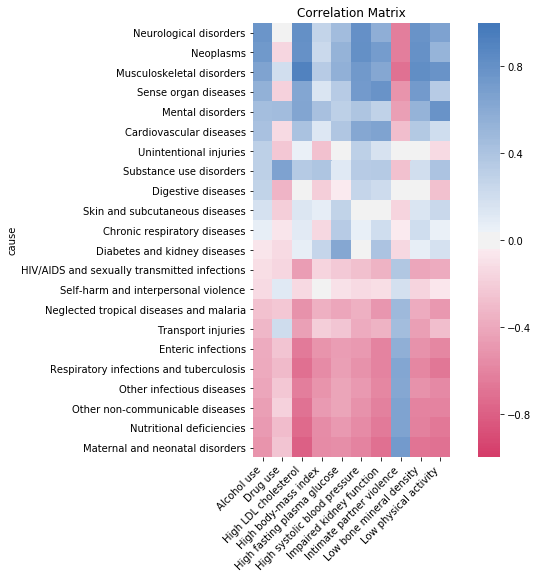

In [135]:
fig, ax = plt.subplots(figsize=(10,8))
ax = sns.heatmap(
    correlations, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(0, 250, n=200),
    square=True
)
bottom, top = ax.get_ylim()
ax.set_ylim(bottom + 0.5, top - 0.5)
ax.set_title('Correlation Matrix')
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);

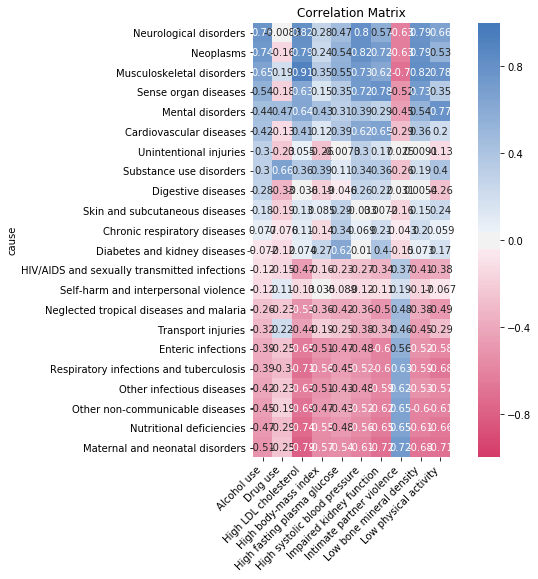

In [134]:
# With annotations
fig, ax = plt.subplots(figsize=(10,8))
ax = sns.heatmap(
    correlations, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(0, 250, n=200),
    square=True,
    annot=True
)
bottom, top = ax.get_ylim()
ax.set_ylim(bottom + 0.5, top - 0.5)
ax.set_title('Correlation Matrix')
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);

We also downloaded some extra risk factor data from the World Bank dataset: https://databank.worldbank.org/reports.aspx?source=world-development-indicators.

In [65]:
health_risk_factors = pd.read_csv("data/health_risk_factors.csv")
health_risk_factors

,Series Name,Series Code,Country Name,Country Code,1990 [YR1990],1991 [YR1991],1992 [YR1992],1993 [YR1993],1994 [YR1994],1995 [YR1995],...,2008 [YR2008],2009 [YR2009],2010 [YR2010],2011 [YR2011],2012 [YR2012],2013 [YR2013],2014 [YR2014],2015 [YR2015],2016 [YR2016],2017 [YR2017]
0,Prevalence of overweight (% of adults),SH.STA.OWAD.ZS,Afghanistan,AFG,10.4,10.7,11,11.4,11.7,12.1,...,18.2,18.8,19.3,19.9,20.5,21.1,21.7,22.3,23,..
1,Prevalence of overweight (% of adults),SH.STA.OWAD.ZS,Albania,ALB,40.5,41,41.5,42,42.5,43.1,...,51.8,52.5,53.3,54,54.8,55.5,56.3,57,57.7,..
2,Prevalence of overweight (% of adults),SH.STA.OWAD.ZS,Algeria,DZA,41.4,42.2,43,43.8,44.6,45.4,...,55.8,56.6,57.4,58.2,59,59.8,60.5,61.3,62,..
3,Prevalence of overweight (% of adults),SH.STA.OWAD.ZS,American Samoa,ASM,..,..,..,..,..,..,...,..,..,..,..,..,..,..,..,..,..
4,Prevalence of overweight (% of adults),SH.STA.OWAD.ZS,Andorra,AND,56.4,56.8,57.2,57.5,57.9,58.3,...,62,62.2,62.5,62.7,62.9,63.1,63.3,63.5,63.7,..
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1813,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1814,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1815,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1816,Data from database: Health Nutrition and Popul...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [35]:
environmental_risk_factors = pd.read_csv("data/environmental_risk_factors.csv")
environmental_risk_factors

,Country Name,Country Code,Series Name,Series Code,1990 [YR1990],1991 [YR1991],1992 [YR1992],1993 [YR1993],1994 [YR1994],1995 [YR1995],...,2008 [YR2008],2009 [YR2009],2010 [YR2010],2011 [YR2011],2012 [YR2012],2013 [YR2013],2014 [YR2014],2015 [YR2015],2016 [YR2016],2017 [YR2017]
0,Afghanistan,AFG,"PM2.5 air pollution, mean annual exposure (mic...",EN.ATM.PM25.MC.M3,65.4867916524168,..,..,..,..,65.1795127055462,...,..,..,65.2455916800454,66.8357271071327,66.02317421224,61.3667445152584,59.0103302514867,61.2526557952932,56.2870467224308,56.9108083545081
1,Afghanistan,AFG,Total alcohol consumption per capita (liters o...,SH.ALC.PCAP.LI,..,..,..,..,..,..,...,..,..,0.2,..,..,..,..,..,0.2,..
2,Afghanistan,AFG,People with basic handwashing facilities inclu...,SH.STA.HYGN.ZS,..,..,..,..,..,..,...,37.29531,37.42216,37.55213,37.6852,37.82138,37.96068,37.5168703434373,37.5915295300905,37.6665345570879,37.7460320188898
3,Afghanistan,AFG,People using safely managed drinking water ser...,SH.H2O.SMDW.ZS,..,..,..,..,..,..,...,..,..,..,..,..,..,..,..,..,..
4,Afghanistan,AFG,People using at least basic drinking water ser...,SH.H2O.BASW.ZS,..,..,..,..,..,..,...,43.315058867851,45.8190881970419,48.3563600604649,50.9273073282852,53.5317041603749,56.1696450791411,58.8412323271526,61.5469297111081,64.2864836343148,67.0646234205214
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1579,Zimbabwe,ZWE,Total alcohol consumption per capita (liters o...,SH.ALC.PCAP.LI,..,..,..,..,..,..,...,..,..,3.5,..,..,..,..,..,4.8,..
1580,Zimbabwe,ZWE,People with basic handwashing facilities inclu...,SH.STA.HYGN.ZS,..,..,..,..,..,..,...,30.99124,30.95116,30.91107,30.8712,30.83134,30.79169,36.8375654376538,36.81692755689,36.801494568623,36.7912611732953
1581,Zimbabwe,ZWE,People using safely managed drinking water ser...,SH.H2O.SMDW.ZS,..,..,..,..,..,..,...,..,..,..,..,..,..,..,..,..,..
1582,Zimbabwe,ZWE,People using at least basic drinking water ser...,SH.H2O.BASW.ZS,..,..,..,..,..,..,...,68.5370924405912,68.0252180622659,67.5128082116709,67.0002860584168,66.4872626897506,65.9741714274826,65.4733813413558,64.9858310220914,64.5116160376193,64.0512297035443


In [36]:
print(df_risk_exposure.rei.unique())
print(environmental_risk_factors['Series Name'].unique())
print(health_risk_factors['Series Name'].unique())

['Impaired kidney function' 'High LDL cholesterol' 'Alcohol use'
 'Drug use' 'High fasting plasma glucose' 'High systolic blood pressure'
 'High body-mass index' 'Low bone mineral density' 'Low physical activity'
 'Intimate partner violence']
['PM2.5 air pollution, mean annual exposure (micrograms per cubic meter)'
 'Total alcohol consumption per capita (liters of pure alcohol, projected estimates, 15+ years of age)'
 'People with basic handwashing facilities including soap and water (% of population)'
 'People using safely managed drinking water services (% of population)'
 'People using at least basic drinking water services (% of population)'
 'Smoking prevalence, total (ages 15+)']
['Prevalence of overweight (% of adults)'
 'Prevalence of overweight (% of children under 5)'
 'Malnutrition prevalence, weight for age (% of children under 5)'
 'Malnutrition prevalence, height for age (% of children under 5)'
 'Number of people who are undernourished'
 'Prevalence of undernourishment (

In [37]:
df = pd.read_csv("data/environmental_risk_factors.csv")
years = {}
index = ['1990 [YR1990]', '1991 [YR1991]', '1992 [YR1992]', '1993 [YR1993]',
       '1994 [YR1994]', '1995 [YR1995]', '1996 [YR1996]', '1997 [YR1997]',
       '1998 [YR1998]', '1999 [YR1999]', '2000 [YR2000]', '2001 [YR2001]',
       '2002 [YR2002]', '2003 [YR2003]', '2004 [YR2004]', '2005 [YR2005]',
       '2006 [YR2006]', '2007 [YR2007]', '2008 [YR2008]', '2009 [YR2009]',
       '2010 [YR2010]', '2011 [YR2011]', '2012 [YR2012]', '2013 [YR2013]',
       '2014 [YR2014]', '2015 [YR2015]', '2016 [YR2016]', '2017 [YR2017]',]
year = 1990
for x in index:
    years[x] = year
    year +=1

df.rename(years, axis = 1, inplace= True)

df_exploded  = df.melt(id_vars=df.columns.to_list()[0: 4],
        var_name="Year",
        value_name="Value").drop(["Series Code"], 1)

df_exploded["Value"] = df_exploded["Value"].replace("..",0).astype(float)
df_exploded["Year"] = df_exploded["Year"].astype(int)

df_final = pd.pivot_table(df_exploded, index=["Country Name", "Country Code", "Year"], columns="Series Name", values="Value")
df_final = df_final.replace(0,np.nan)

In [38]:
df_final

Series Name                     PM2.5 air pollution, mean annual exposure (micrograms per cubic meter)  \
Country Name Country Code Year                                                                           
Afghanistan  AFG          1990                                          65.486792                        
                          1991                                                NaN                        
                          1992                                                NaN                        
                          1993                                                NaN                        
                          1994                                                NaN                        
...                                                                           ...                        
Zimbabwe     ZWE          2013                                          23.111088                        
                          2014                                          22.805950                        
                          2015                                          21.733709                        
                          2016                                          21.726947                        
                          2017                                          22.251671                        

Series Name                     People using at least basic drinking water services (% of population)  \
Country Name Country Code Year                                                                          
Afghanistan  AFG          1990                                                NaN                       
                          1991                                                NaN                       
                          1992                                                NaN                       
                          1993                                                NaN                       
                          1994                                                NaN                       
...                                                                           ...                       
Zimbabwe     ZWE          2013                                          65.974171                       
                          2014                                          65.473381                       
                          2015                                          64.985831                       
                          2016                                          64.511616                       
                          2017                                          64.051230                       

Series Name                     People using safely managed drinking water services (% of population)  \
Country Name Country Code Year                                                                          
Afghanistan  AFG          1990                                                NaN                       
                          1991                                                NaN                       
                          1992                                                NaN                       
                          1993                                                NaN                       
                          1994                                                NaN                       
...                                                                           ...                       
Zimbabwe     ZWE          2013                                                NaN                       
                          2014                                                NaN                       
                          2015                                                NaN                       
                          2016                                                NaN                   

In [58]:
df_final.reset_index()

Series Name,Country Name,Country Code,Year,"PM2.5 air pollution, mean annual exposure (micrograms per cubic meter)",People using at least basic drinking water services (% of population),People using safely managed drinking water services (% of population),People with basic handwashing facilities including soap and water (% of population),"Smoking prevalence, total (ages 15+)","Total alcohol consumption per capita (liters of pure alcohol, projected estimates, 15+ years of age)"
0,Afghanistan,AFG,1990,65.486792,NaN,NaN,NaN,NaN,NaN
1,Afghanistan,AFG,1991,NaN,NaN,NaN,NaN,NaN,NaN
2,Afghanistan,AFG,1992,NaN,NaN,NaN,NaN,NaN,NaN
3,Afghanistan,AFG,1993,NaN,NaN,NaN,NaN,NaN,NaN
4,Afghanistan,AFG,1994,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
7387,Zimbabwe,ZWE,2013,23.111088,65.974171,NaN,30.791690,16.1,NaN
7388,Zimbabwe,ZWE,2014,22.805950,65.473381,NaN,36.837565,16.0,NaN
7389,Zimbabwe,ZWE,2015,21.733709,64.985831,NaN,36.816928,15.9,NaN
7390,Zimbabwe,ZWE,2016,21.726947,64.511616,NaN,36.801495,15.8,4.8


In [59]:
df_merged = df_final.merge(cardiovascular_diseases, left_on="Country Code", right_on="alpha-3")
df_merged.set_index(['alpha-3','year'])

PM2.5 air pollution, mean annual exposure (micrograms per cubic meter)  \
alpha-3 year                                                                             
AFG     1991.0                                          65.486792                        
        1998.0                                          65.486792                        
        1994.0                                          65.486792                        
        2002.0                                          65.486792                        
        2006.0                                          65.486792                        
...                                                           ...                        
ZWE     2001.0                                          22.251671                        
        2005.0                                          22.251671                        
        2009.0                                          22.251671                        
        2013.0                                          22.251671                        
        2017.0                                          22.251671                        

                People using at least basic drinking water services (% of population)  \
alpha-3 year                                                                            
AFG     1991.0                                                NaN                       
        1998.0                                                NaN                       
        1994.0                                                NaN                       
        2002.0                                                NaN                       
        2006.0                                                NaN                       
...                                                           ...                       
ZWE     2001.0                                           64.05123                       
        2005.0                                           64.05123                       
        2009.0                                           64.05123                       
        2013.0                                           64.05123                       
        2017.0                                           64.05123                       

                People using safely managed drinking water services (% of population)  \
alpha-3 year                                                                            
AFG     1991.0                                                NaN                       
        1998.0                                                NaN                       
        1994.0                                                NaN                       
        2002.0                                                NaN                       
        2006.0                                                NaN                       
...                                                           ...                       
ZWE     2001.0                                                NaN                       
        2005.0                                                NaN                       
        2009.0                                                NaN                       
        2013.0                                                NaN                       
        2017.0                                                NaN                       

                People with basic handwashing facilities including soap and water (% of population)  \
alpha-3 year                                                                                          
AFG     1991.0                                                NaN                                     
        1998.0                                                NaN                                     
        1994.0                                                NaN                                     
        2002.0

## 3.3 ML for feature importance

Just like in part 3.1, here we train a random forest ML model to assess the importance of different risk factors to predict the DALYs lost for different diseases.

However, no interesting results were gained by this, so this was not included in the data story. With more development, this could certainly still be an interesting opportunity.

In [127]:
def trainMod(params, d_train, itera, d_test):
    clf = lgb.train(params=params, train_set=d_train, num_boost_round=itera, 
                    valid_sets=[d_train, d_test], early_stopping_rounds=300, verbose_eval=True)
    return clf
def testPred(clf, val_X, val_y):
    y_pred=clf.predict(val_X)
    print("Mean squared error is:", np.mean(np.power(val_y-y_pred, 2)))
    return y_pred
def pred(clf, test_X):
    IDs=test_X["id"]
    test_X=test_X.drop(columns="id")
    pred=clf.predict(test_X)
    return (IDs, pred)

In [128]:
merged.columns

Index(['name', 'measure', 'year', 'alpha-2', 'country-code', 'iso_3166-2',
       'region', 'sub-region', 'Cardiovascular diseases',
       'Chronic respiratory diseases', 'Diabetes and kidney diseases',
       'Digestive diseases', 'Enteric infections',
       'HIV/AIDS and sexually transmitted infections',
       'Maternal and neonatal disorders', 'Mental disorders',
       'Musculoskeletal disorders', 'Neglected tropical diseases and malaria',
       'Neoplasms', 'Neurological disorders', 'Nutritional deficiencies',
       'Other infectious diseases', 'Other non-communicable diseases',
       'Respiratory infections and tuberculosis',
       'Self-harm and interpersonal violence', 'Sense organ diseases',
       'Skin and subcutaneous diseases', 'Substance use disorders',
       'Transport injuries', 'Unintentional injuries', 'Country Code', 'Year',
       'GDP', 'Life_expectancy', 'Mortality', 'Health expand'],
      dtype='object')

In [129]:
train_col = ['Cardiovascular diseases',
       'Chronic respiratory diseases', 'Diabetes and kidney diseases',
       'Digestive diseases', 'Enteric infections',
       'HIV/AIDS and sexually transmitted infections',
       'Maternal and neonatal disorders', 'Mental disorders',
       'Musculoskeletal disorders', 'Neglected tropical diseases and malaria',
       'Neoplasms', 'Neurological disorders', 'Nutritional deficiencies',
       'Other infectious diseases', 'Other non-communicable diseases',
       'Respiratory infections and tuberculosis',
       'Self-harm and interpersonal violence', 'Sense organ diseases',
       'Skin and subcutaneous diseases', 'Substance use disorders',
       'Transport injuries', 'Unintentional injuries', ]
y_col = "Life_expectancy"

In [130]:
data=df_merged
data=data[~data["val"].isna()] #remove nan y
y=data["val"] #feature to predict
y.describe()

count    151312.000000
mean       4981.862086
std        2858.193867
min        1156.624154
25%        3067.373853
50%        4167.374762
75%        5901.353298
max       19599.742283
Name: val, dtype: float64

In [131]:
X = merged[train_col]
X=X.fillna(-1)
X

,Cardiovascular diseases,Chronic respiratory diseases,Diabetes and kidney diseases,Digestive diseases,Enteric infections,HIV/AIDS and sexually transmitted infections,Maternal and neonatal disorders,Mental disorders,Musculoskeletal disorders,Neglected tropical diseases and malaria,...,Nutritional deficiencies,Other infectious diseases,Other non-communicable diseases,Respiratory infections and tuberculosis,Self-harm and interpersonal violence,Sense organ diseases,Skin and subcutaneous diseases,Substance use disorders,Transport injuries,Unintentional injuries
168,0.144739,0.028149,0.020284,0.031940,0.009644,0.001296,0.094113,0.042018,0.052420,0.001797,...,0.024105,0.045878,0.059152,0.148865,0.018411,0.020830,0.015737,0.009377,0.030339,0.077250
169,0.389480,0.049533,0.020528,0.029072,0.004584,0.000509,0.052457,0.000001,0.000437,0.001702,...,0.002069,0.032014,0.028260,0.121535,0.016946,-1.000000,0.000451,0.000703,0.025738,0.034633
170,0.001656,0.001554,0.000703,0.013631,0.111003,0.022530,0.002962,0.006029,0.010713,0.000033,...,0.057220,0.018657,0.128718,0.464194,0.001394,0.000000,0.095850,0.002000,0.002222,0.029902
171,0.062752,0.063366,0.073704,0.226495,0.008191,0.110096,0.019185,0.106857,0.136255,0.000000,...,0.375678,0.013245,0.739033,0.224785,0.021699,0.196329,0.213478,0.021349,0.027722,0.288731
172,0.045190,0.036858,0.026621,0.041141,0.009230,0.001772,0.041096,0.123749,0.153509,0.000061,...,0.061960,0.005007,0.068778,0.011689,0.007066,0.061167,0.044852,0.026022,0.017019,0.118725
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32251,0.144307,0.029001,0.038169,0.028791,0.040542,0.139501,0.081524,0.000002,0.000561,0.007263,...,0.026844,0.023616,0.022676,0.207614,0.032621,-1.000000,0.001277,0.002830,0.027084,0.031749
32252,0.000634,0.001270,0.000938,0.008622,0.239428,0.020732,0.004743,0.006109,0.004784,0.008988,...,0.040222,0.016506,0.101305,0.411896,0.000694,0.000000,0.103280,0.001301,0.001156,0.006622
32253,0.035864,0.056056,0.105716,0.264277,0.022024,0.277659,0.022954,0.108238,0.093423,0.190201,...,0.321811,0.018091,0.616322,0.294430,0.047476,0.205312,0.299550,0.020565,0.017939,0.064665
32254,0.020713,0.061937,0.056875,0.022481,0.024934,0.080385,0.036765,0.125542,0.098015,0.023129,...,0.068066,0.006645,0.050716,0.019194,0.008158,0.061897,0.065611,0.037049,0.013121,0.032522


In [132]:

y=merged[y_col] #feature to predict
y=y.fillna(-1)

y.describe()

count    30660.000000
mean        66.595913
std         14.282862
min         -1.000000
25%         61.204000
50%         70.464000
75%         75.194000
max         84.099756
Name: Life_expectancy, dtype: float64

In [145]:
train_X, val_X, train_y, val_y = train_test_split(X, y, random_state = 1, test_size=0.1) 
val_X, hold_X, val_y, hold_y = train_test_split(val_X, val_y, random_state = 1, test_size=0.1) #holdout set not used for training
d_train = lgb.Dataset(train_X, train_y) #create dataset for faster processing, mark categoricals as categoricals
d_val= lgb.Dataset(val_X, val_y)
#training parameters, saved in a dict
itera=100000
#
params = {}
params['learning_rate'] = 0.05
params['boosting_type'] = 'gbdt'
params['objective'] = 'regression'
params['metric'] = 'mse'
params['sub_feature'] = 0.70
params['num_leaves'] = 100
params['min_data'] =50
params['max_depth'] = -1
params['num_threads'] = 6
params['verbosity'] = 0
params['bagging_fraction']= 0.80 # randomly bag or subsample training data.
params['bagging_freq']= 1 # perform bagging every Kth iteration, disabled if 0.

In [146]:
model=trainMod(params, d_train, itera, d_val)

[1]	training's l2: 193.13	valid_1's l2: 199.347
Training until validation scores don't improve for 300 rounds
[2]	training's l2: 183.491	valid_1's l2: 189.682
[3]	training's l2: 175.374	valid_1's l2: 181.709
[4]	training's l2: 166.691	valid_1's l2: 173.018
[5]	training's l2: 159.489	valid_1's l2: 165.929
[6]	training's l2: 152.53	valid_1's l2: 159
[7]	training's l2: 145.735	valid_1's l2: 152.369
[8]	training's l2: 140.003	valid_1's l2: 146.803
[9]	training's l2: 134.081	valid_1's l2: 141.143
[10]	training's l2: 128.792	valid_1's l2: 135.816
[11]	training's l2: 123.888	valid_1's l2: 131.278
[12]	training's l2: 119.195	valid_1's l2: 126.515
[13]	training's l2: 114.825	valid_1's l2: 122.242
[14]	training's l2: 110.98	valid_1's l2: 118.256
[15]	training's l2: 107.093	valid_1's l2: 114.676
[16]	training's l2: 103.561	valid_1's l2: 111.345
[17]	training's l2: 99.9677	valid_1's l2: 107.826
[18]	training's l2: 96.3283	valid_1's l2: 104.462
[19]	training's l2: 93.3891	valid_1's l2: 101.459
[20]

[177]	training's l2: 13.2688	valid_1's l2: 27.9072
[178]	training's l2: 13.1954	valid_1's l2: 27.8208
[179]	training's l2: 13.1413	valid_1's l2: 27.7386
[180]	training's l2: 13.0804	valid_1's l2: 27.704
[181]	training's l2: 13.027	valid_1's l2: 27.6758
[182]	training's l2: 12.969	valid_1's l2: 27.6076
[183]	training's l2: 12.9169	valid_1's l2: 27.5485
[184]	training's l2: 12.8479	valid_1's l2: 27.4884
[185]	training's l2: 12.7897	valid_1's l2: 27.4582
[186]	training's l2: 12.7249	valid_1's l2: 27.3921
[187]	training's l2: 12.6633	valid_1's l2: 27.3167
[188]	training's l2: 12.6027	valid_1's l2: 27.2749
[189]	training's l2: 12.5448	valid_1's l2: 27.2201
[190]	training's l2: 12.4934	valid_1's l2: 27.1731
[191]	training's l2: 12.4373	valid_1's l2: 27.1557
[192]	training's l2: 12.3908	valid_1's l2: 27.1242
[193]	training's l2: 12.3208	valid_1's l2: 27.0729
[194]	training's l2: 12.2645	valid_1's l2: 27.038
[195]	training's l2: 12.2164	valid_1's l2: 26.9837
[196]	training's l2: 12.1674	valid_

[340]	training's l2: 7.69336	valid_1's l2: 23.2796
[341]	training's l2: 7.67376	valid_1's l2: 23.2522
[342]	training's l2: 7.655	valid_1's l2: 23.2199
[343]	training's l2: 7.63682	valid_1's l2: 23.2055
[344]	training's l2: 7.62021	valid_1's l2: 23.1798
[345]	training's l2: 7.59848	valid_1's l2: 23.1655
[346]	training's l2: 7.57727	valid_1's l2: 23.1411
[347]	training's l2: 7.5562	valid_1's l2: 23.1057
[348]	training's l2: 7.53466	valid_1's l2: 23.073
[349]	training's l2: 7.51977	valid_1's l2: 23.0539
[350]	training's l2: 7.50356	valid_1's l2: 23.0214
[351]	training's l2: 7.48747	valid_1's l2: 23.0201
[352]	training's l2: 7.4672	valid_1's l2: 23.01
[353]	training's l2: 7.44667	valid_1's l2: 22.9829
[354]	training's l2: 7.42886	valid_1's l2: 22.9722
[355]	training's l2: 7.41191	valid_1's l2: 22.9619
[356]	training's l2: 7.38925	valid_1's l2: 22.936
[357]	training's l2: 7.37133	valid_1's l2: 22.9138
[358]	training's l2: 7.35766	valid_1's l2: 22.9065
[359]	training's l2: 7.34174	valid_1's 

[524]	training's l2: 5.27439	valid_1's l2: 21.3345
[525]	training's l2: 5.26576	valid_1's l2: 21.3292
[526]	training's l2: 5.25544	valid_1's l2: 21.3254
[527]	training's l2: 5.24461	valid_1's l2: 21.3223
[528]	training's l2: 5.23618	valid_1's l2: 21.3152
[529]	training's l2: 5.22808	valid_1's l2: 21.3043
[530]	training's l2: 5.21891	valid_1's l2: 21.2855
[531]	training's l2: 5.2113	valid_1's l2: 21.2903
[532]	training's l2: 5.20164	valid_1's l2: 21.2718
[533]	training's l2: 5.19047	valid_1's l2: 21.2625
[534]	training's l2: 5.18054	valid_1's l2: 21.2683
[535]	training's l2: 5.17079	valid_1's l2: 21.2671
[536]	training's l2: 5.1636	valid_1's l2: 21.2581
[537]	training's l2: 5.15345	valid_1's l2: 21.2602
[538]	training's l2: 5.14361	valid_1's l2: 21.251
[539]	training's l2: 5.1355	valid_1's l2: 21.2375
[540]	training's l2: 5.12709	valid_1's l2: 21.2428
[541]	training's l2: 5.11615	valid_1's l2: 21.2352
[542]	training's l2: 5.10781	valid_1's l2: 21.228
[543]	training's l2: 5.09743	valid_1

[702]	training's l2: 3.96667	valid_1's l2: 20.6142
[703]	training's l2: 3.96084	valid_1's l2: 20.6146
[704]	training's l2: 3.9554	valid_1's l2: 20.6028
[705]	training's l2: 3.95081	valid_1's l2: 20.601
[706]	training's l2: 3.94521	valid_1's l2: 20.5982
[707]	training's l2: 3.93909	valid_1's l2: 20.6016
[708]	training's l2: 3.93413	valid_1's l2: 20.602
[709]	training's l2: 3.92824	valid_1's l2: 20.6089
[710]	training's l2: 3.92272	valid_1's l2: 20.6158
[711]	training's l2: 3.91749	valid_1's l2: 20.6061
[712]	training's l2: 3.91132	valid_1's l2: 20.6124
[713]	training's l2: 3.90495	valid_1's l2: 20.6091
[714]	training's l2: 3.89879	valid_1's l2: 20.6128
[715]	training's l2: 3.89397	valid_1's l2: 20.6122
[716]	training's l2: 3.88872	valid_1's l2: 20.6174
[717]	training's l2: 3.88124	valid_1's l2: 20.6124
[718]	training's l2: 3.87505	valid_1's l2: 20.6111
[719]	training's l2: 3.87067	valid_1's l2: 20.6153
[720]	training's l2: 3.86495	valid_1's l2: 20.6228
[721]	training's l2: 3.86011	valid

[873]	training's l2: 3.14618	valid_1's l2: 20.3103
[874]	training's l2: 3.14237	valid_1's l2: 20.3111
[875]	training's l2: 3.13838	valid_1's l2: 20.2983
[876]	training's l2: 3.13435	valid_1's l2: 20.2984
[877]	training's l2: 3.12906	valid_1's l2: 20.3005
[878]	training's l2: 3.12479	valid_1's l2: 20.2989
[879]	training's l2: 3.12101	valid_1's l2: 20.2906
[880]	training's l2: 3.11703	valid_1's l2: 20.2864
[881]	training's l2: 3.11387	valid_1's l2: 20.2891
[882]	training's l2: 3.10982	valid_1's l2: 20.2735
[883]	training's l2: 3.10561	valid_1's l2: 20.2705
[884]	training's l2: 3.1019	valid_1's l2: 20.2639
[885]	training's l2: 3.09761	valid_1's l2: 20.2438
[886]	training's l2: 3.09321	valid_1's l2: 20.2382
[887]	training's l2: 3.08901	valid_1's l2: 20.2395
[888]	training's l2: 3.08499	valid_1's l2: 20.2314
[889]	training's l2: 3.08122	valid_1's l2: 20.2328
[890]	training's l2: 3.07772	valid_1's l2: 20.2256
[891]	training's l2: 3.07418	valid_1's l2: 20.2323
[892]	training's l2: 3.07009	val

[1050]	training's l2: 2.52382	valid_1's l2: 19.9181
[1051]	training's l2: 2.52087	valid_1's l2: 19.9223
[1052]	training's l2: 2.51692	valid_1's l2: 19.9157
[1053]	training's l2: 2.51373	valid_1's l2: 19.9069
[1054]	training's l2: 2.51021	valid_1's l2: 19.9154
[1055]	training's l2: 2.50653	valid_1's l2: 19.919
[1056]	training's l2: 2.50311	valid_1's l2: 19.9286
[1057]	training's l2: 2.50036	valid_1's l2: 19.9332
[1058]	training's l2: 2.49745	valid_1's l2: 19.9266
[1059]	training's l2: 2.49354	valid_1's l2: 19.9285
[1060]	training's l2: 2.49003	valid_1's l2: 19.9277
[1061]	training's l2: 2.4874	valid_1's l2: 19.9262
[1062]	training's l2: 2.4855	valid_1's l2: 19.9162
[1063]	training's l2: 2.4822	valid_1's l2: 19.9229
[1064]	training's l2: 2.47988	valid_1's l2: 19.9142
[1065]	training's l2: 2.47743	valid_1's l2: 19.9061
[1066]	training's l2: 2.47476	valid_1's l2: 19.9184
[1067]	training's l2: 2.47213	valid_1's l2: 19.9267
[1068]	training's l2: 2.46892	valid_1's l2: 19.9126
[1069]	training'

[1230]	training's l2: 2.06596	valid_1's l2: 19.7884
[1231]	training's l2: 2.06333	valid_1's l2: 19.7856
[1232]	training's l2: 2.06156	valid_1's l2: 19.7922
[1233]	training's l2: 2.05931	valid_1's l2: 19.79
[1234]	training's l2: 2.05701	valid_1's l2: 19.782
[1235]	training's l2: 2.05468	valid_1's l2: 19.7817
[1236]	training's l2: 2.05253	valid_1's l2: 19.7765
[1237]	training's l2: 2.0505	valid_1's l2: 19.7768
[1238]	training's l2: 2.04834	valid_1's l2: 19.7703
[1239]	training's l2: 2.04661	valid_1's l2: 19.77
[1240]	training's l2: 2.04407	valid_1's l2: 19.7603
[1241]	training's l2: 2.04213	valid_1's l2: 19.758
[1242]	training's l2: 2.03966	valid_1's l2: 19.7623
[1243]	training's l2: 2.03663	valid_1's l2: 19.7631
[1244]	training's l2: 2.03398	valid_1's l2: 19.7639
[1245]	training's l2: 2.03181	valid_1's l2: 19.7587
[1246]	training's l2: 2.02917	valid_1's l2: 19.7579
[1247]	training's l2: 2.02739	valid_1's l2: 19.7502
[1248]	training's l2: 2.02481	valid_1's l2: 19.7383
[1249]	training's l

[1407]	training's l2: 1.71922	valid_1's l2: 19.6539
[1408]	training's l2: 1.71764	valid_1's l2: 19.6485
[1409]	training's l2: 1.71622	valid_1's l2: 19.6459
[1410]	training's l2: 1.71472	valid_1's l2: 19.6423
[1411]	training's l2: 1.71279	valid_1's l2: 19.6311
[1412]	training's l2: 1.71108	valid_1's l2: 19.6337
[1413]	training's l2: 1.70906	valid_1's l2: 19.6327
[1414]	training's l2: 1.70735	valid_1's l2: 19.63
[1415]	training's l2: 1.70498	valid_1's l2: 19.632
[1416]	training's l2: 1.70324	valid_1's l2: 19.632
[1417]	training's l2: 1.70116	valid_1's l2: 19.6368
[1418]	training's l2: 1.69977	valid_1's l2: 19.6418
[1419]	training's l2: 1.69801	valid_1's l2: 19.644
[1420]	training's l2: 1.69643	valid_1's l2: 19.6389
[1421]	training's l2: 1.69522	valid_1's l2: 19.6351
[1422]	training's l2: 1.69404	valid_1's l2: 19.6357
[1423]	training's l2: 1.69212	valid_1's l2: 19.6413
[1424]	training's l2: 1.69024	valid_1's l2: 19.6413
[1425]	training's l2: 1.68832	valid_1's l2: 19.6356
[1426]	training's

[1589]	training's l2: 1.43831	valid_1's l2: 19.4903
[1590]	training's l2: 1.43709	valid_1's l2: 19.4854
[1591]	training's l2: 1.43598	valid_1's l2: 19.4836
[1592]	training's l2: 1.43493	valid_1's l2: 19.4813
[1593]	training's l2: 1.43343	valid_1's l2: 19.4781
[1594]	training's l2: 1.43212	valid_1's l2: 19.4751
[1595]	training's l2: 1.43107	valid_1's l2: 19.4762
[1596]	training's l2: 1.42952	valid_1's l2: 19.4726
[1597]	training's l2: 1.42821	valid_1's l2: 19.4717
[1598]	training's l2: 1.42701	valid_1's l2: 19.4692
[1599]	training's l2: 1.4257	valid_1's l2: 19.4626
[1600]	training's l2: 1.42433	valid_1's l2: 19.4555
[1601]	training's l2: 1.42305	valid_1's l2: 19.4556
[1602]	training's l2: 1.42152	valid_1's l2: 19.4566
[1603]	training's l2: 1.42055	valid_1's l2: 19.4546
[1604]	training's l2: 1.41894	valid_1's l2: 19.4484
[1605]	training's l2: 1.41733	valid_1's l2: 19.4476
[1606]	training's l2: 1.41564	valid_1's l2: 19.4518
[1607]	training's l2: 1.41445	valid_1's l2: 19.4543
[1608]	traini

[1779]	training's l2: 1.2042	valid_1's l2: 19.4079
[1780]	training's l2: 1.20325	valid_1's l2: 19.4033
[1781]	training's l2: 1.20214	valid_1's l2: 19.4011
[1782]	training's l2: 1.20101	valid_1's l2: 19.3971
[1783]	training's l2: 1.19992	valid_1's l2: 19.3961
[1784]	training's l2: 1.19886	valid_1's l2: 19.3994
[1785]	training's l2: 1.19783	valid_1's l2: 19.405
[1786]	training's l2: 1.19688	valid_1's l2: 19.4052
[1787]	training's l2: 1.19544	valid_1's l2: 19.412
[1788]	training's l2: 1.19433	valid_1's l2: 19.4136
[1789]	training's l2: 1.19304	valid_1's l2: 19.4104
[1790]	training's l2: 1.19209	valid_1's l2: 19.4062
[1791]	training's l2: 1.19132	valid_1's l2: 19.3978
[1792]	training's l2: 1.19043	valid_1's l2: 19.3962
[1793]	training's l2: 1.18918	valid_1's l2: 19.3945
[1794]	training's l2: 1.18813	valid_1's l2: 19.3894
[1795]	training's l2: 1.18706	valid_1's l2: 19.3868
[1796]	training's l2: 1.18581	valid_1's l2: 19.3818
[1797]	training's l2: 1.18505	valid_1's l2: 19.3802
[1798]	training

[1938]	training's l2: 1.04662	valid_1's l2: 19.2802
[1939]	training's l2: 1.04564	valid_1's l2: 19.2762
[1940]	training's l2: 1.04501	valid_1's l2: 19.2765
[1941]	training's l2: 1.04418	valid_1's l2: 19.2809
[1942]	training's l2: 1.04337	valid_1's l2: 19.272
[1943]	training's l2: 1.04265	valid_1's l2: 19.2704
[1944]	training's l2: 1.04198	valid_1's l2: 19.2658
[1945]	training's l2: 1.04105	valid_1's l2: 19.2655
[1946]	training's l2: 1.04012	valid_1's l2: 19.2668
[1947]	training's l2: 1.03927	valid_1's l2: 19.2657
[1948]	training's l2: 1.03848	valid_1's l2: 19.269
[1949]	training's l2: 1.03775	valid_1's l2: 19.268
[1950]	training's l2: 1.03666	valid_1's l2: 19.2653
[1951]	training's l2: 1.03586	valid_1's l2: 19.2609
[1952]	training's l2: 1.035	valid_1's l2: 19.2608
[1953]	training's l2: 1.03394	valid_1's l2: 19.2661
[1954]	training's l2: 1.03302	valid_1's l2: 19.2661
[1955]	training's l2: 1.032	valid_1's l2: 19.2649
[1956]	training's l2: 1.03107	valid_1's l2: 19.2633
[1957]	training's l

[2096]	training's l2: 0.915443	valid_1's l2: 19.1781
[2097]	training's l2: 0.91482	valid_1's l2: 19.1789
[2098]	training's l2: 0.913935	valid_1's l2: 19.1805
[2099]	training's l2: 0.913396	valid_1's l2: 19.179
[2100]	training's l2: 0.912851	valid_1's l2: 19.1809
[2101]	training's l2: 0.912245	valid_1's l2: 19.1826
[2102]	training's l2: 0.911578	valid_1's l2: 19.184
[2103]	training's l2: 0.910982	valid_1's l2: 19.1842
[2104]	training's l2: 0.910276	valid_1's l2: 19.1863
[2105]	training's l2: 0.909547	valid_1's l2: 19.1864
[2106]	training's l2: 0.909073	valid_1's l2: 19.1871
[2107]	training's l2: 0.908461	valid_1's l2: 19.1855
[2108]	training's l2: 0.907827	valid_1's l2: 19.1886
[2109]	training's l2: 0.907191	valid_1's l2: 19.1861
[2110]	training's l2: 0.906308	valid_1's l2: 19.1839
[2111]	training's l2: 0.90534	valid_1's l2: 19.1804
[2112]	training's l2: 0.904541	valid_1's l2: 19.1807
[2113]	training's l2: 0.903802	valid_1's l2: 19.1817
[2114]	training's l2: 0.903119	valid_1's l2: 19.17

[2255]	training's l2: 0.805319	valid_1's l2: 19.1742
[2256]	training's l2: 0.804435	valid_1's l2: 19.1658
[2257]	training's l2: 0.803807	valid_1's l2: 19.167
[2258]	training's l2: 0.803337	valid_1's l2: 19.1619
[2259]	training's l2: 0.802701	valid_1's l2: 19.1603
[2260]	training's l2: 0.802159	valid_1's l2: 19.1638
[2261]	training's l2: 0.801443	valid_1's l2: 19.1657
[2262]	training's l2: 0.800705	valid_1's l2: 19.1694
[2263]	training's l2: 0.800199	valid_1's l2: 19.1695
[2264]	training's l2: 0.799473	valid_1's l2: 19.1695
[2265]	training's l2: 0.79885	valid_1's l2: 19.169
[2266]	training's l2: 0.798267	valid_1's l2: 19.1682
[2267]	training's l2: 0.797542	valid_1's l2: 19.1654
[2268]	training's l2: 0.796917	valid_1's l2: 19.1624
[2269]	training's l2: 0.796186	valid_1's l2: 19.1622
[2270]	training's l2: 0.795698	valid_1's l2: 19.1618
[2271]	training's l2: 0.795067	valid_1's l2: 19.1611
[2272]	training's l2: 0.794406	valid_1's l2: 19.1615
[2273]	training's l2: 0.793855	valid_1's l2: 19.1

[2414]	training's l2: 0.709675	valid_1's l2: 19.1019
[2415]	training's l2: 0.709099	valid_1's l2: 19.1009
[2416]	training's l2: 0.708502	valid_1's l2: 19.0992
[2417]	training's l2: 0.70801	valid_1's l2: 19.1009
[2418]	training's l2: 0.707366	valid_1's l2: 19.1006
[2419]	training's l2: 0.706841	valid_1's l2: 19.1016
[2420]	training's l2: 0.706302	valid_1's l2: 19.0994
[2421]	training's l2: 0.705845	valid_1's l2: 19.098
[2422]	training's l2: 0.705256	valid_1's l2: 19.0995
[2423]	training's l2: 0.704637	valid_1's l2: 19.1007
[2424]	training's l2: 0.703921	valid_1's l2: 19.1022
[2425]	training's l2: 0.703534	valid_1's l2: 19.1018
[2426]	training's l2: 0.703032	valid_1's l2: 19.0985
[2427]	training's l2: 0.70242	valid_1's l2: 19.0966
[2428]	training's l2: 0.701883	valid_1's l2: 19.0917
[2429]	training's l2: 0.701296	valid_1's l2: 19.0912
[2430]	training's l2: 0.70069	valid_1's l2: 19.0897
[2431]	training's l2: 0.70011	valid_1's l2: 19.0892
[2432]	training's l2: 0.699471	valid_1's l2: 19.086

[2574]	training's l2: 0.62808	valid_1's l2: 19.0623
[2575]	training's l2: 0.627546	valid_1's l2: 19.058
[2576]	training's l2: 0.627061	valid_1's l2: 19.0584
[2577]	training's l2: 0.62663	valid_1's l2: 19.061
[2578]	training's l2: 0.626222	valid_1's l2: 19.0588
[2579]	training's l2: 0.625845	valid_1's l2: 19.0603
[2580]	training's l2: 0.625458	valid_1's l2: 19.061
[2581]	training's l2: 0.625008	valid_1's l2: 19.0585
[2582]	training's l2: 0.624605	valid_1's l2: 19.0584
[2583]	training's l2: 0.623933	valid_1's l2: 19.0567
[2584]	training's l2: 0.623335	valid_1's l2: 19.054
[2585]	training's l2: 0.62285	valid_1's l2: 19.0557
[2586]	training's l2: 0.62245	valid_1's l2: 19.0559
[2587]	training's l2: 0.621905	valid_1's l2: 19.0568
[2588]	training's l2: 0.621361	valid_1's l2: 19.0559
[2589]	training's l2: 0.620905	valid_1's l2: 19.0526
[2590]	training's l2: 0.620463	valid_1's l2: 19.0544
[2591]	training's l2: 0.619959	valid_1's l2: 19.055
[2592]	training's l2: 0.619474	valid_1's l2: 19.0527
[2

[2730]	training's l2: 0.561721	valid_1's l2: 19.0331
[2731]	training's l2: 0.561237	valid_1's l2: 19.0349
[2732]	training's l2: 0.56083	valid_1's l2: 19.0345
[2733]	training's l2: 0.560364	valid_1's l2: 19.0385
[2734]	training's l2: 0.560035	valid_1's l2: 19.0391
[2735]	training's l2: 0.559662	valid_1's l2: 19.0427
[2736]	training's l2: 0.559237	valid_1's l2: 19.038
[2737]	training's l2: 0.558893	valid_1's l2: 19.0354
[2738]	training's l2: 0.558519	valid_1's l2: 19.0393
[2739]	training's l2: 0.558136	valid_1's l2: 19.0389
[2740]	training's l2: 0.557644	valid_1's l2: 19.0372
[2741]	training's l2: 0.557335	valid_1's l2: 19.0356
[2742]	training's l2: 0.556828	valid_1's l2: 19.036
[2743]	training's l2: 0.556404	valid_1's l2: 19.0365
[2744]	training's l2: 0.556129	valid_1's l2: 19.0373
[2745]	training's l2: 0.55569	valid_1's l2: 19.037
[2746]	training's l2: 0.55531	valid_1's l2: 19.0337
[2747]	training's l2: 0.554895	valid_1's l2: 19.0345
[2748]	training's l2: 0.554563	valid_1's l2: 19.0358

[2887]	training's l2: 0.502369	valid_1's l2: 18.9691
[2888]	training's l2: 0.501996	valid_1's l2: 18.9702
[2889]	training's l2: 0.501774	valid_1's l2: 18.9716
[2890]	training's l2: 0.5014	valid_1's l2: 18.9713
[2891]	training's l2: 0.501098	valid_1's l2: 18.9707
[2892]	training's l2: 0.50081	valid_1's l2: 18.969
[2893]	training's l2: 0.500526	valid_1's l2: 18.9649
[2894]	training's l2: 0.500214	valid_1's l2: 18.9634
[2895]	training's l2: 0.499902	valid_1's l2: 18.9617
[2896]	training's l2: 0.499469	valid_1's l2: 18.9609
[2897]	training's l2: 0.499139	valid_1's l2: 18.9607
[2898]	training's l2: 0.498744	valid_1's l2: 18.9622
[2899]	training's l2: 0.498484	valid_1's l2: 18.9599
[2900]	training's l2: 0.498188	valid_1's l2: 18.9543
[2901]	training's l2: 0.497777	valid_1's l2: 18.9554
[2902]	training's l2: 0.497462	valid_1's l2: 18.9549
[2903]	training's l2: 0.497027	valid_1's l2: 18.9525
[2904]	training's l2: 0.496663	valid_1's l2: 18.954
[2905]	training's l2: 0.496349	valid_1's l2: 18.949

[3044]	training's l2: 0.450666	valid_1's l2: 18.9123
[3045]	training's l2: 0.450222	valid_1's l2: 18.9128
[3046]	training's l2: 0.449973	valid_1's l2: 18.9114
[3047]	training's l2: 0.44962	valid_1's l2: 18.9102
[3048]	training's l2: 0.449285	valid_1's l2: 18.9074
[3049]	training's l2: 0.448998	valid_1's l2: 18.9062
[3050]	training's l2: 0.448692	valid_1's l2: 18.9078
[3051]	training's l2: 0.448388	valid_1's l2: 18.9102
[3052]	training's l2: 0.448173	valid_1's l2: 18.9105
[3053]	training's l2: 0.447871	valid_1's l2: 18.9103
[3054]	training's l2: 0.44762	valid_1's l2: 18.9076
[3055]	training's l2: 0.447269	valid_1's l2: 18.9063
[3056]	training's l2: 0.446981	valid_1's l2: 18.9046
[3057]	training's l2: 0.446779	valid_1's l2: 18.9053
[3058]	training's l2: 0.446391	valid_1's l2: 18.9053
[3059]	training's l2: 0.446151	valid_1's l2: 18.9074
[3060]	training's l2: 0.445903	valid_1's l2: 18.9082
[3061]	training's l2: 0.445596	valid_1's l2: 18.9071
[3062]	training's l2: 0.445351	valid_1's l2: 18.

[3203]	training's l2: 0.405531	valid_1's l2: 18.8973
[3204]	training's l2: 0.405266	valid_1's l2: 18.8971
[3205]	training's l2: 0.404954	valid_1's l2: 18.8963
[3206]	training's l2: 0.404714	valid_1's l2: 18.8938
[3207]	training's l2: 0.404353	valid_1's l2: 18.894
[3208]	training's l2: 0.404063	valid_1's l2: 18.8952
[3209]	training's l2: 0.403748	valid_1's l2: 18.8959
[3210]	training's l2: 0.403486	valid_1's l2: 18.8956
[3211]	training's l2: 0.403226	valid_1's l2: 18.8918
[3212]	training's l2: 0.402974	valid_1's l2: 18.891
[3213]	training's l2: 0.402665	valid_1's l2: 18.8905
[3214]	training's l2: 0.402441	valid_1's l2: 18.89
[3215]	training's l2: 0.402122	valid_1's l2: 18.8898
[3216]	training's l2: 0.401773	valid_1's l2: 18.8881
[3217]	training's l2: 0.401528	valid_1's l2: 18.8891
[3218]	training's l2: 0.401284	valid_1's l2: 18.888
[3219]	training's l2: 0.401036	valid_1's l2: 18.8889
[3220]	training's l2: 0.400688	valid_1's l2: 18.8902
[3221]	training's l2: 0.400444	valid_1's l2: 18.888

[3363]	training's l2: 0.36585	valid_1's l2: 18.8472
[3364]	training's l2: 0.365612	valid_1's l2: 18.8469
[3365]	training's l2: 0.365323	valid_1's l2: 18.8452
[3366]	training's l2: 0.365016	valid_1's l2: 18.8442
[3367]	training's l2: 0.364815	valid_1's l2: 18.8427
[3368]	training's l2: 0.364599	valid_1's l2: 18.8406
[3369]	training's l2: 0.364384	valid_1's l2: 18.8417
[3370]	training's l2: 0.364157	valid_1's l2: 18.8432
[3371]	training's l2: 0.36398	valid_1's l2: 18.8425
[3372]	training's l2: 0.36377	valid_1's l2: 18.8414
[3373]	training's l2: 0.363526	valid_1's l2: 18.8446
[3374]	training's l2: 0.363292	valid_1's l2: 18.8463
[3375]	training's l2: 0.363082	valid_1's l2: 18.8477
[3376]	training's l2: 0.362833	valid_1's l2: 18.8464
[3377]	training's l2: 0.362618	valid_1's l2: 18.8443
[3378]	training's l2: 0.362359	valid_1's l2: 18.8431
[3379]	training's l2: 0.362162	valid_1's l2: 18.8433
[3380]	training's l2: 0.361921	valid_1's l2: 18.8445
[3381]	training's l2: 0.361729	valid_1's l2: 18.8

[3523]	training's l2: 0.331308	valid_1's l2: 18.8162
[3524]	training's l2: 0.331085	valid_1's l2: 18.8132
[3525]	training's l2: 0.330839	valid_1's l2: 18.814
[3526]	training's l2: 0.330611	valid_1's l2: 18.8108
[3527]	training's l2: 0.330407	valid_1's l2: 18.81
[3528]	training's l2: 0.330214	valid_1's l2: 18.8104
[3529]	training's l2: 0.330071	valid_1's l2: 18.8098
[3530]	training's l2: 0.329829	valid_1's l2: 18.8096
[3531]	training's l2: 0.329635	valid_1's l2: 18.8085
[3532]	training's l2: 0.32943	valid_1's l2: 18.8075
[3533]	training's l2: 0.32924	valid_1's l2: 18.8054
[3534]	training's l2: 0.329028	valid_1's l2: 18.8021
[3535]	training's l2: 0.328837	valid_1's l2: 18.8024
[3536]	training's l2: 0.32863	valid_1's l2: 18.8015
[3537]	training's l2: 0.328468	valid_1's l2: 18.8014
[3538]	training's l2: 0.328199	valid_1's l2: 18.8008
[3539]	training's l2: 0.327976	valid_1's l2: 18.8021
[3540]	training's l2: 0.32775	valid_1's l2: 18.8012
[3541]	training's l2: 0.327542	valid_1's l2: 18.7982


[3685]	training's l2: 0.300828	valid_1's l2: 18.7951
[3686]	training's l2: 0.300675	valid_1's l2: 18.7937
[3687]	training's l2: 0.30046	valid_1's l2: 18.7948
[3688]	training's l2: 0.300237	valid_1's l2: 18.7948
[3689]	training's l2: 0.300042	valid_1's l2: 18.7938
[3690]	training's l2: 0.29975	valid_1's l2: 18.7938
[3691]	training's l2: 0.299622	valid_1's l2: 18.7908
[3692]	training's l2: 0.299432	valid_1's l2: 18.7915
[3693]	training's l2: 0.299253	valid_1's l2: 18.7903
[3694]	training's l2: 0.29906	valid_1's l2: 18.7897
[3695]	training's l2: 0.29892	valid_1's l2: 18.7883
[3696]	training's l2: 0.298768	valid_1's l2: 18.7896
[3697]	training's l2: 0.298611	valid_1's l2: 18.788
[3698]	training's l2: 0.298437	valid_1's l2: 18.7857
[3699]	training's l2: 0.298273	valid_1's l2: 18.7875
[3700]	training's l2: 0.298097	valid_1's l2: 18.7868
[3701]	training's l2: 0.297959	valid_1's l2: 18.7855
[3702]	training's l2: 0.297828	valid_1's l2: 18.7876
[3703]	training's l2: 0.297649	valid_1's l2: 18.786

[3845]	training's l2: 0.27413	valid_1's l2: 18.7986
[3846]	training's l2: 0.273984	valid_1's l2: 18.7999
[3847]	training's l2: 0.273783	valid_1's l2: 18.7988
[3848]	training's l2: 0.273675	valid_1's l2: 18.7992
[3849]	training's l2: 0.27349	valid_1's l2: 18.7992
[3850]	training's l2: 0.273376	valid_1's l2: 18.7982
[3851]	training's l2: 0.273248	valid_1's l2: 18.7967
[3852]	training's l2: 0.273092	valid_1's l2: 18.7963
[3853]	training's l2: 0.272924	valid_1's l2: 18.7954
[3854]	training's l2: 0.272769	valid_1's l2: 18.7975
[3855]	training's l2: 0.272652	valid_1's l2: 18.7944
[3856]	training's l2: 0.272491	valid_1's l2: 18.7963
[3857]	training's l2: 0.272313	valid_1's l2: 18.797
[3858]	training's l2: 0.272182	valid_1's l2: 18.7959
[3859]	training's l2: 0.272022	valid_1's l2: 18.7943
[3860]	training's l2: 0.271886	valid_1's l2: 18.7951
[3861]	training's l2: 0.271713	valid_1's l2: 18.7947
[3862]	training's l2: 0.271558	valid_1's l2: 18.7941
[3863]	training's l2: 0.271386	valid_1's l2: 18.7

[4003]	training's l2: 0.250757	valid_1's l2: 18.7869
[4004]	training's l2: 0.250614	valid_1's l2: 18.7871
[4005]	training's l2: 0.250463	valid_1's l2: 18.7866
[4006]	training's l2: 0.250331	valid_1's l2: 18.7848
[4007]	training's l2: 0.250212	valid_1's l2: 18.7843
[4008]	training's l2: 0.25006	valid_1's l2: 18.7875
[4009]	training's l2: 0.249875	valid_1's l2: 18.7864
[4010]	training's l2: 0.24978	valid_1's l2: 18.7856
[4011]	training's l2: 0.249591	valid_1's l2: 18.7869
[4012]	training's l2: 0.249464	valid_1's l2: 18.7879
[4013]	training's l2: 0.249354	valid_1's l2: 18.7874
Early stopping, best iteration is:
[3713]	training's l2: 0.296062	valid_1's l2: 18.774


In [115]:
data.columns

Index(['PM2.5 air pollution, mean annual exposure (micrograms per cubic meter)',
       'People using at least basic drinking water services (% of population)',
       'People using safely managed drinking water services (% of population)',
       'People with basic handwashing facilities including soap and water (% of population)',
       'Smoking prevalence, total (ages 15+)',
       'Total alcohol consumption per capita (liters of pure alcohol, projected estimates, 15+ years of age)',
       'alpha-3', 'val', 'year'],
      dtype='object')

In [116]:
X=data[['PM2.5 air pollution, mean annual exposure (micrograms per cubic meter)',
       'People using at least basic drinking water services (% of population)',
       'People using safely managed drinking water services (% of population)',
       'People with basic handwashing facilities including soap and water (% of population)',
       'Smoking prevalence, total (ages 15+)',
       'Total alcohol consumption per capita (liters of pure alcohol, projected estimates, 15+ years of age)']]
X=X.fillna(-1)
X

,"PM2.5 air pollution, mean annual exposure (micrograms per cubic meter)",People using at least basic drinking water services (% of population),People using safely managed drinking water services (% of population),People with basic handwashing facilities including soap and water (% of population),"Smoking prevalence, total (ages 15+)","Total alcohol consumption per capita (liters of pure alcohol, projected estimates, 15+ years of age)"
0,65.486792,-1.00000,-1.0,-1.000000,-1.0,-1.0
1,65.486792,-1.00000,-1.0,-1.000000,-1.0,-1.0
2,65.486792,-1.00000,-1.0,-1.000000,-1.0,-1.0
3,65.486792,-1.00000,-1.0,-1.000000,-1.0,-1.0
4,65.486792,-1.00000,-1.0,-1.000000,-1.0,-1.0
...,...,...,...,...,...,...
151923,22.251671,64.05123,-1.0,36.791261,-1.0,-1.0
151924,22.251671,64.05123,-1.0,36.791261,-1.0,-1.0
151925,22.251671,64.05123,-1.0,36.791261,-1.0,-1.0
151926,22.251671,64.05123,-1.0,36.791261,-1.0,-1.0


In [117]:
renames = {'PM2.5 air pollution, mean annual exposure (micrograms per cubic meter)' :
          'PM2.5 air pollution mean annual exposure (micrograms per cubic meter)',
       'Smoking prevalence, total (ages 15+)' : 'Smoking prevalence total (ages 15+)',
       'Total alcohol consumption per capita (liters of pure alcohol, projected estimates, 15+ years of age)' : 
         'Total alcohol consumption per capita (liters of pure alcohol projected estimates 15+ years of age)'}

In [118]:
y

168      71.836
169      71.836
170      71.836
171      71.836
172      71.836
          ...  
32251    60.812
32252    60.812
32253    60.812
32254    60.812
32255    60.812
Name: Life_expectancy, Length: 30660, dtype: float64

In [119]:
X.rename(columns = renames, inplace = True)

In [120]:
train_X, val_X, train_y, val_y = train_test_split(X, y, random_state = 1, test_size=0.2) 
val_X, hold_X, val_y, hold_y = train_test_split(val_X, val_y, random_state = 1, test_size=0.2) #holdout set not used for training

ValueError: Found input variables with inconsistent numbers of samples: [151312, 30660]

In [121]:
d_train = lgb.Dataset(train_X, train_y) #create dataset for faster processing, mark categoricals as categoricals
d_val= lgb.Dataset(val_X, val_y)

In [122]:
#training parameters, saved in a dict
itera=3000
#
params = {}
params['learning_rate'] = 0.05
params['boosting_type'] = 'gbdt'
params['objective'] = 'regression'
params['metric'] = 'mse'
params['sub_feature'] = 0.75
params['num_leaves'] = 100
params['min_data'] =50
params['max_depth'] = 20
params['num_threads'] = 4
params['verbosity'] = 0
params['bagging_fraction']: 0.85 # randomly bag or subsample training data.
params['bagging_freq']= 1 # perform bagging every Kth iteration, disabled if 0.

In [123]:
#train model
model=trainMod(params, d_train, itera, d_val)

[1]	training's l2: 192.038	valid_1's l2: 198.187
Training until validation scores don't improve for 300 rounds
[2]	training's l2: 181.781	valid_1's l2: 188.244
[3]	training's l2: 173.119	valid_1's l2: 179.751
[4]	training's l2: 164.18	valid_1's l2: 170.982
[5]	training's l2: 156.508	valid_1's l2: 163.262
[6]	training's l2: 149.232	valid_1's l2: 156.135
[7]	training's l2: 142.086	valid_1's l2: 149.022
[8]	training's l2: 135.506	valid_1's l2: 142.736
[9]	training's l2: 129.506	valid_1's l2: 136.897
[10]	training's l2: 124.11	valid_1's l2: 131.342
[11]	training's l2: 118.583	valid_1's l2: 126.054
[12]	training's l2: 113.853	valid_1's l2: 121.389
[13]	training's l2: 109.262	valid_1's l2: 116.893
[14]	training's l2: 105.172	valid_1's l2: 113.029
[15]	training's l2: 101.368	valid_1's l2: 109.331
[16]	training's l2: 97.9176	valid_1's l2: 106.246
[17]	training's l2: 94.1156	valid_1's l2: 102.721
[18]	training's l2: 90.2939	valid_1's l2: 99.0224
[19]	training's l2: 87.3267	valid_1's l2: 96.2234

[195]	training's l2: 11.6279	valid_1's l2: 26.5002
[196]	training's l2: 11.5652	valid_1's l2: 26.4992
[197]	training's l2: 11.5205	valid_1's l2: 26.4727
[198]	training's l2: 11.4828	valid_1's l2: 26.4319
[199]	training's l2: 11.4225	valid_1's l2: 26.4045
[200]	training's l2: 11.3704	valid_1's l2: 26.3437
[201]	training's l2: 11.333	valid_1's l2: 26.3079
[202]	training's l2: 11.3042	valid_1's l2: 26.2819
[203]	training's l2: 11.272	valid_1's l2: 26.2459
[204]	training's l2: 11.2283	valid_1's l2: 26.1988
[205]	training's l2: 11.1803	valid_1's l2: 26.1609
[206]	training's l2: 11.148	valid_1's l2: 26.129
[207]	training's l2: 11.0938	valid_1's l2: 26.1136
[208]	training's l2: 11.0371	valid_1's l2: 26.0845
[209]	training's l2: 10.9875	valid_1's l2: 26.0278
[210]	training's l2: 10.9469	valid_1's l2: 25.9973
[211]	training's l2: 10.8928	valid_1's l2: 25.9497
[212]	training's l2: 10.8511	valid_1's l2: 25.9174
[213]	training's l2: 10.8121	valid_1's l2: 25.9074
[214]	training's l2: 10.7769	valid_

[372]	training's l2: 7.11348	valid_1's l2: 22.8495
[373]	training's l2: 7.09632	valid_1's l2: 22.8316
[374]	training's l2: 7.08512	valid_1's l2: 22.8105
[375]	training's l2: 7.07286	valid_1's l2: 22.8102
[376]	training's l2: 7.06157	valid_1's l2: 22.7867
[377]	training's l2: 7.05056	valid_1's l2: 22.77
[378]	training's l2: 7.03649	valid_1's l2: 22.7504
[379]	training's l2: 7.0243	valid_1's l2: 22.7461
[380]	training's l2: 7.00816	valid_1's l2: 22.7263
[381]	training's l2: 6.9934	valid_1's l2: 22.6989
[382]	training's l2: 6.97854	valid_1's l2: 22.7006
[383]	training's l2: 6.95924	valid_1's l2: 22.6927
[384]	training's l2: 6.94623	valid_1's l2: 22.6825
[385]	training's l2: 6.93783	valid_1's l2: 22.682
[386]	training's l2: 6.91806	valid_1's l2: 22.666
[387]	training's l2: 6.90638	valid_1's l2: 22.6605
[388]	training's l2: 6.89311	valid_1's l2: 22.65
[389]	training's l2: 6.88096	valid_1's l2: 22.6356
[390]	training's l2: 6.8679	valid_1's l2: 22.6234
[391]	training's l2: 6.8545	valid_1's l2

[559]	training's l2: 5.22983	valid_1's l2: 21.4349
[560]	training's l2: 5.22281	valid_1's l2: 21.431
[561]	training's l2: 5.22032	valid_1's l2: 21.425
[562]	training's l2: 5.21149	valid_1's l2: 21.4207
[563]	training's l2: 5.20354	valid_1's l2: 21.4187
[564]	training's l2: 5.19702	valid_1's l2: 21.4121
[565]	training's l2: 5.18836	valid_1's l2: 21.4092
[566]	training's l2: 5.18143	valid_1's l2: 21.4042
[567]	training's l2: 5.17177	valid_1's l2: 21.4016
[568]	training's l2: 5.16702	valid_1's l2: 21.406
[569]	training's l2: 5.1602	valid_1's l2: 21.4061
[570]	training's l2: 5.15591	valid_1's l2: 21.4026
[571]	training's l2: 5.14889	valid_1's l2: 21.4013
[572]	training's l2: 5.14178	valid_1's l2: 21.3944
[573]	training's l2: 5.13307	valid_1's l2: 21.3867
[574]	training's l2: 5.12573	valid_1's l2: 21.3833
[575]	training's l2: 5.11515	valid_1's l2: 21.3766
[576]	training's l2: 5.10519	valid_1's l2: 21.3855
[577]	training's l2: 5.09871	valid_1's l2: 21.3744
[578]	training's l2: 5.09196	valid_

[723]	training's l2: 4.23506	valid_1's l2: 20.6603
[724]	training's l2: 4.23133	valid_1's l2: 20.6545
[725]	training's l2: 4.22523	valid_1's l2: 20.6423
[726]	training's l2: 4.22011	valid_1's l2: 20.6349
[727]	training's l2: 4.21438	valid_1's l2: 20.6351
[728]	training's l2: 4.2094	valid_1's l2: 20.6299
[729]	training's l2: 4.20714	valid_1's l2: 20.6299
[730]	training's l2: 4.20243	valid_1's l2: 20.6292
[731]	training's l2: 4.19703	valid_1's l2: 20.6238
[732]	training's l2: 4.19265	valid_1's l2: 20.6215
[733]	training's l2: 4.18676	valid_1's l2: 20.6202
[734]	training's l2: 4.18321	valid_1's l2: 20.6204
[735]	training's l2: 4.17427	valid_1's l2: 20.6193
[736]	training's l2: 4.17066	valid_1's l2: 20.619
[737]	training's l2: 4.16698	valid_1's l2: 20.6186
[738]	training's l2: 4.16362	valid_1's l2: 20.6176
[739]	training's l2: 4.1596	valid_1's l2: 20.6228
[740]	training's l2: 4.15355	valid_1's l2: 20.6244
[741]	training's l2: 4.14609	valid_1's l2: 20.6156
[742]	training's l2: 4.14354	valid

[917]	training's l2: 3.38851	valid_1's l2: 20.1636
[918]	training's l2: 3.38558	valid_1's l2: 20.1591
[919]	training's l2: 3.38253	valid_1's l2: 20.1559
[920]	training's l2: 3.37786	valid_1's l2: 20.1553
[921]	training's l2: 3.37121	valid_1's l2: 20.1529
[922]	training's l2: 3.36695	valid_1's l2: 20.147
[923]	training's l2: 3.36255	valid_1's l2: 20.1456
[924]	training's l2: 3.35978	valid_1's l2: 20.1428
[925]	training's l2: 3.35639	valid_1's l2: 20.1431
[926]	training's l2: 3.35406	valid_1's l2: 20.1394
[927]	training's l2: 3.35106	valid_1's l2: 20.1334
[928]	training's l2: 3.34818	valid_1's l2: 20.1283
[929]	training's l2: 3.34562	valid_1's l2: 20.1254
[930]	training's l2: 3.34329	valid_1's l2: 20.1236
[931]	training's l2: 3.34112	valid_1's l2: 20.124
[932]	training's l2: 3.33555	valid_1's l2: 20.1212
[933]	training's l2: 3.33039	valid_1's l2: 20.1084
[934]	training's l2: 3.32451	valid_1's l2: 20.1024
[935]	training's l2: 3.32057	valid_1's l2: 20.0954
[936]	training's l2: 3.31738	vali

[1077]	training's l2: 2.87144	valid_1's l2: 19.8475
[1078]	training's l2: 2.8688	valid_1's l2: 19.8465
[1079]	training's l2: 2.86415	valid_1's l2: 19.8535
[1080]	training's l2: 2.86115	valid_1's l2: 19.8502
[1081]	training's l2: 2.85798	valid_1's l2: 19.8481
[1082]	training's l2: 2.85616	valid_1's l2: 19.8493
[1083]	training's l2: 2.85281	valid_1's l2: 19.8486
[1084]	training's l2: 2.8487	valid_1's l2: 19.8458
[1085]	training's l2: 2.84749	valid_1's l2: 19.8438
[1086]	training's l2: 2.84414	valid_1's l2: 19.8482
[1087]	training's l2: 2.84157	valid_1's l2: 19.8435
[1088]	training's l2: 2.84012	valid_1's l2: 19.8456
[1089]	training's l2: 2.8386	valid_1's l2: 19.8454
[1090]	training's l2: 2.83598	valid_1's l2: 19.8445
[1091]	training's l2: 2.83151	valid_1's l2: 19.843
[1092]	training's l2: 2.82787	valid_1's l2: 19.8364
[1093]	training's l2: 2.82387	valid_1's l2: 19.8331
[1094]	training's l2: 2.81975	valid_1's l2: 19.8354
[1095]	training's l2: 2.81574	valid_1's l2: 19.8367
[1096]	training'

[1243]	training's l2: 2.43704	valid_1's l2: 19.7156
[1244]	training's l2: 2.4347	valid_1's l2: 19.7154
[1245]	training's l2: 2.43177	valid_1's l2: 19.714
[1246]	training's l2: 2.42822	valid_1's l2: 19.7157
[1247]	training's l2: 2.42548	valid_1's l2: 19.7125
[1248]	training's l2: 2.42193	valid_1's l2: 19.71
[1249]	training's l2: 2.41793	valid_1's l2: 19.7091
[1250]	training's l2: 2.41462	valid_1's l2: 19.7083
[1251]	training's l2: 2.41255	valid_1's l2: 19.7108
[1252]	training's l2: 2.40981	valid_1's l2: 19.7067
[1253]	training's l2: 2.40632	valid_1's l2: 19.7053
[1254]	training's l2: 2.40304	valid_1's l2: 19.6993
[1255]	training's l2: 2.40026	valid_1's l2: 19.6994
[1256]	training's l2: 2.39738	valid_1's l2: 19.6941
[1257]	training's l2: 2.39501	valid_1's l2: 19.6973
[1258]	training's l2: 2.39263	valid_1's l2: 19.6973
[1259]	training's l2: 2.39061	valid_1's l2: 19.6998
[1260]	training's l2: 2.38789	valid_1's l2: 19.7012
[1261]	training's l2: 2.38657	valid_1's l2: 19.7024
[1262]	training'

[1424]	training's l2: 2.06977	valid_1's l2: 19.5294
[1425]	training's l2: 2.06785	valid_1's l2: 19.5235
[1426]	training's l2: 2.06559	valid_1's l2: 19.5224
[1427]	training's l2: 2.06422	valid_1's l2: 19.5207
[1428]	training's l2: 2.06366	valid_1's l2: 19.5183
[1429]	training's l2: 2.06131	valid_1's l2: 19.522
[1430]	training's l2: 2.05989	valid_1's l2: 19.5206
[1431]	training's l2: 2.05732	valid_1's l2: 19.5151
[1432]	training's l2: 2.0563	valid_1's l2: 19.5169
[1433]	training's l2: 2.0554	valid_1's l2: 19.516
[1434]	training's l2: 2.05383	valid_1's l2: 19.5165
[1435]	training's l2: 2.05132	valid_1's l2: 19.5232
[1436]	training's l2: 2.05054	valid_1's l2: 19.5255
[1437]	training's l2: 2.04783	valid_1's l2: 19.5324
[1438]	training's l2: 2.04733	valid_1's l2: 19.5323
[1439]	training's l2: 2.04582	valid_1's l2: 19.5285
[1440]	training's l2: 2.04419	valid_1's l2: 19.5252
[1441]	training's l2: 2.04236	valid_1's l2: 19.5263
[1442]	training's l2: 2.04152	valid_1's l2: 19.524
[1443]	training's

[1611]	training's l2: 1.75796	valid_1's l2: 19.4302
[1612]	training's l2: 1.75702	valid_1's l2: 19.4251
[1613]	training's l2: 1.75537	valid_1's l2: 19.4248
[1614]	training's l2: 1.75389	valid_1's l2: 19.427
[1615]	training's l2: 1.75256	valid_1's l2: 19.4269
[1616]	training's l2: 1.75122	valid_1's l2: 19.4257
[1617]	training's l2: 1.74983	valid_1's l2: 19.4226
[1618]	training's l2: 1.74856	valid_1's l2: 19.4214
[1619]	training's l2: 1.74676	valid_1's l2: 19.4205
[1620]	training's l2: 1.74474	valid_1's l2: 19.4223
[1621]	training's l2: 1.74298	valid_1's l2: 19.4207
[1622]	training's l2: 1.74099	valid_1's l2: 19.4229
[1623]	training's l2: 1.73921	valid_1's l2: 19.4194
[1624]	training's l2: 1.73689	valid_1's l2: 19.4199
[1625]	training's l2: 1.73488	valid_1's l2: 19.4161
[1626]	training's l2: 1.73261	valid_1's l2: 19.4174
[1627]	training's l2: 1.73066	valid_1's l2: 19.4145
[1628]	training's l2: 1.72827	valid_1's l2: 19.4104
[1629]	training's l2: 1.72624	valid_1's l2: 19.4095
[1630]	traini

[1771]	training's l2: 1.54076	valid_1's l2: 19.345
[1772]	training's l2: 1.54009	valid_1's l2: 19.3413
[1773]	training's l2: 1.53894	valid_1's l2: 19.3408
[1774]	training's l2: 1.53778	valid_1's l2: 19.3414
[1775]	training's l2: 1.53559	valid_1's l2: 19.349
[1776]	training's l2: 1.53369	valid_1's l2: 19.3445
[1777]	training's l2: 1.53229	valid_1's l2: 19.3405
[1778]	training's l2: 1.5313	valid_1's l2: 19.3391
[1779]	training's l2: 1.53077	valid_1's l2: 19.3367
[1780]	training's l2: 1.52919	valid_1's l2: 19.3396
[1781]	training's l2: 1.52808	valid_1's l2: 19.339
[1782]	training's l2: 1.52665	valid_1's l2: 19.3367
[1783]	training's l2: 1.52519	valid_1's l2: 19.3349
[1784]	training's l2: 1.5244	valid_1's l2: 19.335
[1785]	training's l2: 1.52332	valid_1's l2: 19.3337
[1786]	training's l2: 1.52225	valid_1's l2: 19.3325
[1787]	training's l2: 1.52076	valid_1's l2: 19.3322
[1788]	training's l2: 1.51952	valid_1's l2: 19.331
[1789]	training's l2: 1.51827	valid_1's l2: 19.3318
[1790]	training's l

[1937]	training's l2: 1.3655	valid_1's l2: 19.3025
[1938]	training's l2: 1.36516	valid_1's l2: 19.3015
[1939]	training's l2: 1.36447	valid_1's l2: 19.3018
[1940]	training's l2: 1.36342	valid_1's l2: 19.3023
[1941]	training's l2: 1.36273	valid_1's l2: 19.3062
[1942]	training's l2: 1.36183	valid_1's l2: 19.3034
[1943]	training's l2: 1.36134	valid_1's l2: 19.3057
[1944]	training's l2: 1.35994	valid_1's l2: 19.3072
[1945]	training's l2: 1.35929	valid_1's l2: 19.3056
[1946]	training's l2: 1.35854	valid_1's l2: 19.3057
[1947]	training's l2: 1.35813	valid_1's l2: 19.3065
[1948]	training's l2: 1.35699	valid_1's l2: 19.3071
[1949]	training's l2: 1.3559	valid_1's l2: 19.3068
[1950]	training's l2: 1.35464	valid_1's l2: 19.3052
[1951]	training's l2: 1.35281	valid_1's l2: 19.3026
[1952]	training's l2: 1.35213	valid_1's l2: 19.3028
[1953]	training's l2: 1.35117	valid_1's l2: 19.302
[1954]	training's l2: 1.35009	valid_1's l2: 19.3011
[1955]	training's l2: 1.34965	valid_1's l2: 19.2991
[1956]	training

[2097]	training's l2: 1.21542	valid_1's l2: 19.2384
[2098]	training's l2: 1.21458	valid_1's l2: 19.2379
[2099]	training's l2: 1.21383	valid_1's l2: 19.2377
[2100]	training's l2: 1.21307	valid_1's l2: 19.2364
[2101]	training's l2: 1.21232	valid_1's l2: 19.2358
[2102]	training's l2: 1.21128	valid_1's l2: 19.2346
[2103]	training's l2: 1.21068	valid_1's l2: 19.2354
[2104]	training's l2: 1.2094	valid_1's l2: 19.2337
[2105]	training's l2: 1.20805	valid_1's l2: 19.2347
[2106]	training's l2: 1.20687	valid_1's l2: 19.2379
[2107]	training's l2: 1.20603	valid_1's l2: 19.2387
[2108]	training's l2: 1.2049	valid_1's l2: 19.2419
[2109]	training's l2: 1.20359	valid_1's l2: 19.242
[2110]	training's l2: 1.20247	valid_1's l2: 19.2436
[2111]	training's l2: 1.2012	valid_1's l2: 19.2427
[2112]	training's l2: 1.20021	valid_1's l2: 19.2447
[2113]	training's l2: 1.19928	valid_1's l2: 19.2433
[2114]	training's l2: 1.19807	valid_1's l2: 19.245
[2115]	training's l2: 1.19724	valid_1's l2: 19.2463
[2116]	training's

[2272]	training's l2: 1.06141	valid_1's l2: 19.2016
[2273]	training's l2: 1.06099	valid_1's l2: 19.2027
[2274]	training's l2: 1.06073	valid_1's l2: 19.2012
[2275]	training's l2: 1.06031	valid_1's l2: 19.1987
[2276]	training's l2: 1.05953	valid_1's l2: 19.1983
[2277]	training's l2: 1.05926	valid_1's l2: 19.1976
[2278]	training's l2: 1.05844	valid_1's l2: 19.1975
[2279]	training's l2: 1.05752	valid_1's l2: 19.1975
[2280]	training's l2: 1.05659	valid_1's l2: 19.198
[2281]	training's l2: 1.05567	valid_1's l2: 19.1956
[2282]	training's l2: 1.05497	valid_1's l2: 19.1966
[2283]	training's l2: 1.05408	valid_1's l2: 19.1987
[2284]	training's l2: 1.05375	valid_1's l2: 19.1979
[2285]	training's l2: 1.05333	valid_1's l2: 19.1982
[2286]	training's l2: 1.05283	valid_1's l2: 19.2
[2287]	training's l2: 1.05207	valid_1's l2: 19.2011
[2288]	training's l2: 1.05111	valid_1's l2: 19.2025
[2289]	training's l2: 1.05042	valid_1's l2: 19.2018
[2290]	training's l2: 1.04957	valid_1's l2: 19.2009
[2291]	training'

[2461]	training's l2: 0.946813	valid_1's l2: 19.1803
[2462]	training's l2: 0.946541	valid_1's l2: 19.1813
[2463]	training's l2: 0.946243	valid_1's l2: 19.1818
[2464]	training's l2: 0.945475	valid_1's l2: 19.1821
[2465]	training's l2: 0.945104	valid_1's l2: 19.182
[2466]	training's l2: 0.944081	valid_1's l2: 19.1823
[2467]	training's l2: 0.943701	valid_1's l2: 19.1831
[2468]	training's l2: 0.943128	valid_1's l2: 19.1846
[2469]	training's l2: 0.942495	valid_1's l2: 19.1832
[2470]	training's l2: 0.941831	valid_1's l2: 19.1806
[2471]	training's l2: 0.940659	valid_1's l2: 19.1798
[2472]	training's l2: 0.940185	valid_1's l2: 19.1799
[2473]	training's l2: 0.939303	valid_1's l2: 19.1805
[2474]	training's l2: 0.93865	valid_1's l2: 19.1785
[2475]	training's l2: 0.938193	valid_1's l2: 19.1779
[2476]	training's l2: 0.937532	valid_1's l2: 19.1765
[2477]	training's l2: 0.937187	valid_1's l2: 19.1762
[2478]	training's l2: 0.936175	valid_1's l2: 19.1766
[2479]	training's l2: 0.935558	valid_1's l2: 19.

[2653]	training's l2: 0.841233	valid_1's l2: 19.1116
[2654]	training's l2: 0.840239	valid_1's l2: 19.1123
[2655]	training's l2: 0.839549	valid_1's l2: 19.1113
[2656]	training's l2: 0.839192	valid_1's l2: 19.1135
[2657]	training's l2: 0.838382	valid_1's l2: 19.1125
[2658]	training's l2: 0.837651	valid_1's l2: 19.113
[2659]	training's l2: 0.837231	valid_1's l2: 19.1105
[2660]	training's l2: 0.837046	valid_1's l2: 19.1107
[2661]	training's l2: 0.836592	valid_1's l2: 19.1098
[2662]	training's l2: 0.836201	valid_1's l2: 19.1097
[2663]	training's l2: 0.835674	valid_1's l2: 19.108
[2664]	training's l2: 0.835411	valid_1's l2: 19.109
[2665]	training's l2: 0.835047	valid_1's l2: 19.1069
[2666]	training's l2: 0.834871	valid_1's l2: 19.1081
[2667]	training's l2: 0.834549	valid_1's l2: 19.1077
[2668]	training's l2: 0.833956	valid_1's l2: 19.1066
[2669]	training's l2: 0.833589	valid_1's l2: 19.1061
[2670]	training's l2: 0.833042	valid_1's l2: 19.1052
[2671]	training's l2: 0.832803	valid_1's l2: 19.1

[2843]	training's l2: 0.750918	valid_1's l2: 19.073
[2844]	training's l2: 0.75045	valid_1's l2: 19.0708
[2845]	training's l2: 0.750229	valid_1's l2: 19.072
[2846]	training's l2: 0.750074	valid_1's l2: 19.0715
[2847]	training's l2: 0.749708	valid_1's l2: 19.0711
[2848]	training's l2: 0.749068	valid_1's l2: 19.0712
[2849]	training's l2: 0.748374	valid_1's l2: 19.0719
[2850]	training's l2: 0.747971	valid_1's l2: 19.072
[2851]	training's l2: 0.747569	valid_1's l2: 19.0703
[2852]	training's l2: 0.747113	valid_1's l2: 19.0684
[2853]	training's l2: 0.74684	valid_1's l2: 19.0687
[2854]	training's l2: 0.746507	valid_1's l2: 19.0665
[2855]	training's l2: 0.746235	valid_1's l2: 19.0665
[2856]	training's l2: 0.745657	valid_1's l2: 19.0672
[2857]	training's l2: 0.745398	valid_1's l2: 19.0654
[2858]	training's l2: 0.74521	valid_1's l2: 19.0656
[2859]	training's l2: 0.744645	valid_1's l2: 19.0657
[2860]	training's l2: 0.744332	valid_1's l2: 19.0667
[2861]	training's l2: 0.744128	valid_1's l2: 19.0664

In [124]:
#predict on validation set, print error
predicted=testPred(model, hold_X, hold_y)

Mean squared error is: 14.67983661260475


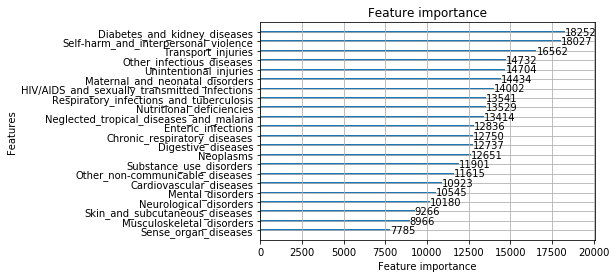

In [125]:
lgb.plot_importance(model)

# 4. How is this linked to the living conditions within each country?

## 4.1 Economics

Gather economical data and merge them to the dataset and continue exploration with this dataset (to find links).

To merge it with our dataframe we need to explode the years.

In this part, we will use the analysis from the other parts and link them with some socio-economic data to an extra dimension to the data. 

The measures used here : 
* GDP 
* Life expectancy 
* Kids mortality 
* % of GDP used in healthcare

Here, we will plot the different diseases from the other part and compare them with those measures. 

In [71]:
# GDP 
economic = pd.read_csv("data/gdp_capita.csv")
exploded = economic.melt(id_vars=economic.columns.to_list()[0: 4], 
        var_name="Year", 
        value_name="GDP").drop(["Indicator Name","Indicator Code" ], 1)
exploded['Year'] = pd.to_numeric(exploded['Year'],errors='coerce')
# Life expectancy 
life_expect = pd.read_csv("data/life_expect.csv")
life_expect_exploded = life_expect.melt(id_vars=life_expect.columns.to_list()[0: 4], 
        var_name="Year", 
        value_name="Life_expectancy").drop(["Indicator Name","Indicator Code" ], 1)
life_expect_exploded['Year'] = pd.to_numeric(life_expect_exploded['Year'],errors='coerce')
# Children mortality
mortality = pd.read_csv("data/child_mortality.csv")
mortality_exploded = mortality.melt(id_vars=mortality.columns.to_list()[0: 4], 
        var_name="Year", 
        value_name="Mortality").drop(["Indicator Name","Indicator Code" ], 1)
mortality_exploded['Year'] = pd.to_numeric(mortality_exploded['Year'],errors='coerce')
# Health expenditure
health_expend = pd.read_csv("data/health_expend.csv")
health_expend_exploded = health_expend.melt(id_vars=health_expend.columns.to_list()[0: 4], 
        var_name="Year", 
        value_name="Health expand").drop(["Indicator Name","Indicator Code" ], 1)
health_expend_exploded['Year'] = pd.to_numeric(health_expend_exploded['Year'],errors='coerce')

In [72]:
merged = pd.merge(percentData, exploded, how = "inner", left_on = ["alpha-3", "year"], right_on=["Country Code","Year"])
merged.drop(["alpha-3", "Country Name"], axis = 1, inplace = True)
merged = pd.merge(merged, life_expect_exploded, how = "inner", left_on = ["Country Code", "Year"], right_on=["Country Code","Year"])
merged.drop(["Country Name"], axis = 1, inplace = True)
merged = pd.merge(merged, mortality_exploded, how = "inner", left_on = ["Country Code", "Year"], right_on=["Country Code","Year"])
merged.drop([ "Country Name"], axis = 1, inplace = True)
merged["Mortality"] = merged["Mortality"]/1000
merged  = pd.merge(merged, health_expend_exploded, how = "inner", left_on = ["Country Code", "Year"], right_on=["Country Code","Year"])
merged.drop([ "Country Name"], axis = 1, inplace = True)
merged


,name,measure,year,alpha-2,country-code,iso_3166-2,region,sub-region,Cardiovascular diseases,Chronic respiratory diseases,...,Skin and subcutaneous diseases,Substance use disorders,Transport injuries,Unintentional injuries,Country Code,Year,GDP,Life_expectancy,Mortality,Health expand
0,Afghanistan,DALYs (Disability-Adjusted Life Years),1990.0,AF,4,ISO 3166-2:AF,Asia,Southern Asia,0.093929,0.016822,...,0.004122,0.004289,0.022361,0.035521,AFG,1990.0,NaN,50.331,0.1788,NaN
1,Afghanistan,Deaths,1990.0,AF,4,ISO 3166-2:AF,Asia,Southern Asia,0.237078,0.030362,...,0.000106,0.000784,0.024211,0.031597,AFG,1990.0,NaN,50.331,0.1788,NaN
2,Afghanistan,Incidence,1990.0,AF,4,ISO 3166-2:AF,Asia,Southern Asia,0.001385,0.002358,...,0.075134,0.000708,0.000906,0.007736,AFG,1990.0,NaN,50.331,0.1788,NaN
3,Afghanistan,Prevalence,1990.0,AF,4,ISO 3166-2:AF,Asia,Southern Asia,0.058095,0.096914,...,0.224220,0.016976,0.016913,0.089471,AFG,1990.0,NaN,50.331,0.1788,NaN
4,Afghanistan,YLDs (Years Lived with Disability),1990.0,AF,4,ISO 3166-2:AF,Asia,Southern Asia,0.026529,0.042681,...,0.035855,0.033828,0.008766,0.031593,AFG,1990.0,NaN,50.331,0.1788,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32251,Zimbabwe,Deaths,2017.0,ZW,716,ISO 3166-2:ZW,Africa,Sub-Saharan Africa,0.144307,0.029001,...,0.001277,0.002830,0.027084,0.031749,ZWE,2017.0,1602.403507,60.812,0.0493,NaN
32252,Zimbabwe,Incidence,2017.0,ZW,716,ISO 3166-2:ZW,Africa,Sub-Saharan Africa,0.000634,0.001270,...,0.103280,0.001301,0.001156,0.006622,ZWE,2017.0,1602.403507,60.812,0.0493,NaN
32253,Zimbabwe,Prevalence,2017.0,ZW,716,ISO 3166-2:ZW,Africa,Sub-Saharan Africa,0.035864,0.056056,...,0.299550,0.020565,0.017939,0.064665,ZWE,2017.0,1602.403507,60.812,0.0493,NaN
32254,Zimbabwe,YLDs (Years Lived with Disability),2017.0,ZW,716,ISO 3166-2:ZW,Africa,Sub-Saharan Africa,0.020713,0.061937,...,0.065611,0.037049,0.013121,0.032522,ZWE,2017.0,1602.403507,60.812,0.0493,NaN


In [73]:
merged.dropna(subset=['GDP', "Year", "Country Code"], axis = 0, inplace= True)
merged = merged.sort_values(["Year","name", ])
merged

,name,measure,year,alpha-2,country-code,iso_3166-2,region,sub-region,Cardiovascular diseases,Chronic respiratory diseases,...,Skin and subcutaneous diseases,Substance use disorders,Transport injuries,Unintentional injuries,Country Code,Year,GDP,Life_expectancy,Mortality,Health expand
168,Albania,DALYs (Disability-Adjusted Life Years),1990.0,AL,8,ISO 3166-2:AL,Europe,Southern Europe,0.144739,0.028149,...,0.015737,0.009377,0.030339,0.077250,ALB,1990.0,617.230436,71.836,0.0407,NaN
169,Albania,Deaths,1990.0,AL,8,ISO 3166-2:AL,Europe,Southern Europe,0.389480,0.049533,...,0.000451,0.000703,0.025738,0.034633,ALB,1990.0,617.230436,71.836,0.0407,NaN
170,Albania,Incidence,1990.0,AL,8,ISO 3166-2:AL,Europe,Southern Europe,0.001656,0.001554,...,0.095850,0.002000,0.002222,0.029902,ALB,1990.0,617.230436,71.836,0.0407,NaN
171,Albania,Prevalence,1990.0,AL,8,ISO 3166-2:AL,Europe,Southern Europe,0.062752,0.063366,...,0.213478,0.021349,0.027722,0.288731,ALB,1990.0,617.230436,71.836,0.0407,NaN
172,Albania,YLDs (Years Lived with Disability),1990.0,AL,8,ISO 3166-2:AL,Europe,Southern Europe,0.045190,0.036858,...,0.044852,0.026022,0.017019,0.118725,ALB,1990.0,617.230436,71.836,0.0407,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32251,Zimbabwe,Deaths,2017.0,ZW,716,ISO 3166-2:ZW,Africa,Sub-Saharan Africa,0.144307,0.029001,...,0.001277,0.002830,0.027084,0.031749,ZWE,2017.0,1602.403507,60.812,0.0493,NaN
32252,Zimbabwe,Incidence,2017.0,ZW,716,ISO 3166-2:ZW,Africa,Sub-Saharan Africa,0.000634,0.001270,...,0.103280,0.001301,0.001156,0.006622,ZWE,2017.0,1602.403507,60.812,0.0493,NaN
32253,Zimbabwe,Prevalence,2017.0,ZW,716,ISO 3166-2:ZW,Africa,Sub-Saharan Africa,0.035864,0.056056,...,0.299550,0.020565,0.017939,0.064665,ZWE,2017.0,1602.403507,60.812,0.0493,NaN
32254,Zimbabwe,YLDs (Years Lived with Disability),2017.0,ZW,716,ISO 3166-2:ZW,Africa,Sub-Saharan Africa,0.020713,0.061937,...,0.065611,0.037049,0.013121,0.032522,ZWE,2017.0,1602.403507,60.812,0.0493,NaN


In [74]:
merged2 = merged[merged["measure"]=="DALYs (Disability-Adjusted Life Years)"]

In [75]:
merged2.columns

Index(['name', 'measure', 'year', 'alpha-2', 'country-code', 'iso_3166-2',
       'region', 'sub-region', 'Cardiovascular diseases',
       'Chronic respiratory diseases', 'Diabetes and kidney diseases',
       'Digestive diseases', 'Enteric infections',
       'HIV/AIDS and sexually transmitted infections',
       'Maternal and neonatal disorders', 'Mental disorders',
       'Musculoskeletal disorders', 'Neglected tropical diseases and malaria',
       'Neoplasms', 'Neurological disorders', 'Nutritional deficiencies',
       'Other infectious diseases', 'Other non-communicable diseases',
       'Respiratory infections and tuberculosis',
       'Self-harm and interpersonal violence', 'Sense organ diseases',
       'Skin and subcutaneous diseases', 'Substance use disorders',
       'Transport injuries', 'Unintentional injuries', 'Country Code', 'Year',
       'GDP', 'Life_expectancy', 'Mortality', 'Health expand'],
      dtype='object')

In [76]:
colors = {'Northern Africa' : "#A3E4D7" ,
 'Sub-Saharan Africa' : "#138D75",
 'Latin America and the Caribbean' : "#5D6D7E",
 'Northern America' : "#85929E",
 'Western Asia' : "#F9E79F",
 'Central Asia' : "#F4D03F",
 'Southern Asia' : "#D4AC0D",
 'Eastern Asia' : "#7D6608",
 'South-eastern Asia' : "#F5B041",
 'Southern Europe' : "#7FB3D5" ,
 'Northern Europe' : "#2980B9",
 'Eastern Europe' : "#1A5276",
 'Western Europe' : "#3498DB",
 'Melanesia' : "#C0392B",
 'Australia and New Zealand' : "#922B21",
 'Micronesia' : "#E74C3C",
 'Polynesia' : "#F5B7B1"}

In [77]:
import plotly.express as px
px.scatter(merged2, x="Life_expectancy", y="Health expand", animation_frame="Year", animation_group="name",
           size="GDP",color="sub-region", hover_name="name", template= "plotly_white",color_discrete_map = colors,
           log_x=False, size_max=55)

Not super useful. 

In [78]:
merged2["sub-region"].unique()


['Southern Europe', 'Northern Africa', 'Sub-Saharan Africa',
       'Latin America and the Caribbean', 'Western Asia',
       'Australia and New Zealand', 'Western Europe', 'Southern Asia',
       'Eastern Europe', 'Northern America', 'South-eastern Asia',
       'Eastern Asia', 'Northern Europe', 'Melanesia', 'Central Asia',
       'Micronesia', 'Polynesia']

['Southern Europe',
 'Northern Africa',
 'Sub-Saharan Africa',
 'Latin America and the Caribbean',
 'Western Asia',
 'Australia and New Zealand',
 'Western Europe',
 'Southern Asia',
 'Eastern Europe',
 'Northern America',
 'South-eastern Asia',
 'Eastern Asia',
 'Northern Europe',
 'Melanesia',
 'Central Asia',
 'Micronesia',
 'Polynesia']

In the previous part, when we ranked the causes, we got : 

* Cardiovascular diseases                  3.641945e+08
* Neoplasms                                2.323061e+08
* Maternal and neonatal disorders          1.972729e+08
* Respiratory infections and tuberculosis  1.596848e+08
* Musculoskeletal disorders                1.382135e+08

Lets plot thoses causes of death with life expectancy, GDP and regions. 

In [79]:
import plotly.express as px
px.scatter(merged2, x="Maternal and neonatal disorders", y="Life_expectancy", animation_frame="Year", animation_group="name",
           size="GDP",color="sub-region", hover_name="name", template= "plotly_white",color_discrete_map = colors,
           log_x=False, size_max=55)

In [ ]:
import plotly.express as px
px.scatter(merged2, x="Cardiovascular diseases", y="Life_expectancy", animation_frame="Year", animation_group="name",
           size="GDP",color="sub-region", hover_name="name", template= "plotly_white", color_discrete_map = colors,
           log_x=False, size_max=55)

In [ ]:
import plotly.express as px
px.scatter(merged2, x="Neoplasms", y="Life_expectancy", animation_frame="Year", animation_group="name",
           size="GDP",color="sub-region", hover_name="name", template= "plotly_white" ,color_discrete_map = colors,
           log_x=False, size_max=55)

In [ ]:
import plotly.express as px
px.scatter(merged2, x="Respiratory infections and tuberculosis", y="Life_expectancy", animation_frame="Year", animation_group="name",
           size="GDP",color="sub-region", hover_name="name", template= "plotly_white",color_discrete_map = colors,
           log_x=False, size_max=55)

In [83]:
import plotly.express as px
px.scatter(merged2, x="Musculoskeletal disorders", y="Life_expectancy", animation_frame="Year", animation_group="name",
           size="GDP",color="sub-region", hover_name="name", template= "plotly_white",color_discrete_map = colors,
           log_x=False, size_max=55)